<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Scratch_5_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/MyDrive/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(5):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_IoU',
    verbose=1,
    mode = 'max',
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 33.8273 - IoU: 0.0625
Epoch 1: val_IoU improved from -inf to 0.00001, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 23ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


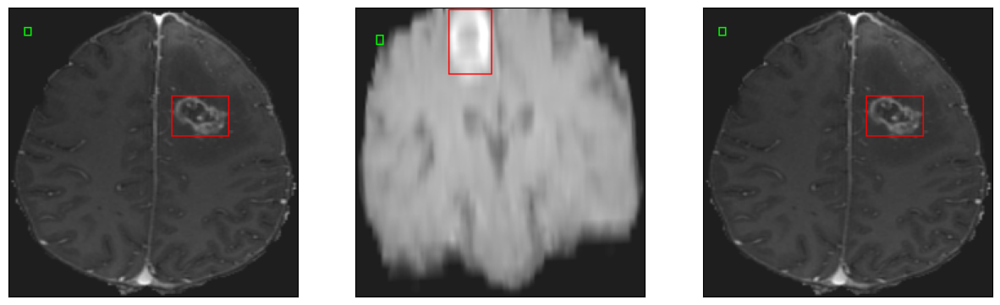

26/26 [==============================] - 21s 182ms/step - loss: 33.8273 - IoU: 0.0625 - val_loss: 57.5568 - val_IoU: 1.3087e-05
Epoch 2/200
25/26 [===========================>..] - ETA: 0s - loss: 22.0121 - IoU: 0.1332
Epoch 2: val_IoU improved from 0.00001 to 0.00216, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


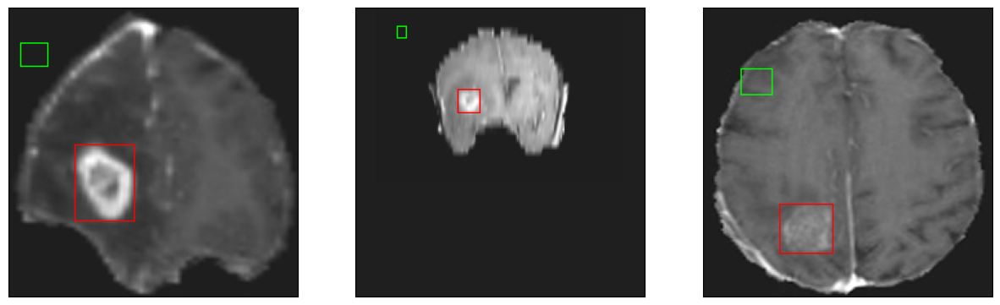

26/26 [==============================] - 3s 131ms/step - loss: 21.9188 - IoU: 0.1353 - val_loss: 43.5331 - val_IoU: 0.0022
Epoch 3/200
25/26 [===========================>..] - ETA: 0s - loss: 17.6990 - IoU: 0.2110
Epoch 3: val_IoU improved from 0.00216 to 0.02149, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


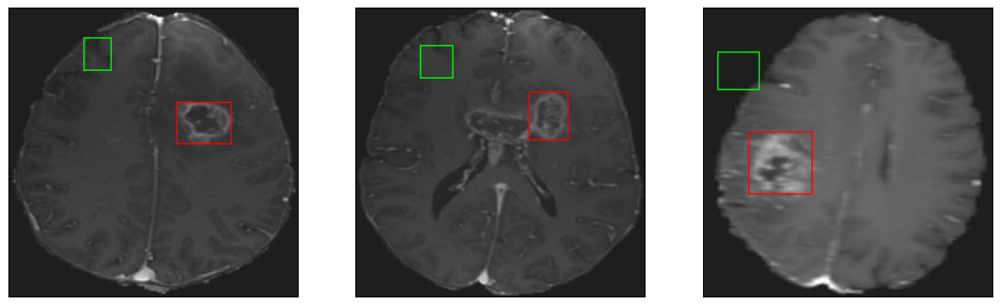

26/26 [==============================] - 3s 111ms/step - loss: 17.6485 - IoU: 0.2128 - val_loss: 33.5752 - val_IoU: 0.0215
Epoch 4/200
25/26 [===========================>..] - ETA: 0s - loss: 15.4569 - IoU: 0.2614
Epoch 4: val_IoU did not improve from 0.02149
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


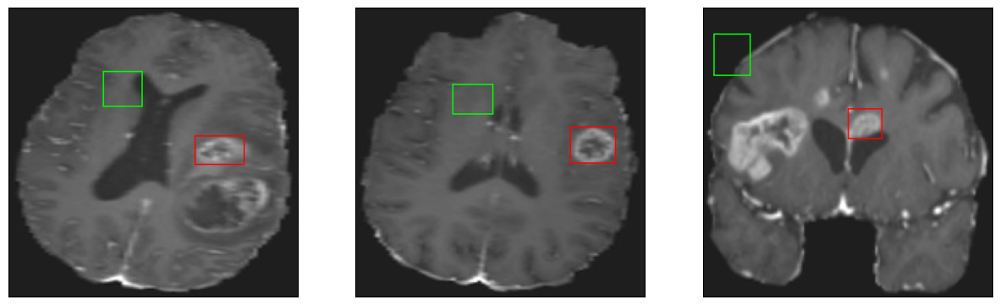

26/26 [==============================] - 2s 84ms/step - loss: 15.4274 - IoU: 0.2611 - val_loss: 36.7803 - val_IoU: 0.0034
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 14.3333 - IoU: 0.2866
Epoch 5: val_IoU did not improve from 0.02149
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


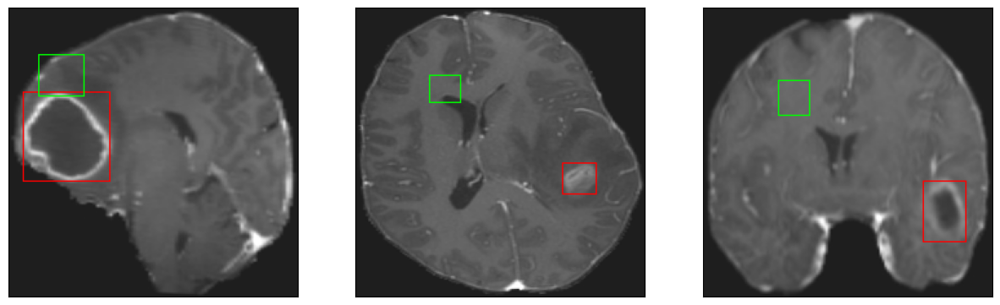

26/26 [==============================] - 2s 87ms/step - loss: 14.3333 - IoU: 0.2866 - val_loss: 37.0681 - val_IoU: 0.0040
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 13.4189 - IoU: 0.3162
Epoch 6: val_IoU improved from 0.02149 to 0.07217, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


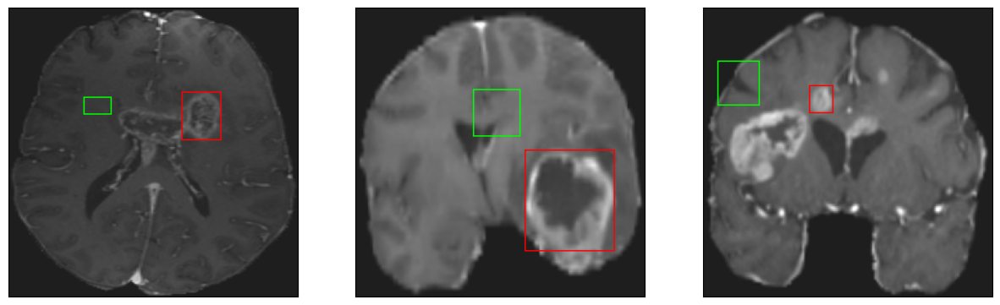

26/26 [==============================] - 2s 88ms/step - loss: 13.4189 - IoU: 0.3162 - val_loss: 25.8882 - val_IoU: 0.0722
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 12.7588 - IoU: 0.3243
Epoch 7: val_IoU improved from 0.07217 to 0.09372, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


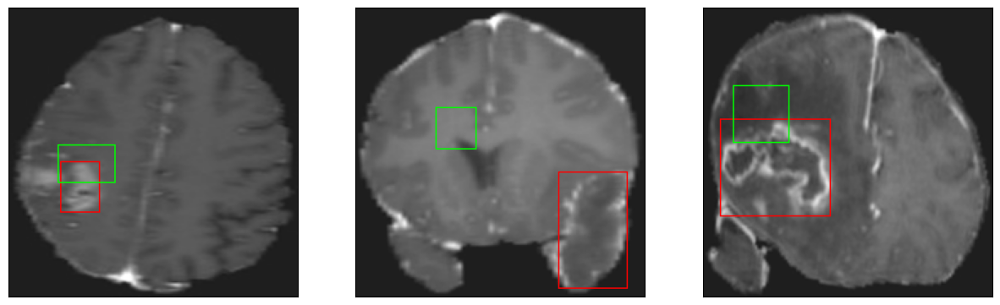

26/26 [==============================] - 3s 109ms/step - loss: 12.7588 - IoU: 0.3243 - val_loss: 23.8219 - val_IoU: 0.0937
Epoch 8/200
25/26 [===========================>..] - ETA: 0s - loss: 12.2744 - IoU: 0.3439
Epoch 8: val_IoU did not improve from 0.09372
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


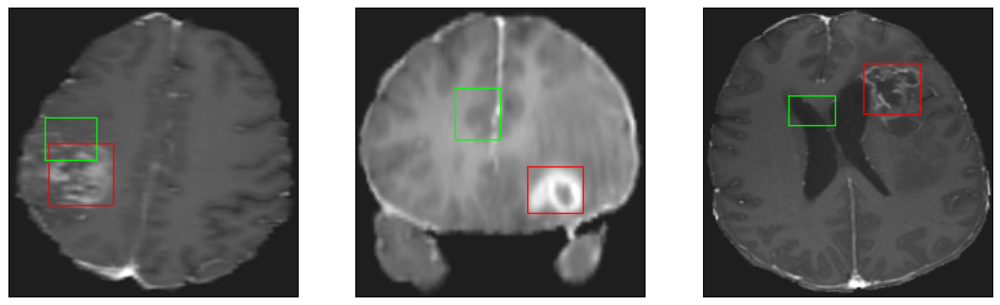

26/26 [==============================] - 3s 99ms/step - loss: 12.2443 - IoU: 0.3442 - val_loss: 25.9646 - val_IoU: 0.0473
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 11.3603 - IoU: 0.3646
Epoch 9: val_IoU did not improve from 0.09372
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


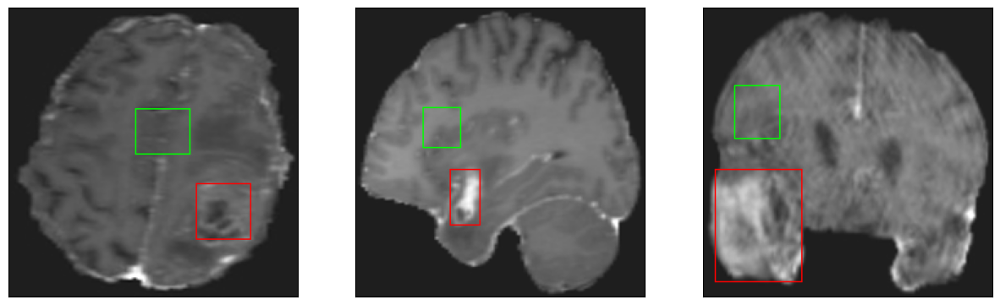

26/26 [==============================] - 2s 88ms/step - loss: 11.3603 - IoU: 0.3646 - val_loss: 22.9670 - val_IoU: 0.0835
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 10.7257 - IoU: 0.3892
Epoch 10: val_IoU improved from 0.09372 to 0.13271, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


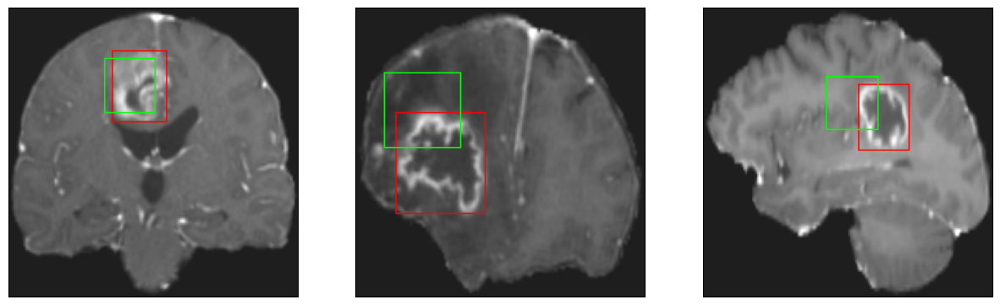

26/26 [==============================] - 2s 96ms/step - loss: 10.7257 - IoU: 0.3892 - val_loss: 19.7899 - val_IoU: 0.1327
Epoch 11/200
25/26 [===========================>..] - ETA: 0s - loss: 10.3742 - IoU: 0.3915
Epoch 11: val_IoU improved from 0.13271 to 0.13375, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


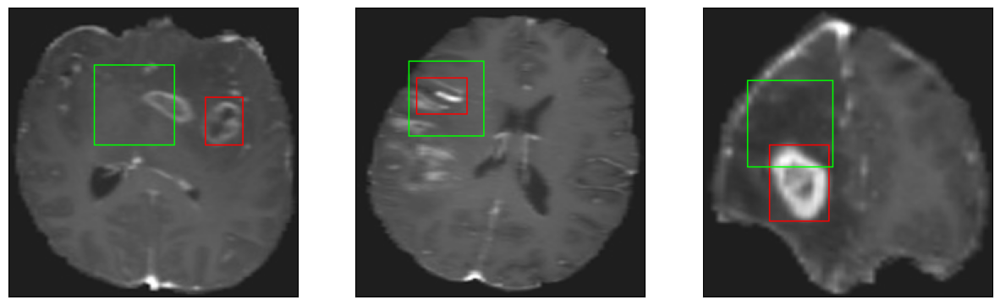

26/26 [==============================] - 3s 101ms/step - loss: 10.3594 - IoU: 0.3903 - val_loss: 22.6658 - val_IoU: 0.1337
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 9.9825 - IoU: 0.4174 
Epoch 12: val_IoU improved from 0.13375 to 0.28848, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


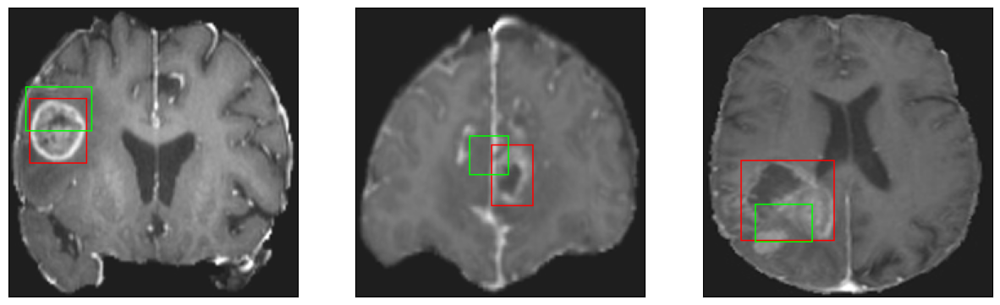

26/26 [==============================] - 3s 114ms/step - loss: 9.9825 - IoU: 0.4174 - val_loss: 13.8371 - val_IoU: 0.2885
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 10.2239 - IoU: 0.3958
Epoch 13: val_IoU improved from 0.28848 to 0.32487, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


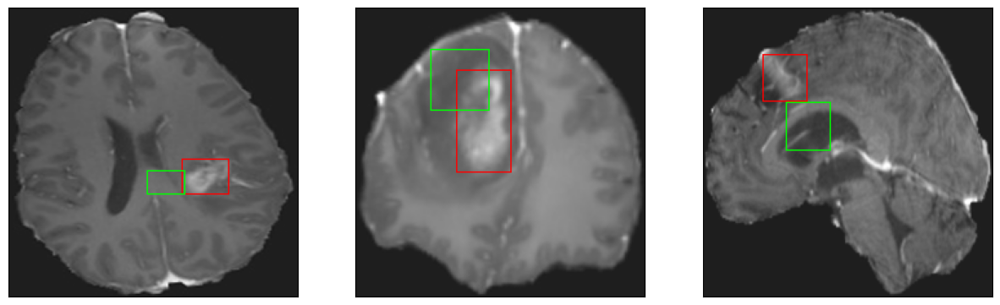

26/26 [==============================] - 2s 94ms/step - loss: 10.2239 - IoU: 0.3958 - val_loss: 12.9583 - val_IoU: 0.3249
Epoch 14/200
25/26 [===========================>..] - ETA: 0s - loss: 9.4973 - IoU: 0.4250
Epoch 14: val_IoU did not improve from 0.32487
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


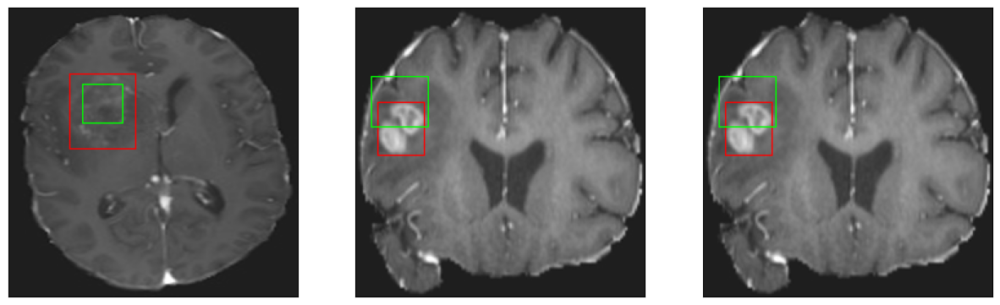

26/26 [==============================] - 2s 88ms/step - loss: 9.5141 - IoU: 0.4228 - val_loss: 21.1579 - val_IoU: 0.1383
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 9.4760 - IoU: 0.4230
Epoch 15: val_IoU improved from 0.32487 to 0.35021, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


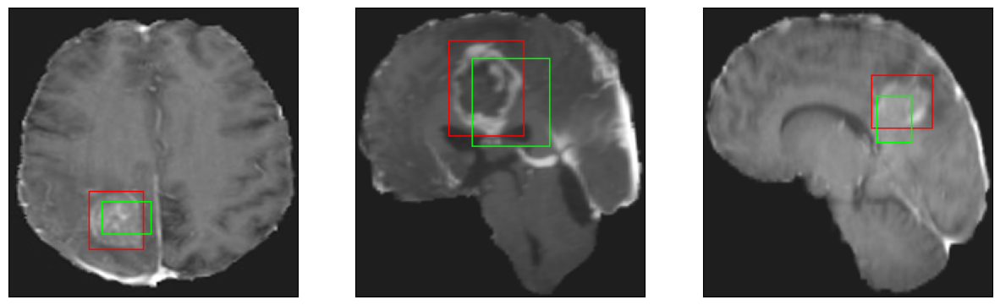

26/26 [==============================] - 2s 95ms/step - loss: 9.4760 - IoU: 0.4230 - val_loss: 11.7235 - val_IoU: 0.3502
Epoch 16/200
25/26 [===========================>..] - ETA: 0s - loss: 9.1339 - IoU: 0.4302
Epoch 16: val_IoU did not improve from 0.35021
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


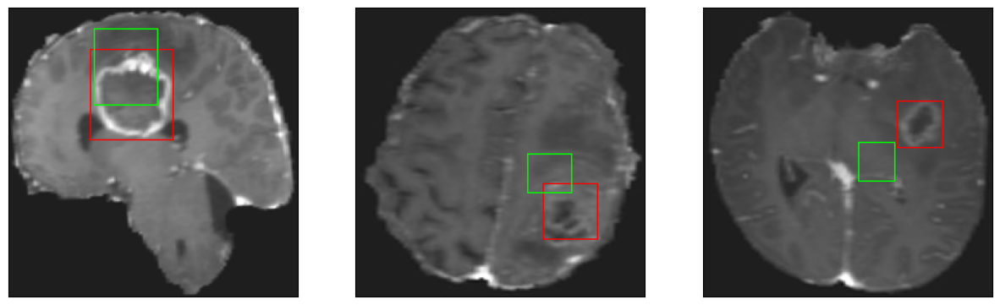

26/26 [==============================] - 3s 111ms/step - loss: 9.1928 - IoU: 0.4271 - val_loss: 13.0141 - val_IoU: 0.3160
Epoch 17/200
25/26 [===========================>..] - ETA: 0s - loss: 8.8289 - IoU: 0.4426
Epoch 17: val_IoU improved from 0.35021 to 0.37141, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


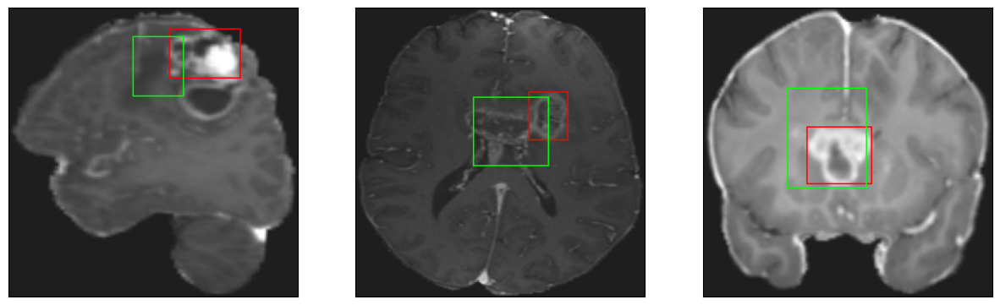

26/26 [==============================] - 3s 124ms/step - loss: 8.8116 - IoU: 0.4425 - val_loss: 14.0418 - val_IoU: 0.3714
Epoch 18/200
25/26 [===========================>..] - ETA: 0s - loss: 8.6181 - IoU: 0.4540
Epoch 18: val_IoU did not improve from 0.37141
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


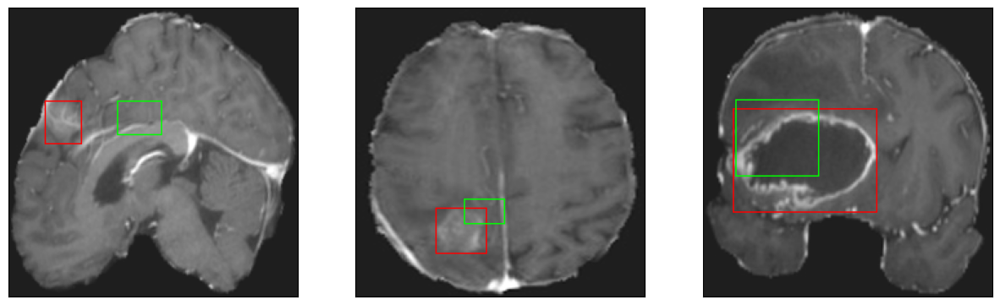

26/26 [==============================] - 2s 92ms/step - loss: 8.6597 - IoU: 0.4510 - val_loss: 13.1583 - val_IoU: 0.3123
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 8.5490 - IoU: 0.4515
Epoch 19: val_IoU improved from 0.37141 to 0.39771, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


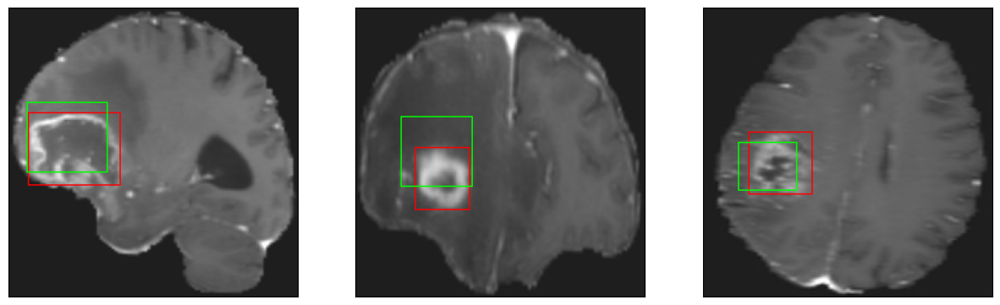

26/26 [==============================] - 3s 100ms/step - loss: 8.5490 - IoU: 0.4515 - val_loss: 10.9351 - val_IoU: 0.3977
Epoch 20/200
25/26 [===========================>..] - ETA: 0s - loss: 8.3511 - IoU: 0.4591
Epoch 20: val_IoU improved from 0.39771 to 0.40748, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


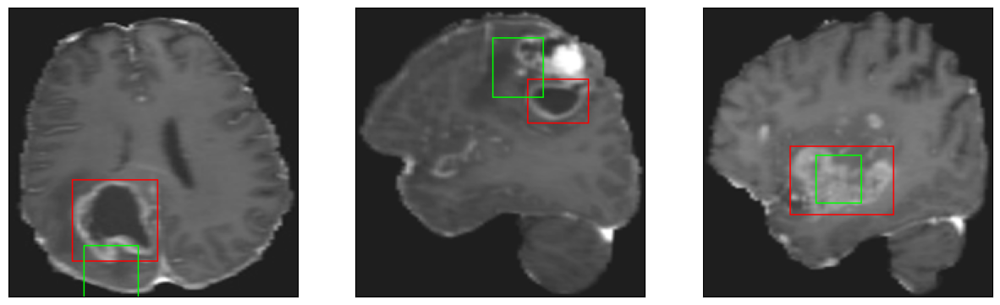

26/26 [==============================] - 3s 108ms/step - loss: 8.3245 - IoU: 0.4609 - val_loss: 10.6178 - val_IoU: 0.4075
Epoch 21/200
25/26 [===========================>..] - ETA: 0s - loss: 7.7870 - IoU: 0.4846
Epoch 21: val_IoU improved from 0.40748 to 0.42707, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


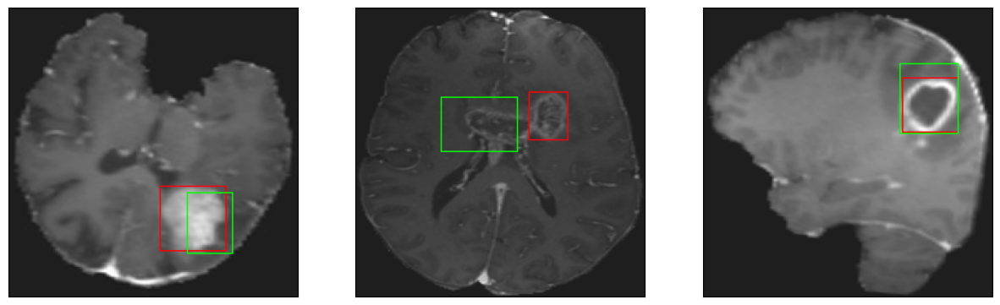

26/26 [==============================] - 3s 106ms/step - loss: 7.7833 - IoU: 0.4845 - val_loss: 10.2634 - val_IoU: 0.4271
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 7.7643 - IoU: 0.4900
Epoch 22: val_IoU did not improve from 0.42707
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


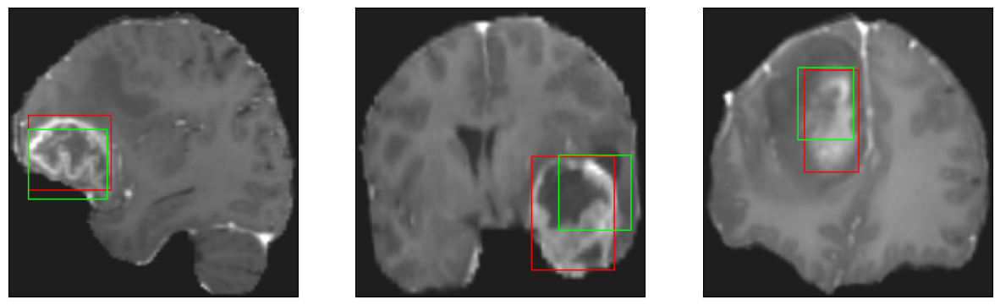

26/26 [==============================] - 2s 94ms/step - loss: 7.7643 - IoU: 0.4900 - val_loss: 10.7086 - val_IoU: 0.3860
Epoch 23/200
25/26 [===========================>..] - ETA: 0s - loss: 7.5341 - IoU: 0.4898
Epoch 23: val_IoU did not improve from 0.42707
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


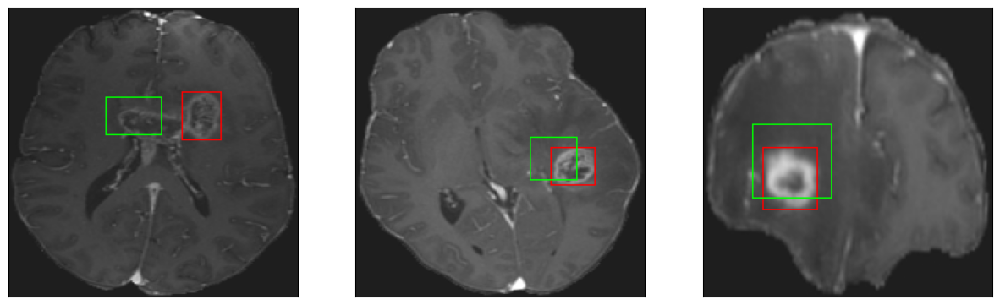

26/26 [==============================] - 2s 90ms/step - loss: 7.5350 - IoU: 0.4881 - val_loss: 11.7243 - val_IoU: 0.3470
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 7.5836 - IoU: 0.4878
Epoch 24: val_IoU did not improve from 0.42707
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


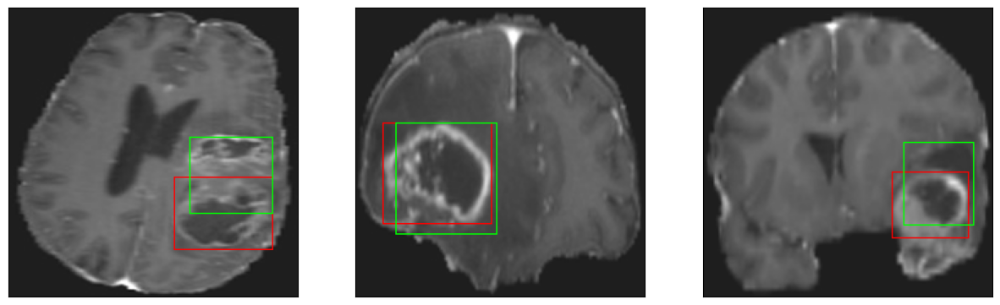

26/26 [==============================] - 3s 126ms/step - loss: 7.5836 - IoU: 0.4878 - val_loss: 11.4679 - val_IoU: 0.3899
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 7.8732 - IoU: 0.4765
Epoch 25: val_IoU did not improve from 0.42707
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


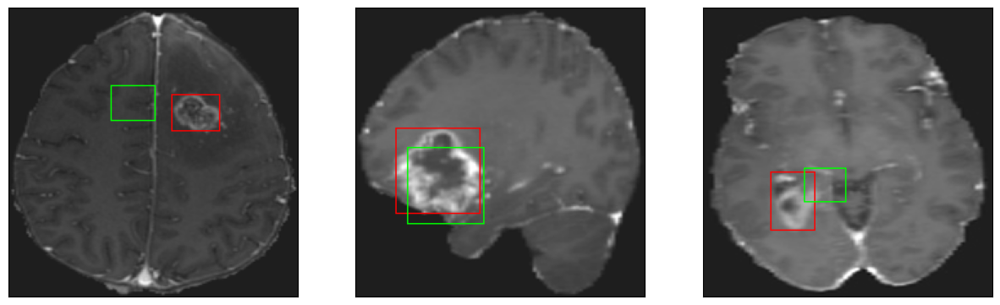

26/26 [==============================] - 3s 108ms/step - loss: 7.8732 - IoU: 0.4765 - val_loss: 10.0639 - val_IoU: 0.4216
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 7.3391 - IoU: 0.4946
Epoch 26: val_IoU improved from 0.42707 to 0.43847, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4


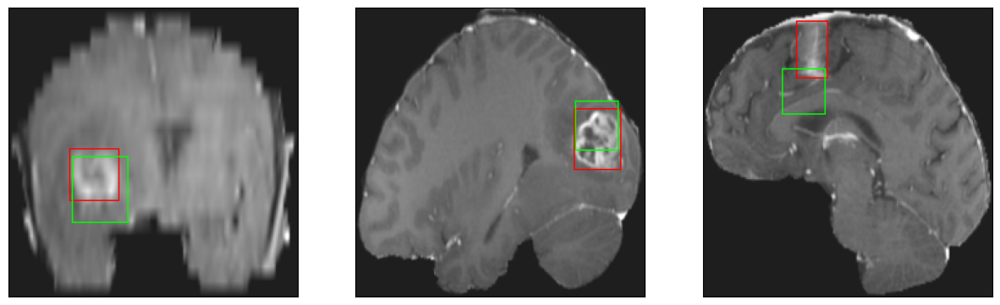

26/26 [==============================] - 3s 113ms/step - loss: 7.3391 - IoU: 0.4946 - val_loss: 9.6287 - val_IoU: 0.4385
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 7.4996 - IoU: 0.4983
Epoch 27: val_IoU did not improve from 0.43847
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 11ms/step
4


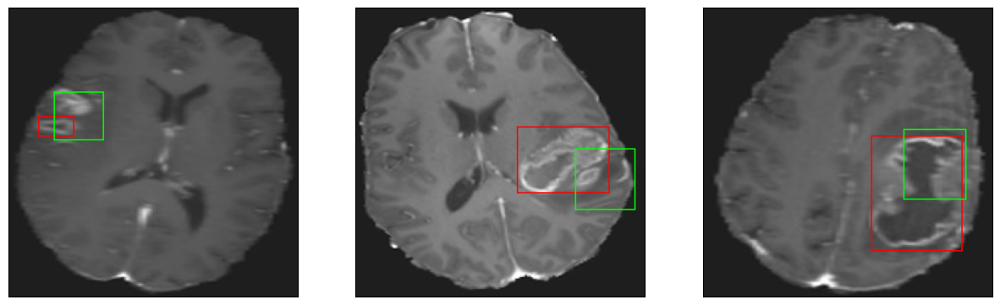

26/26 [==============================] - 3s 118ms/step - loss: 7.4996 - IoU: 0.4983 - val_loss: 11.1953 - val_IoU: 0.4012
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 7.3925 - IoU: 0.5051
Epoch 28: val_IoU did not improve from 0.43847
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


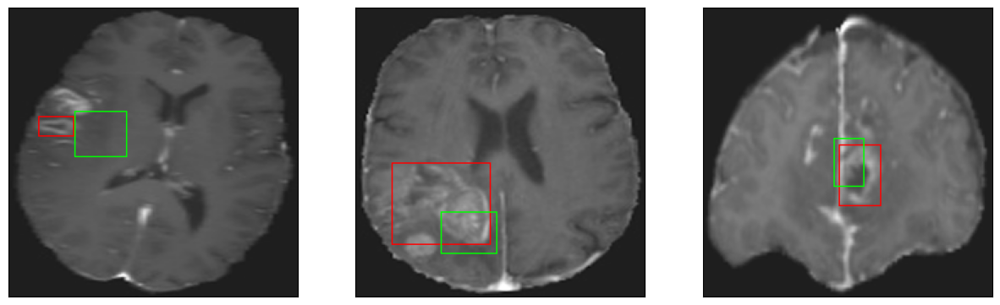

26/26 [==============================] - 3s 110ms/step - loss: 7.3925 - IoU: 0.5051 - val_loss: 10.7884 - val_IoU: 0.3848
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 6.9321 - IoU: 0.5207
Epoch 29: val_IoU did not improve from 0.43847
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


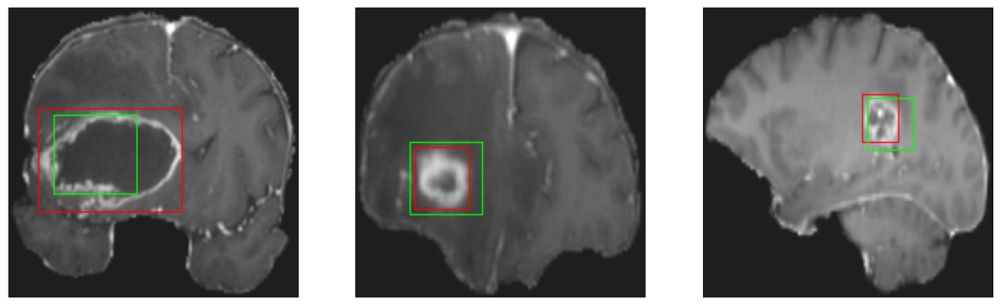

26/26 [==============================] - 3s 108ms/step - loss: 6.9321 - IoU: 0.5207 - val_loss: 12.3331 - val_IoU: 0.3200
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 6.8749 - IoU: 0.5223
Epoch 30: val_IoU improved from 0.43847 to 0.47422, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


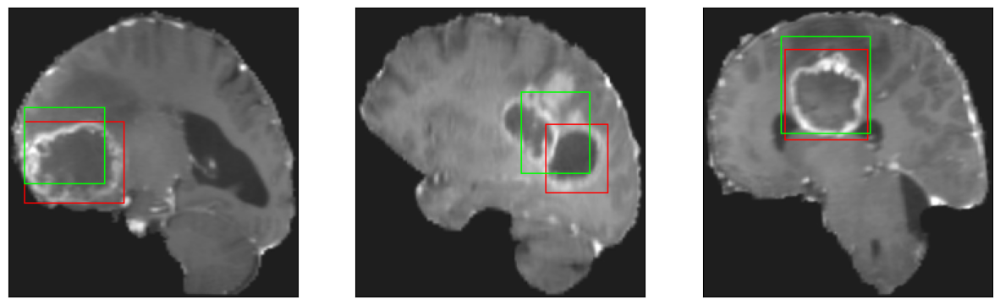

26/26 [==============================] - 4s 138ms/step - loss: 6.8749 - IoU: 0.5223 - val_loss: 8.9742 - val_IoU: 0.4742
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 6.8932 - IoU: 0.5159
Epoch 31: val_IoU did not improve from 0.47422
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


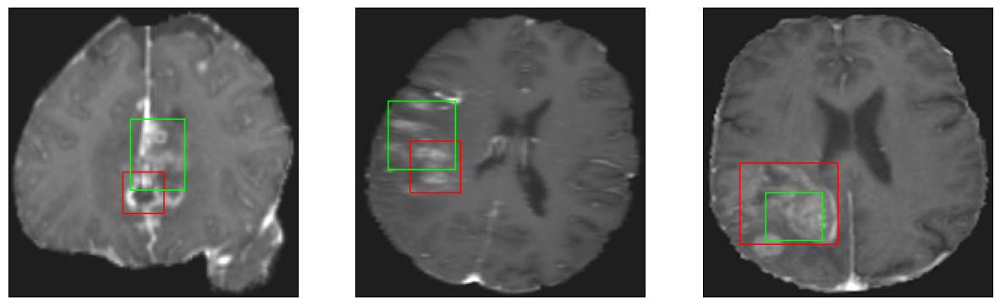

26/26 [==============================] - 3s 122ms/step - loss: 6.8932 - IoU: 0.5159 - val_loss: 9.7537 - val_IoU: 0.4572
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 6.6531 - IoU: 0.5309
Epoch 32: val_IoU improved from 0.47422 to 0.47680, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


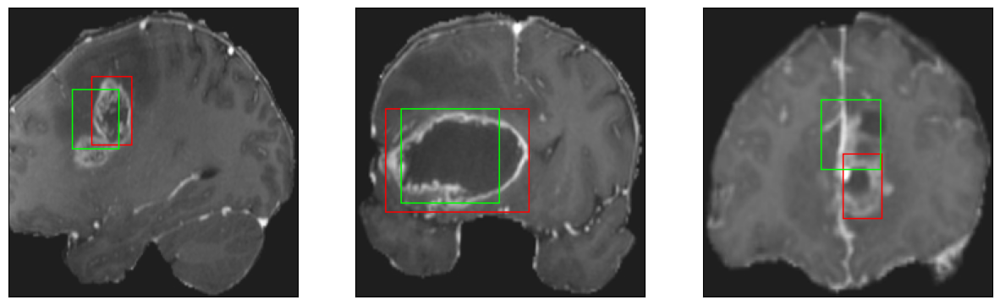

26/26 [==============================] - 3s 115ms/step - loss: 6.6531 - IoU: 0.5309 - val_loss: 9.2267 - val_IoU: 0.4768
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 6.6761 - IoU: 0.5280
Epoch 33: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


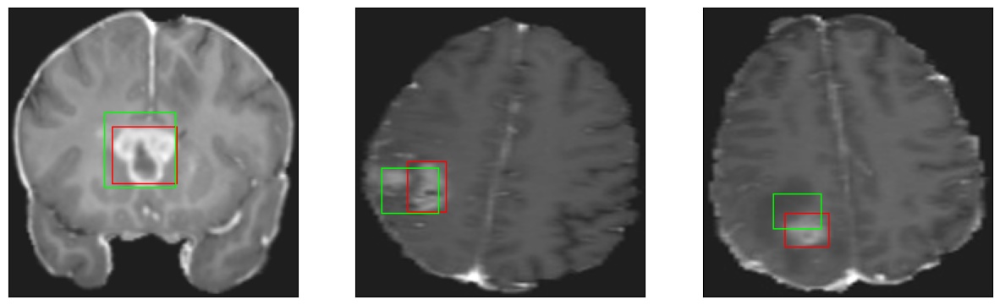

26/26 [==============================] - 3s 98ms/step - loss: 6.6761 - IoU: 0.5280 - val_loss: 9.7711 - val_IoU: 0.4474
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 6.6331 - IoU: 0.5287
Epoch 34: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


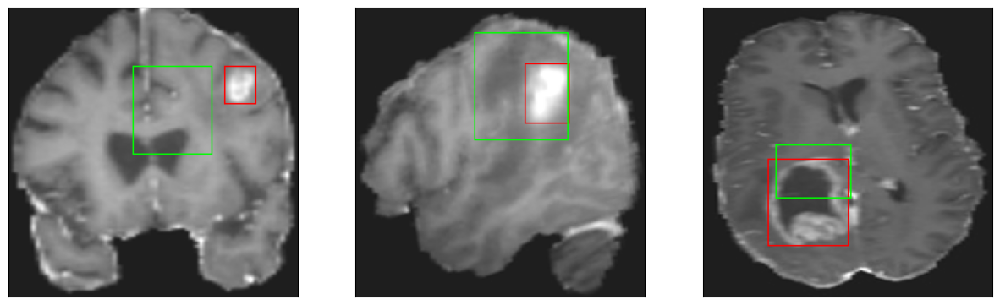

26/26 [==============================] - 3s 120ms/step - loss: 6.6331 - IoU: 0.5287 - val_loss: 14.4427 - val_IoU: 0.3275
Epoch 35/200
25/26 [===========================>..] - ETA: 0s - loss: 6.5929 - IoU: 0.5378
Epoch 35: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


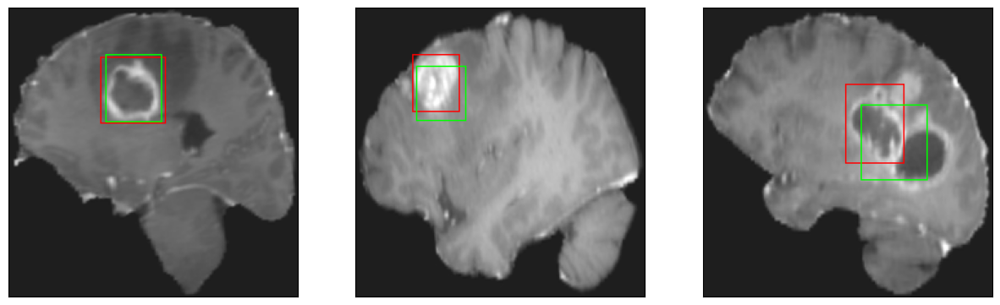

26/26 [==============================] - 2s 90ms/step - loss: 6.6486 - IoU: 0.5357 - val_loss: 10.9915 - val_IoU: 0.3985
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 6.4889 - IoU: 0.5440
Epoch 36: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


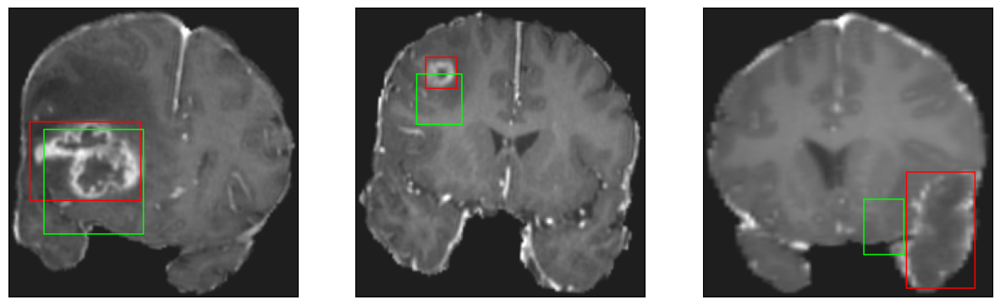

26/26 [==============================] - 2s 92ms/step - loss: 6.4889 - IoU: 0.5440 - val_loss: 10.8017 - val_IoU: 0.4065
Epoch 37/200
25/26 [===========================>..] - ETA: 0s - loss: 6.8057 - IoU: 0.5227
Epoch 37: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


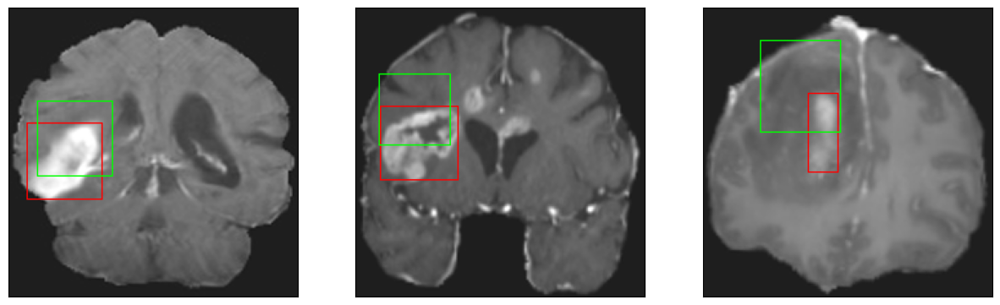

26/26 [==============================] - 2s 95ms/step - loss: 6.7689 - IoU: 0.5234 - val_loss: 18.2252 - val_IoU: 0.2249
Epoch 38/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3582 - IoU: 0.5366
Epoch 38: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


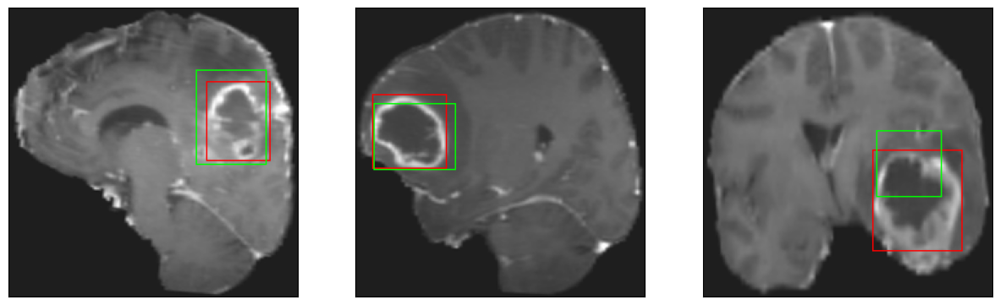

26/26 [==============================] - 3s 102ms/step - loss: 6.3538 - IoU: 0.5362 - val_loss: 9.2685 - val_IoU: 0.4597
Epoch 39/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2903 - IoU: 0.5531
Epoch 39: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


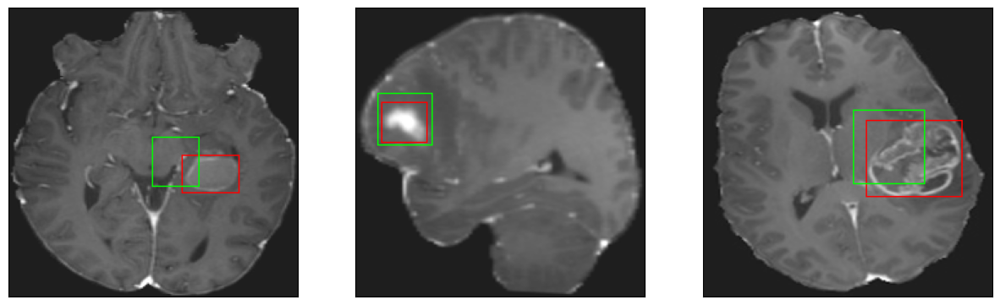

26/26 [==============================] - 2s 93ms/step - loss: 6.2847 - IoU: 0.5517 - val_loss: 11.3795 - val_IoU: 0.4131
Epoch 40/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3857 - IoU: 0.5420
Epoch 40: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


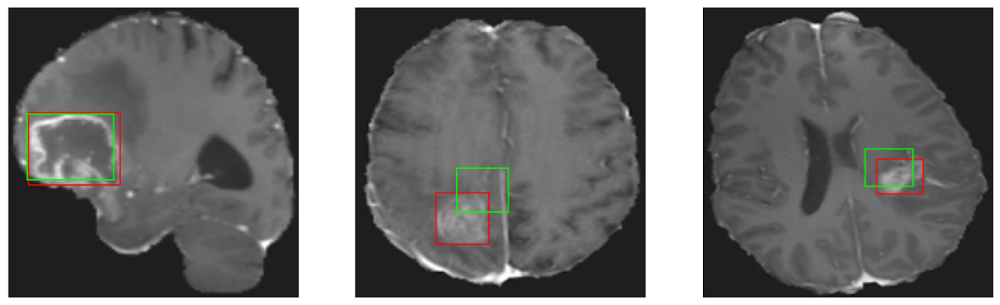

26/26 [==============================] - 2s 96ms/step - loss: 6.3963 - IoU: 0.5419 - val_loss: 13.0527 - val_IoU: 0.3264
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 6.1209 - IoU: 0.5597
Epoch 41: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


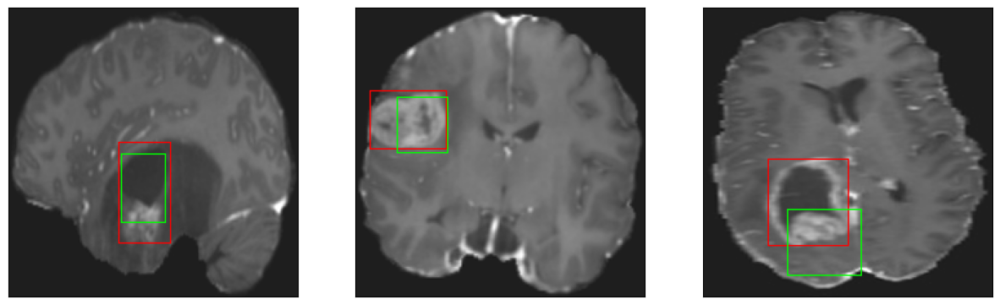

26/26 [==============================] - 3s 127ms/step - loss: 6.1209 - IoU: 0.5597 - val_loss: 10.3919 - val_IoU: 0.4199
Epoch 42/200
25/26 [===========================>..] - ETA: 0s - loss: 6.2218 - IoU: 0.5585
Epoch 42: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


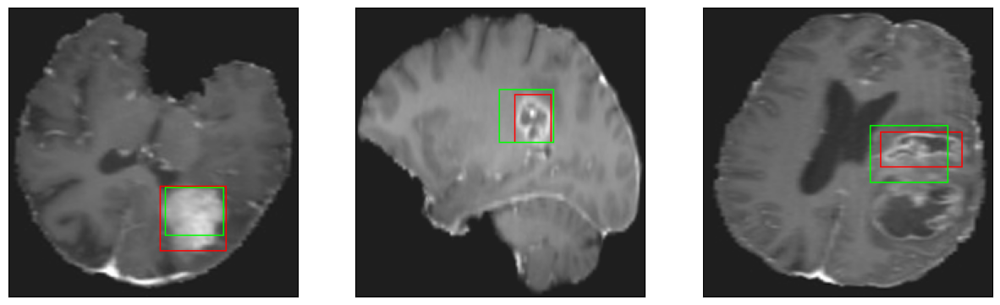

26/26 [==============================] - 3s 102ms/step - loss: 6.2223 - IoU: 0.5568 - val_loss: 11.0941 - val_IoU: 0.4000
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 6.1177 - IoU: 0.5545
Epoch 43: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


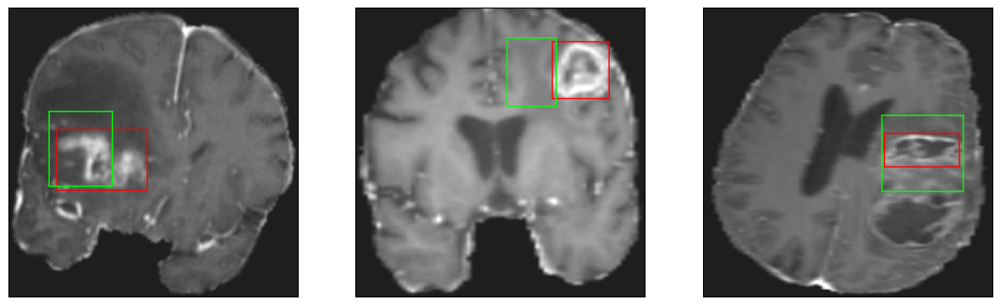

26/26 [==============================] - 3s 130ms/step - loss: 6.1177 - IoU: 0.5545 - val_loss: 10.6802 - val_IoU: 0.4210
Epoch 44/200
25/26 [===========================>..] - ETA: 0s - loss: 6.3205 - IoU: 0.5474
Epoch 44: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


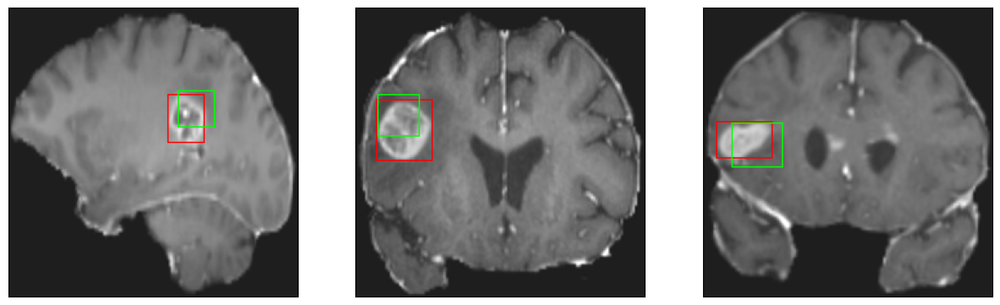

26/26 [==============================] - 3s 99ms/step - loss: 6.2943 - IoU: 0.5492 - val_loss: 10.1869 - val_IoU: 0.4243
Epoch 45/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1272 - IoU: 0.5624
Epoch 45: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


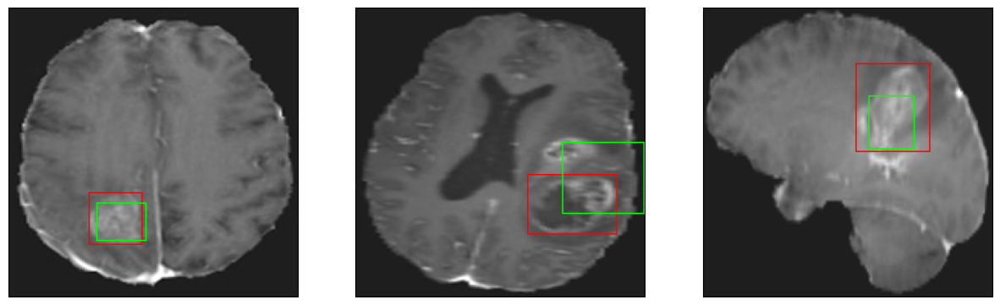

26/26 [==============================] - 3s 101ms/step - loss: 6.1111 - IoU: 0.5644 - val_loss: 9.7686 - val_IoU: 0.4243
Epoch 46/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9770 - IoU: 0.5664
Epoch 46: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


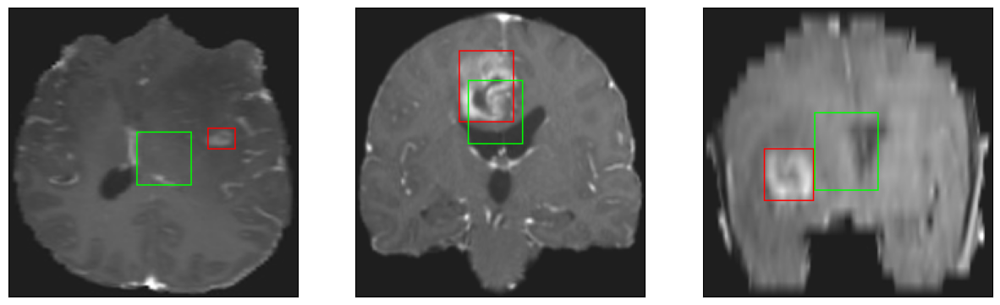

26/26 [==============================] - 2s 90ms/step - loss: 5.9854 - IoU: 0.5665 - val_loss: 13.2218 - val_IoU: 0.3406
Epoch 47/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0334 - IoU: 0.5599
Epoch 47: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


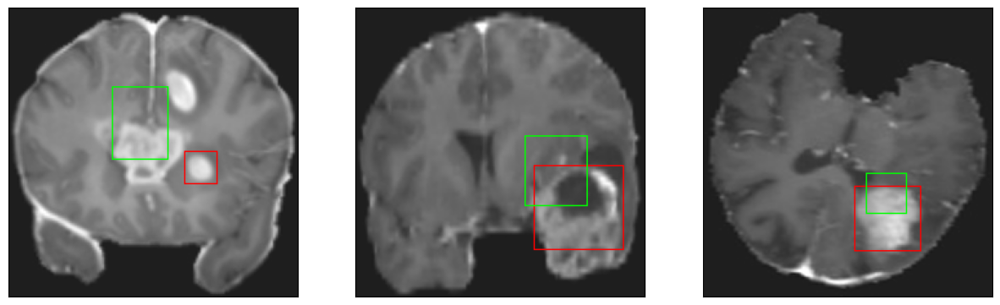

26/26 [==============================] - 2s 96ms/step - loss: 6.0464 - IoU: 0.5596 - val_loss: 10.0644 - val_IoU: 0.4293
Epoch 48/200
25/26 [===========================>..] - ETA: 0s - loss: 6.6043 - IoU: 0.5336
Epoch 48: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


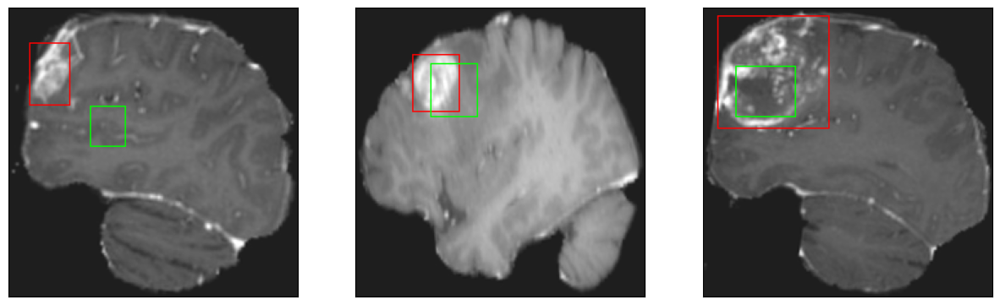

26/26 [==============================] - 3s 109ms/step - loss: 6.6030 - IoU: 0.5328 - val_loss: 9.1303 - val_IoU: 0.4553
Epoch 49/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0082 - IoU: 0.5633
Epoch 49: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


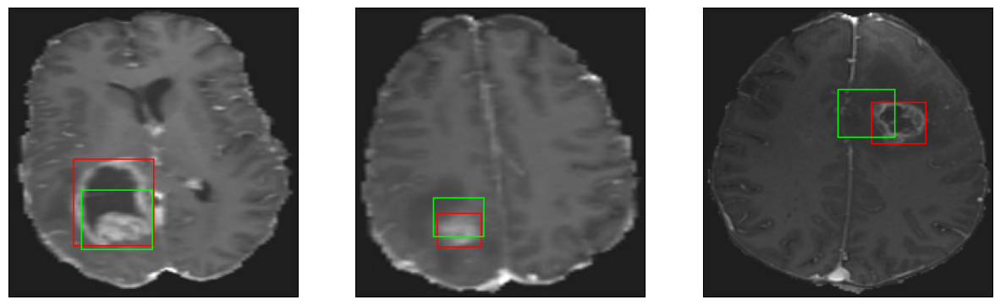

26/26 [==============================] - 3s 102ms/step - loss: 5.9596 - IoU: 0.5659 - val_loss: 10.5684 - val_IoU: 0.4091
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 6.1028 - IoU: 0.5603
Epoch 50: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


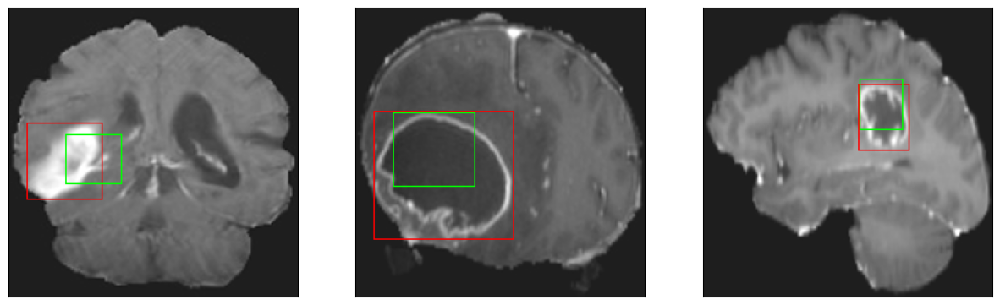

26/26 [==============================] - 3s 101ms/step - loss: 6.1028 - IoU: 0.5603 - val_loss: 11.1932 - val_IoU: 0.3921
Epoch 51/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9583 - IoU: 0.5711
Epoch 51: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


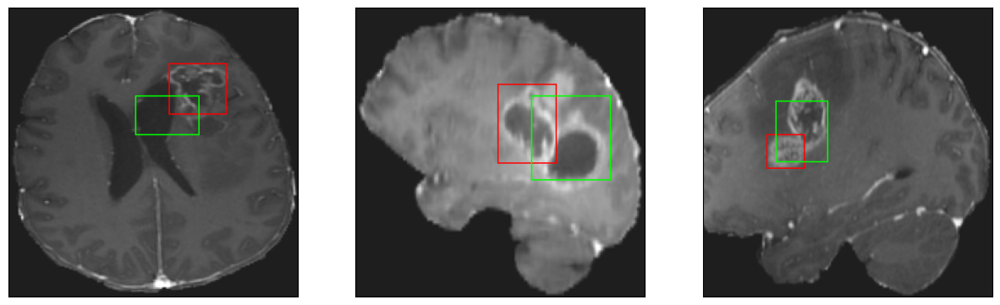

26/26 [==============================] - 3s 121ms/step - loss: 5.9609 - IoU: 0.5698 - val_loss: 9.7839 - val_IoU: 0.4508
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 5.7861 - IoU: 0.5733
Epoch 52: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


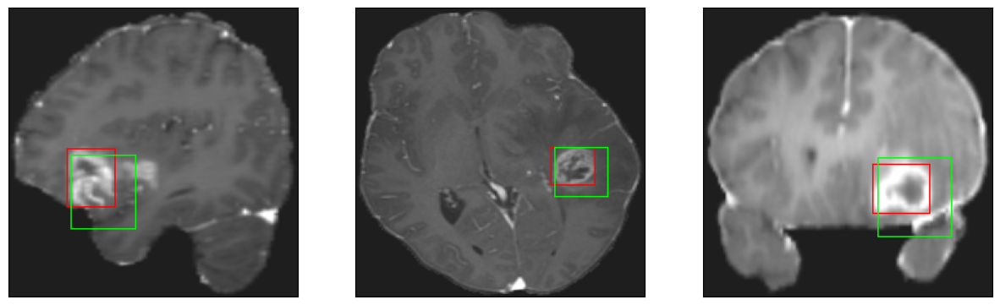

26/26 [==============================] - 3s 110ms/step - loss: 5.7861 - IoU: 0.5733 - val_loss: 9.4862 - val_IoU: 0.4531
Epoch 53/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8755 - IoU: 0.5721
Epoch 53: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


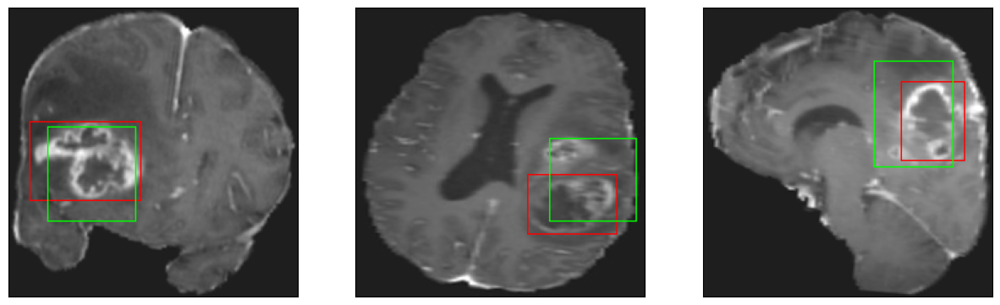

26/26 [==============================] - 3s 103ms/step - loss: 5.8995 - IoU: 0.5698 - val_loss: 10.2481 - val_IoU: 0.4405
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 5.7251 - IoU: 0.5771
Epoch 54: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


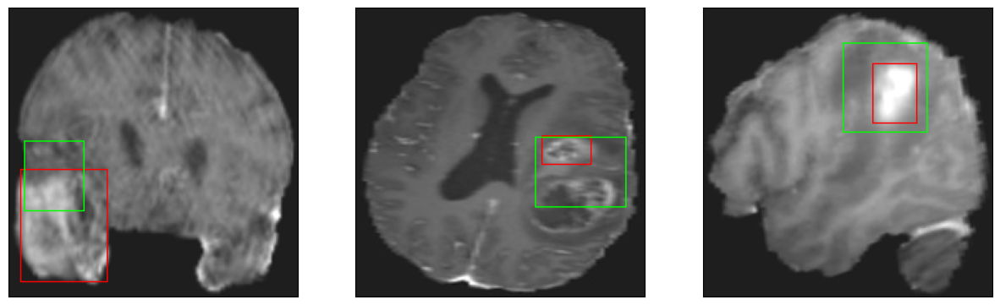

26/26 [==============================] - 3s 98ms/step - loss: 5.7251 - IoU: 0.5771 - val_loss: 10.4713 - val_IoU: 0.4516
Epoch 55/200
25/26 [===========================>..] - ETA: 0s - loss: 6.0302 - IoU: 0.5598
Epoch 55: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


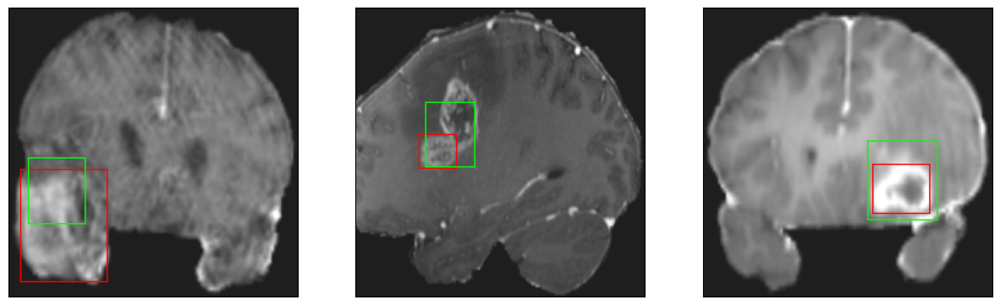

26/26 [==============================] - 3s 111ms/step - loss: 6.0410 - IoU: 0.5606 - val_loss: 9.1373 - val_IoU: 0.4654
Epoch 56/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1268 - IoU: 0.5547
Epoch 56: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


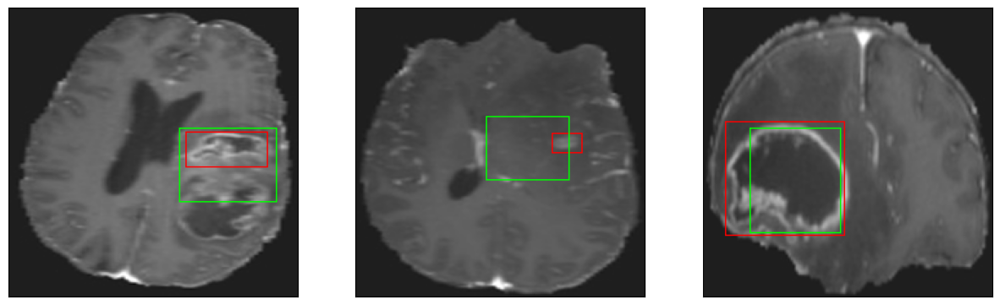

26/26 [==============================] - 3s 114ms/step - loss: 6.1008 - IoU: 0.5556 - val_loss: 9.9777 - val_IoU: 0.4612
Epoch 57/200
25/26 [===========================>..] - ETA: 0s - loss: 5.9344 - IoU: 0.5615
Epoch 57: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


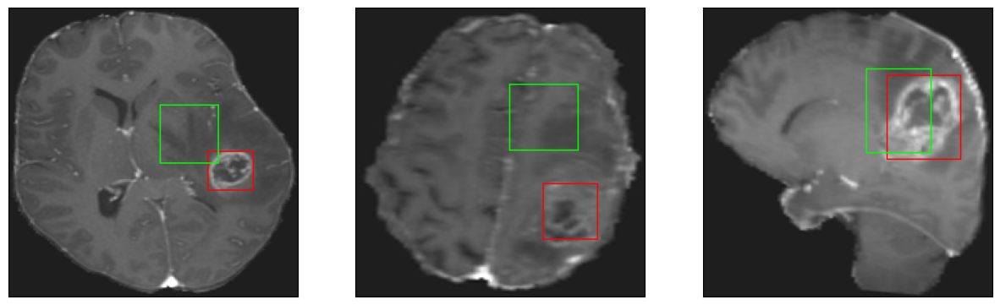

26/26 [==============================] - 3s 102ms/step - loss: 5.9680 - IoU: 0.5598 - val_loss: 13.9897 - val_IoU: 0.2951
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 5.9545 - IoU: 0.5574
Epoch 58: val_IoU did not improve from 0.47680
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


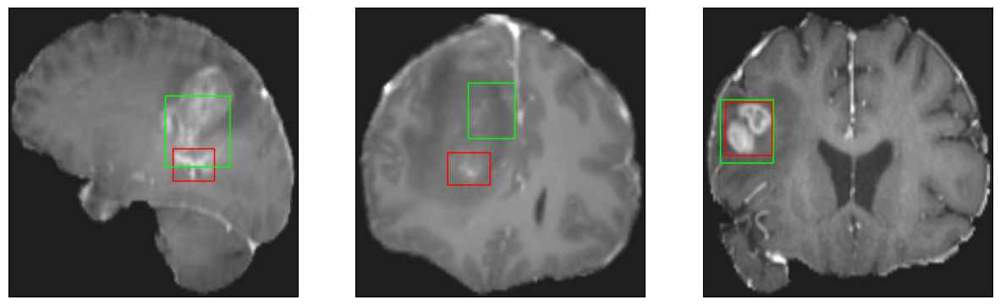

26/26 [==============================] - 3s 107ms/step - loss: 5.9545 - IoU: 0.5574 - val_loss: 12.2489 - val_IoU: 0.3923
Epoch 59/200
25/26 [===========================>..] - ETA: 0s - loss: 6.1557 - IoU: 0.5488
Epoch 59: val_IoU improved from 0.47680 to 0.49069, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4


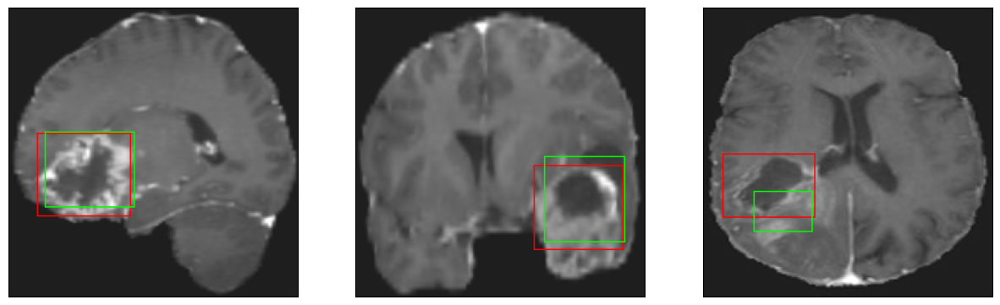

26/26 [==============================] - 4s 152ms/step - loss: 6.1295 - IoU: 0.5489 - val_loss: 9.0732 - val_IoU: 0.4907
Epoch 60/200
25/26 [===========================>..] - ETA: 0s - loss: 5.8008 - IoU: 0.5737
Epoch 60: val_IoU improved from 0.49069 to 0.49133, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


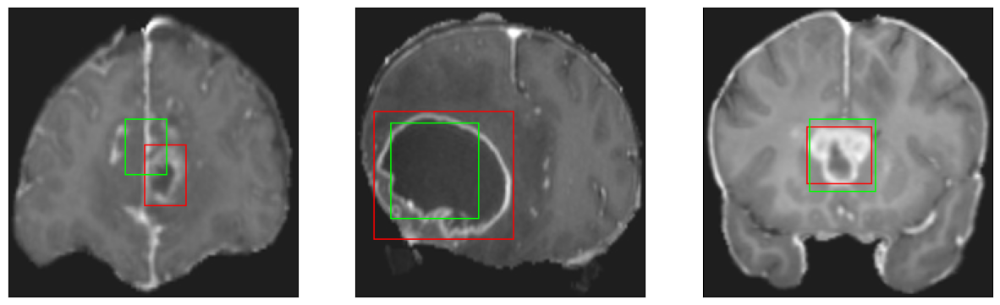

26/26 [==============================] - 3s 122ms/step - loss: 5.8293 - IoU: 0.5728 - val_loss: 8.5194 - val_IoU: 0.4913
Epoch 61/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6483 - IoU: 0.5722
Epoch 61: val_IoU did not improve from 0.49133
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


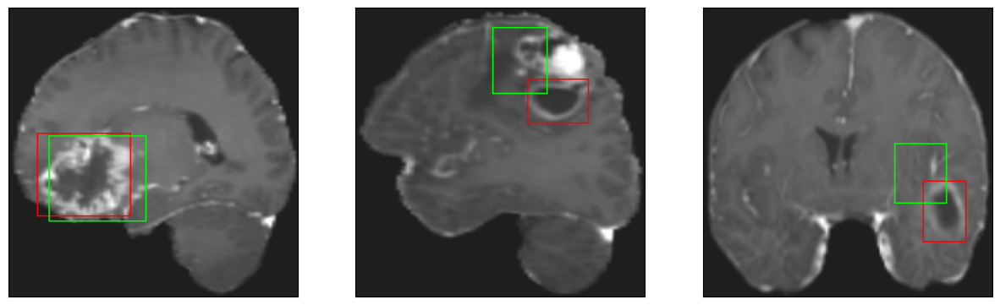

26/26 [==============================] - 3s 116ms/step - loss: 5.6788 - IoU: 0.5712 - val_loss: 9.0899 - val_IoU: 0.4785
Epoch 62/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4892 - IoU: 0.5928
Epoch 62: val_IoU did not improve from 0.49133
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


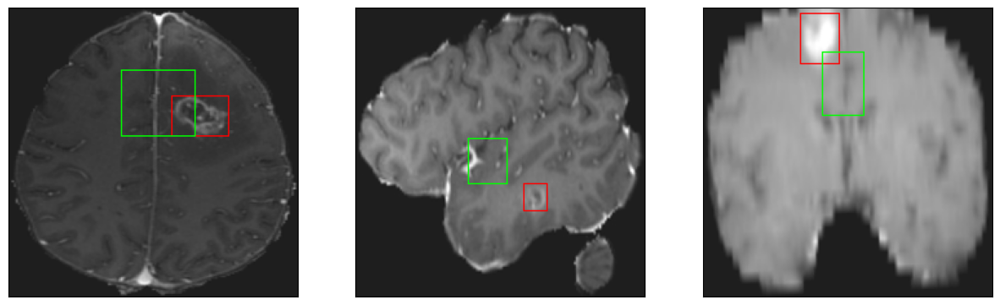

26/26 [==============================] - 3s 101ms/step - loss: 5.5028 - IoU: 0.5929 - val_loss: 9.8629 - val_IoU: 0.4669
Epoch 63/200
25/26 [===========================>..] - ETA: 0s - loss: 5.4117 - IoU: 0.5924
Epoch 63: val_IoU did not improve from 0.49133
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


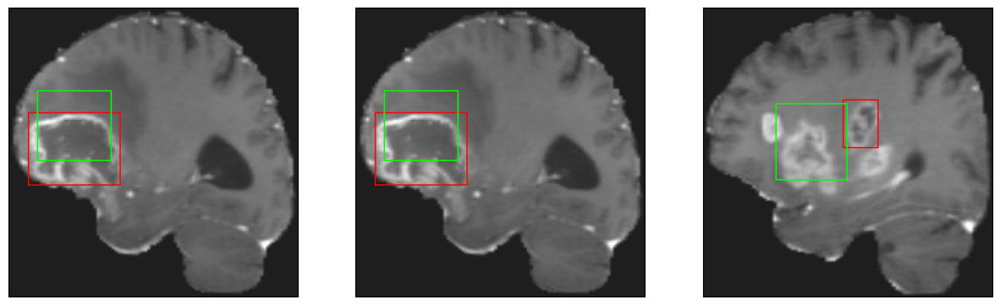

26/26 [==============================] - 3s 104ms/step - loss: 5.4761 - IoU: 0.5895 - val_loss: 13.6104 - val_IoU: 0.3371
Epoch 64/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6021 - IoU: 0.5848
Epoch 64: val_IoU did not improve from 0.49133
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


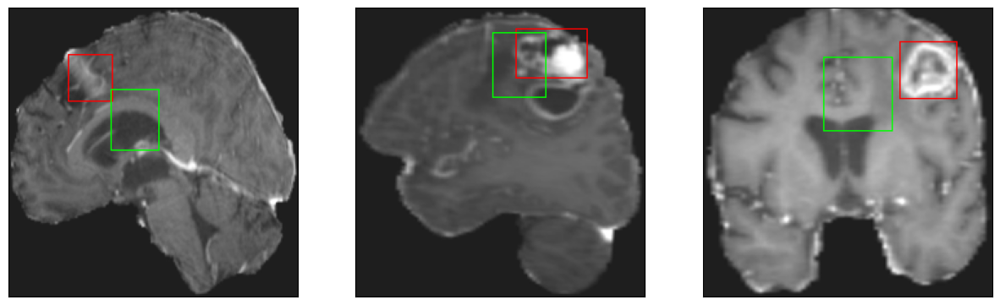

26/26 [==============================] - 3s 112ms/step - loss: 5.5615 - IoU: 0.5864 - val_loss: 10.4791 - val_IoU: 0.4254
Epoch 65/200
25/26 [===========================>..] - ETA: 0s - loss: 5.6862 - IoU: 0.5853
Epoch 65: val_IoU did not improve from 0.49133
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


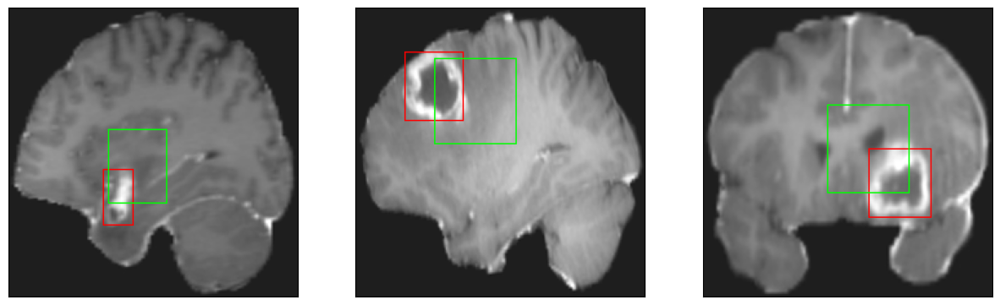

26/26 [==============================] - 3s 105ms/step - loss: 5.6890 - IoU: 0.5837 - val_loss: 13.4409 - val_IoU: 0.3607
Epoch 66/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5877 - IoU: 0.5856
Epoch 66: val_IoU did not improve from 0.49133
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


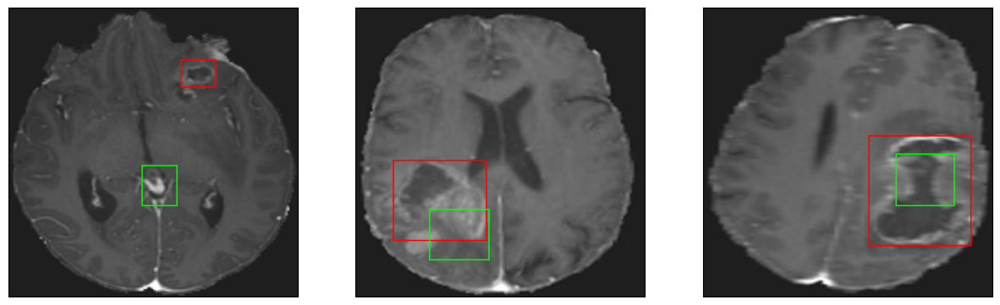

26/26 [==============================] - 3s 134ms/step - loss: 5.5800 - IoU: 0.5855 - val_loss: 8.4227 - val_IoU: 0.4853
Epoch 67/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3591 - IoU: 0.5998
Epoch 67: val_IoU did not improve from 0.49133
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


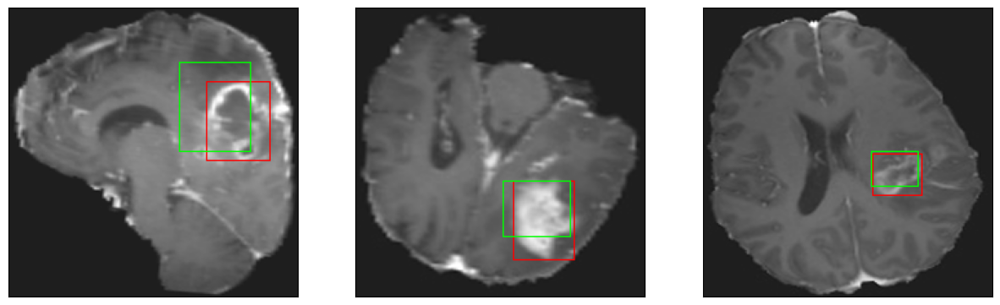

26/26 [==============================] - 3s 109ms/step - loss: 5.3622 - IoU: 0.5985 - val_loss: 9.1089 - val_IoU: 0.4681
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 5.3807 - IoU: 0.6017
Epoch 68: val_IoU improved from 0.49133 to 0.49856, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


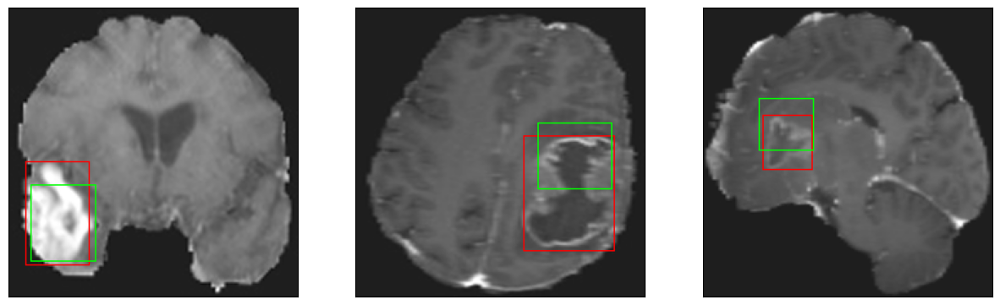

26/26 [==============================] - 3s 118ms/step - loss: 5.3807 - IoU: 0.6017 - val_loss: 8.8498 - val_IoU: 0.4986
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 5.4439 - IoU: 0.5886
Epoch 69: val_IoU did not improve from 0.49856
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


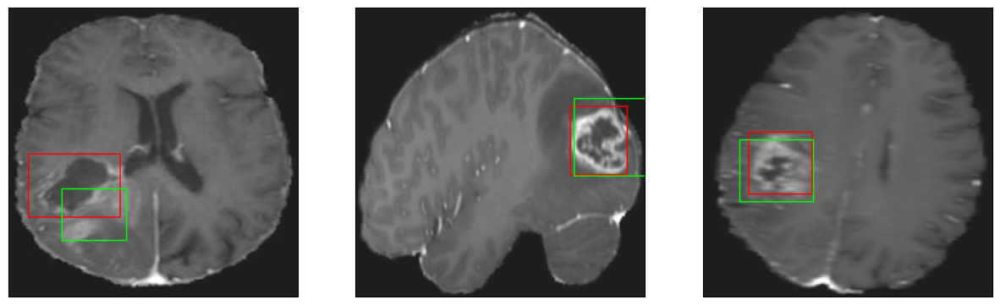

26/26 [==============================] - 3s 101ms/step - loss: 5.4439 - IoU: 0.5886 - val_loss: 9.4985 - val_IoU: 0.4810
Epoch 70/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3503 - IoU: 0.5968
Epoch 70: val_IoU did not improve from 0.49856
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


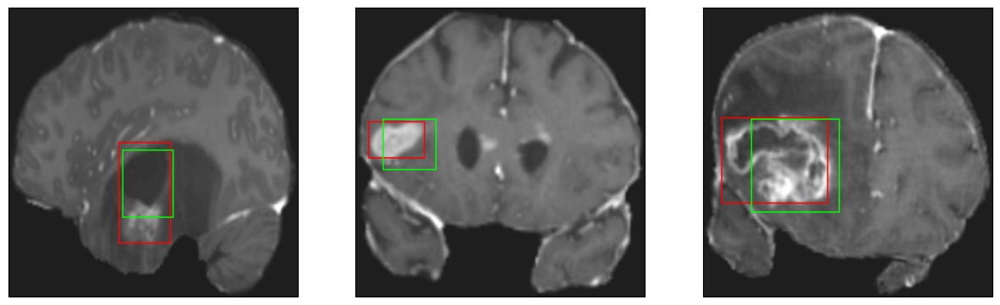

26/26 [==============================] - 3s 108ms/step - loss: 5.4265 - IoU: 0.5945 - val_loss: 9.0821 - val_IoU: 0.4641
Epoch 71/200
25/26 [===========================>..] - ETA: 0s - loss: 5.5620 - IoU: 0.5767
Epoch 71: val_IoU did not improve from 0.49856
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


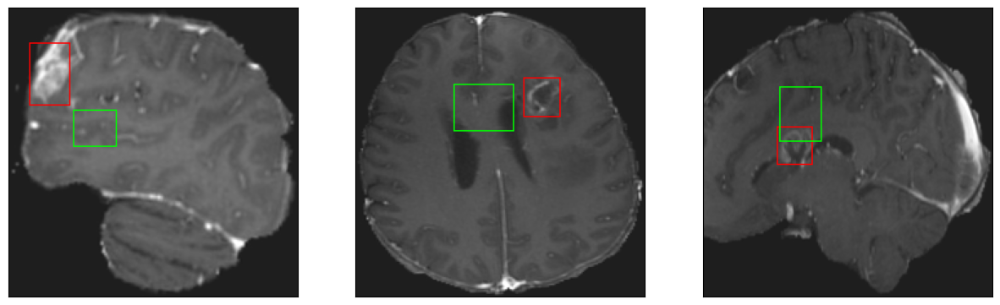

26/26 [==============================] - 3s 110ms/step - loss: 5.5143 - IoU: 0.5777 - val_loss: 9.3291 - val_IoU: 0.4743
Epoch 72/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2469 - IoU: 0.6115
Epoch 72: val_IoU did not improve from 0.49856
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


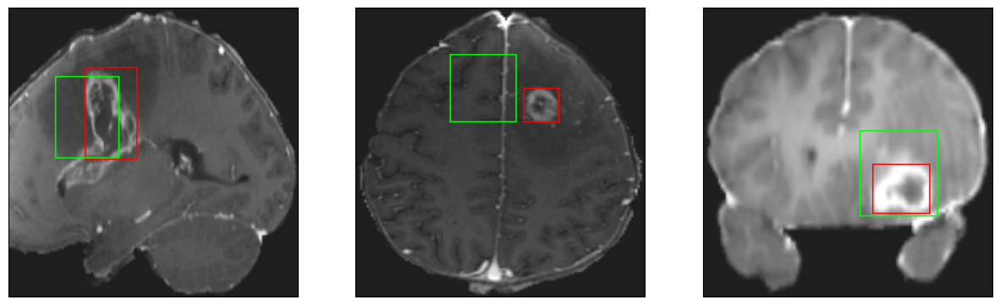

26/26 [==============================] - 3s 109ms/step - loss: 5.2938 - IoU: 0.6095 - val_loss: 9.2597 - val_IoU: 0.4923
Epoch 73/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2548 - IoU: 0.6056
Epoch 73: val_IoU did not improve from 0.49856
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


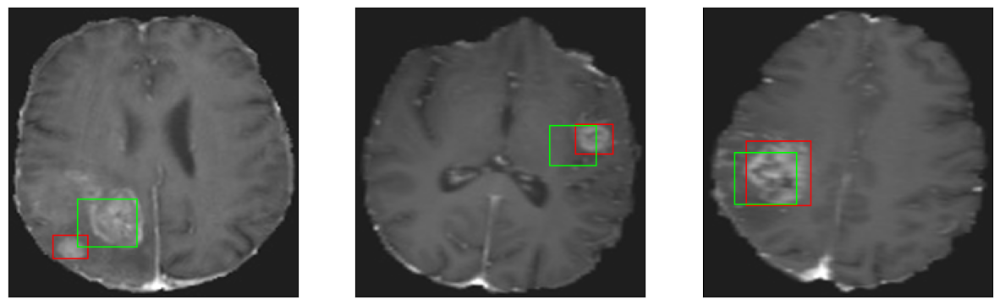

26/26 [==============================] - 3s 120ms/step - loss: 5.2218 - IoU: 0.6062 - val_loss: 9.1359 - val_IoU: 0.4676
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 5.2516 - IoU: 0.5959
Epoch 74: val_IoU did not improve from 0.49856
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


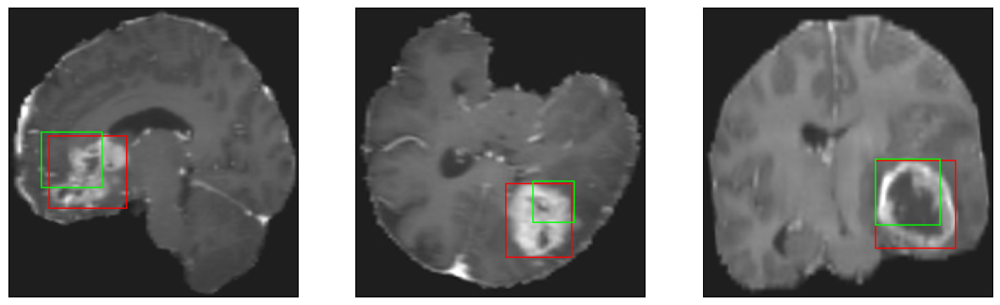

26/26 [==============================] - 3s 101ms/step - loss: 5.2516 - IoU: 0.5959 - val_loss: 8.8191 - val_IoU: 0.4885
Epoch 75/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0955 - IoU: 0.6129
Epoch 75: val_IoU did not improve from 0.49856
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


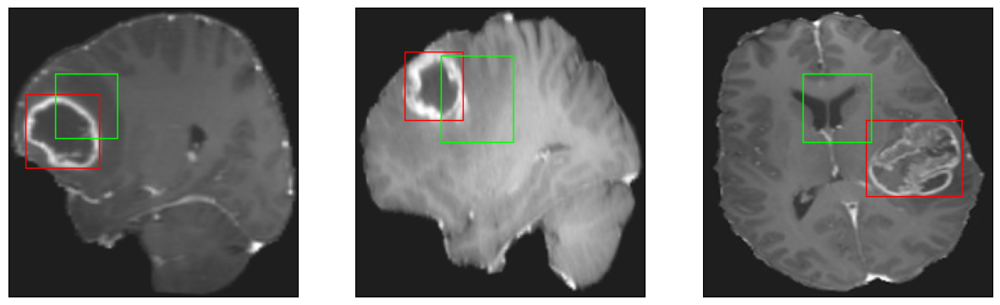

26/26 [==============================] - 3s 105ms/step - loss: 5.0954 - IoU: 0.6138 - val_loss: 21.2592 - val_IoU: 0.1525
Epoch 76/200
25/26 [===========================>..] - ETA: 0s - loss: 5.2121 - IoU: 0.5976
Epoch 76: val_IoU improved from 0.49856 to 0.50969, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 12ms/step
4


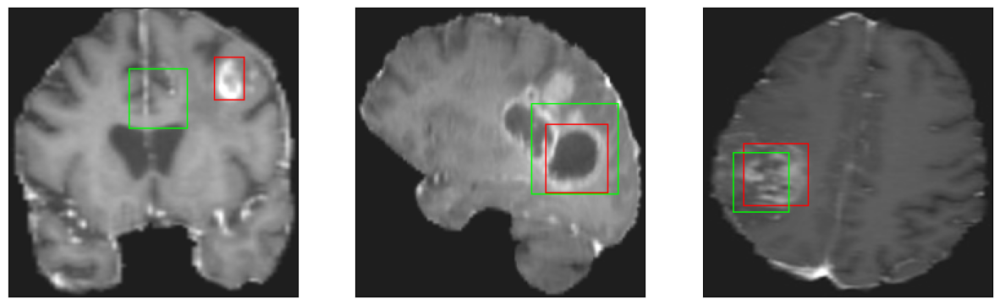

26/26 [==============================] - 4s 160ms/step - loss: 5.2084 - IoU: 0.5976 - val_loss: 8.6375 - val_IoU: 0.5097
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 5.2018 - IoU: 0.6073
Epoch 77: val_IoU did not improve from 0.50969
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


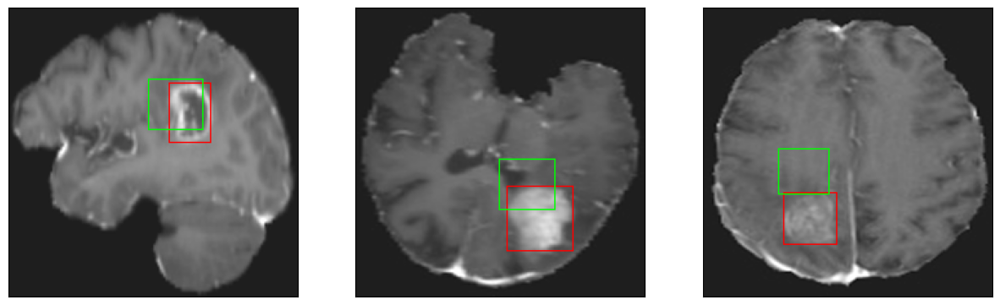

26/26 [==============================] - 3s 98ms/step - loss: 5.2018 - IoU: 0.6073 - val_loss: 14.1835 - val_IoU: 0.3007
Epoch 78/200
25/26 [===========================>..] - ETA: 0s - loss: 5.3430 - IoU: 0.5905
Epoch 78: val_IoU did not improve from 0.50969
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


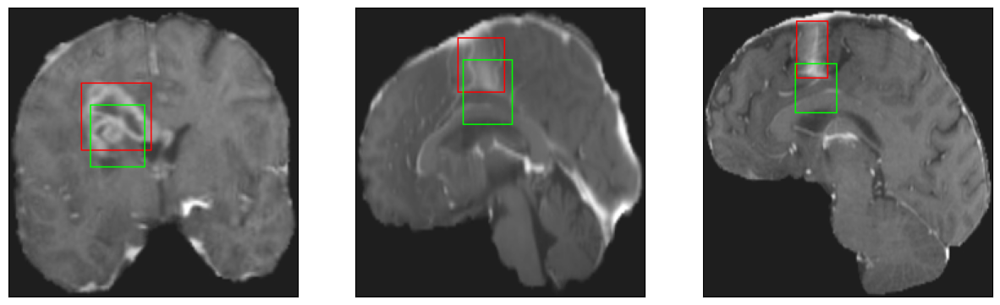

26/26 [==============================] - 3s 99ms/step - loss: 5.3414 - IoU: 0.5900 - val_loss: 10.6005 - val_IoU: 0.4207
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 5.2255 - IoU: 0.5980
Epoch 79: val_IoU did not improve from 0.50969
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


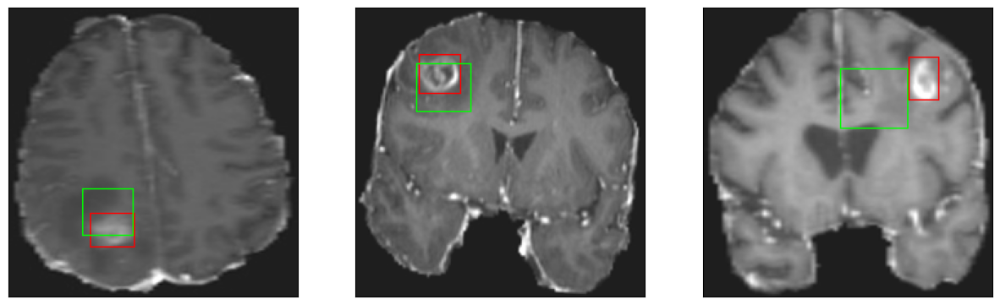

26/26 [==============================] - 3s 104ms/step - loss: 5.2255 - IoU: 0.5980 - val_loss: 10.2075 - val_IoU: 0.4420
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 5.3749 - IoU: 0.5951
Epoch 80: val_IoU did not improve from 0.50969
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


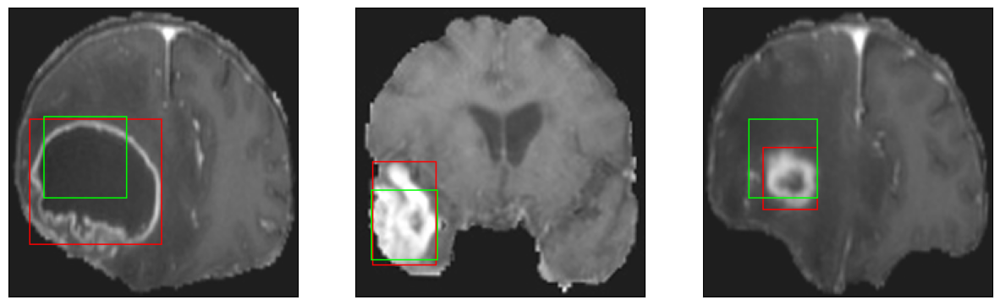

26/26 [==============================] - 3s 112ms/step - loss: 5.3749 - IoU: 0.5951 - val_loss: 9.8484 - val_IoU: 0.4459
Epoch 81/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9438 - IoU: 0.6194
Epoch 81: val_IoU did not improve from 0.50969
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


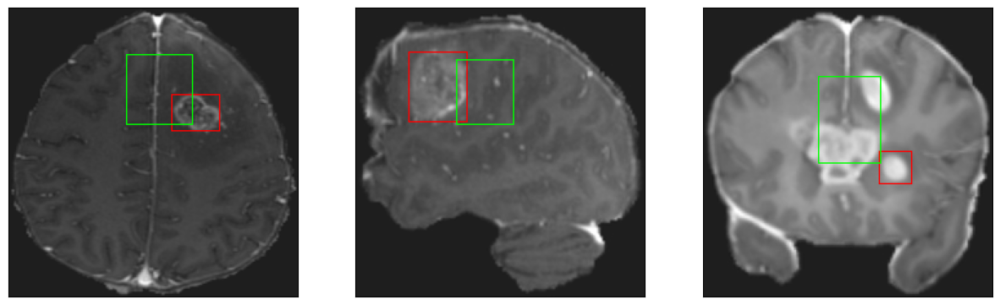

26/26 [==============================] - 3s 117ms/step - loss: 4.9485 - IoU: 0.6187 - val_loss: 21.8943 - val_IoU: 0.1489
Epoch 82/200
25/26 [===========================>..] - ETA: 0s - loss: 5.1640 - IoU: 0.6055
Epoch 82: val_IoU improved from 0.50969 to 0.51077, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


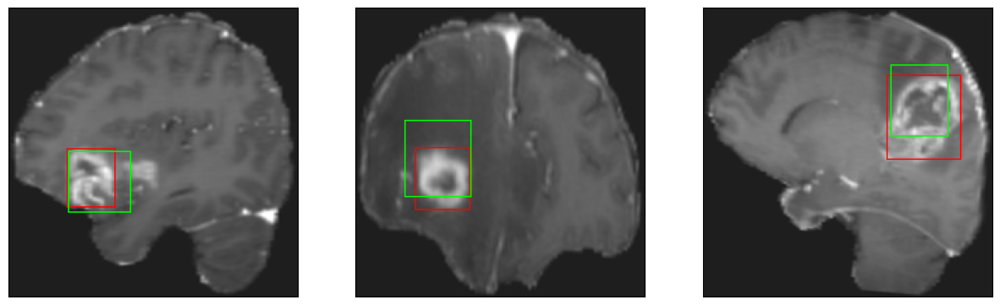

26/26 [==============================] - 3s 125ms/step - loss: 5.1385 - IoU: 0.6081 - val_loss: 8.6233 - val_IoU: 0.5108
Epoch 83/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0814 - IoU: 0.6121
Epoch 83: val_IoU did not improve from 0.51077
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


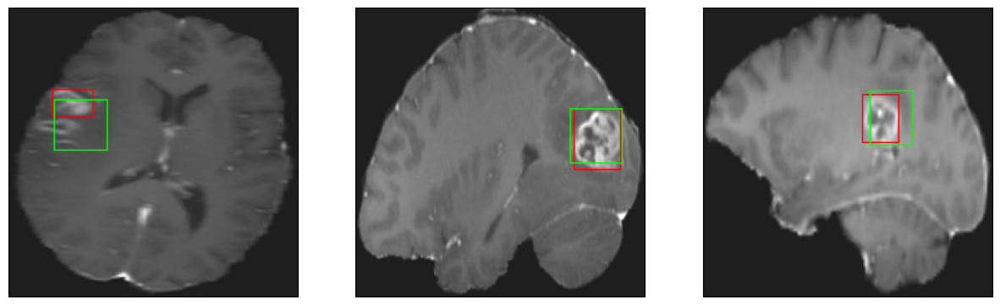

26/26 [==============================] - 3s 132ms/step - loss: 5.1034 - IoU: 0.6109 - val_loss: 8.5446 - val_IoU: 0.4996
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 5.2711 - IoU: 0.5999
Epoch 84: val_IoU did not improve from 0.51077
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


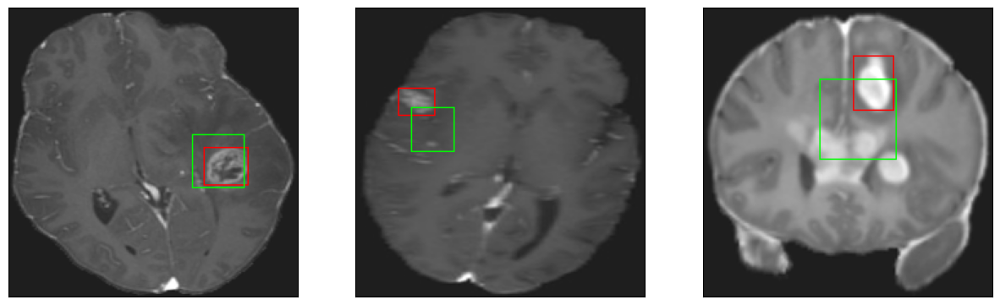

26/26 [==============================] - 3s 100ms/step - loss: 5.2711 - IoU: 0.5999 - val_loss: 9.5857 - val_IoU: 0.4685
Epoch 85/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8852 - IoU: 0.6203
Epoch 85: val_IoU did not improve from 0.51077
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


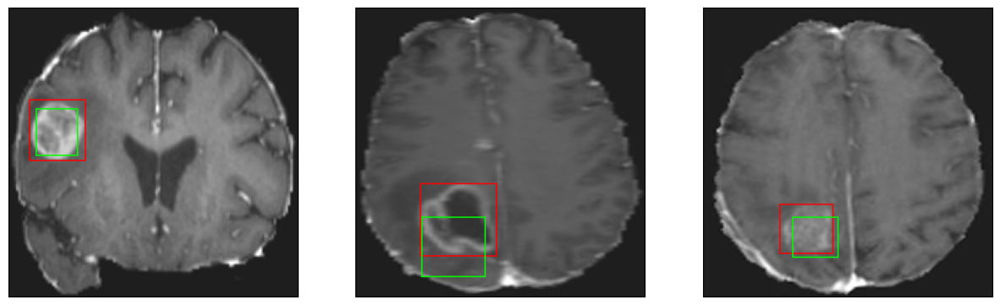

26/26 [==============================] - 3s 107ms/step - loss: 4.9000 - IoU: 0.6208 - val_loss: 8.5175 - val_IoU: 0.5065
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 4.9738 - IoU: 0.6166
Epoch 86: val_IoU did not improve from 0.51077
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


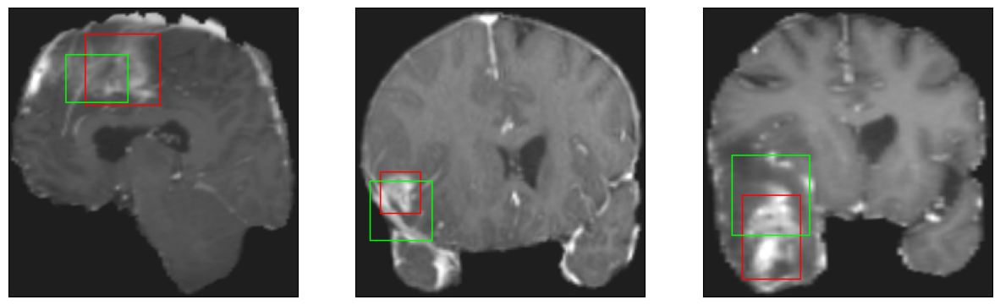

26/26 [==============================] - 3s 122ms/step - loss: 4.9738 - IoU: 0.6166 - val_loss: 10.4661 - val_IoU: 0.4352
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 5.1432 - IoU: 0.6076
Epoch 87: val_IoU did not improve from 0.51077
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


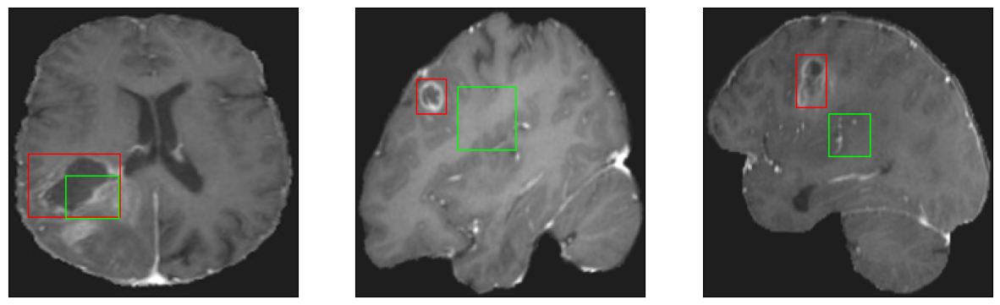

26/26 [==============================] - 2s 95ms/step - loss: 5.1432 - IoU: 0.6076 - val_loss: 12.5926 - val_IoU: 0.3701
Epoch 88/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9513 - IoU: 0.6200
Epoch 88: val_IoU did not improve from 0.51077
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


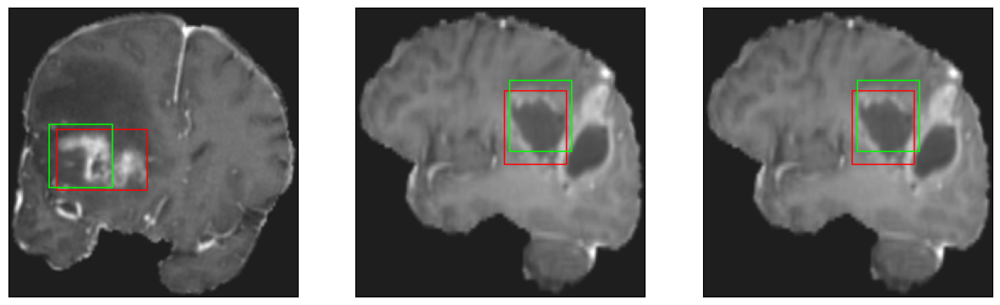

26/26 [==============================] - 3s 98ms/step - loss: 5.0264 - IoU: 0.6163 - val_loss: 11.5841 - val_IoU: 0.3922
Epoch 89/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9457 - IoU: 0.6195
Epoch 89: val_IoU did not improve from 0.51077
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


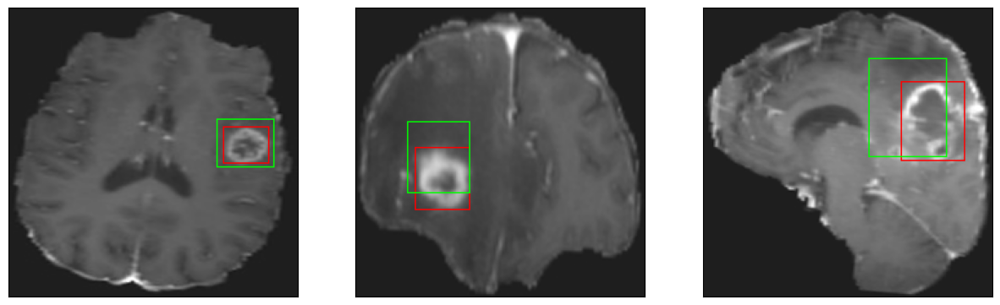

26/26 [==============================] - 3s 98ms/step - loss: 4.9789 - IoU: 0.6176 - val_loss: 9.6302 - val_IoU: 0.4797
Epoch 90/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8918 - IoU: 0.6254
Epoch 90: val_IoU did not improve from 0.51077
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


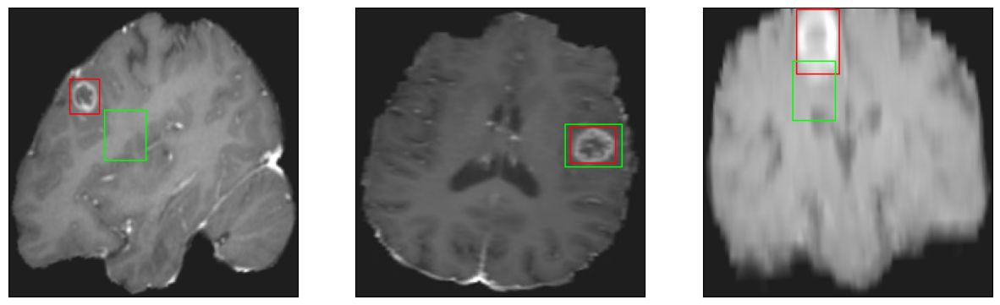

26/26 [==============================] - 3s 101ms/step - loss: 4.8912 - IoU: 0.6247 - val_loss: 9.1041 - val_IoU: 0.4839
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 4.8536 - IoU: 0.6235
Epoch 91: val_IoU improved from 0.51077 to 0.51135, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


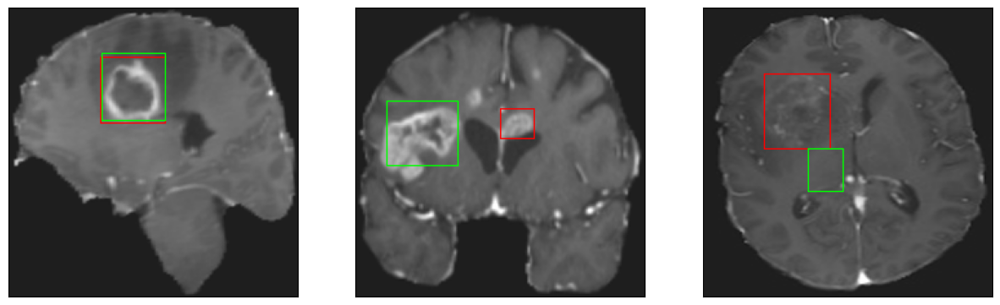

26/26 [==============================] - 3s 131ms/step - loss: 4.8536 - IoU: 0.6235 - val_loss: 8.3106 - val_IoU: 0.5113
Epoch 92/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0135 - IoU: 0.6098
Epoch 92: val_IoU did not improve from 0.51135
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


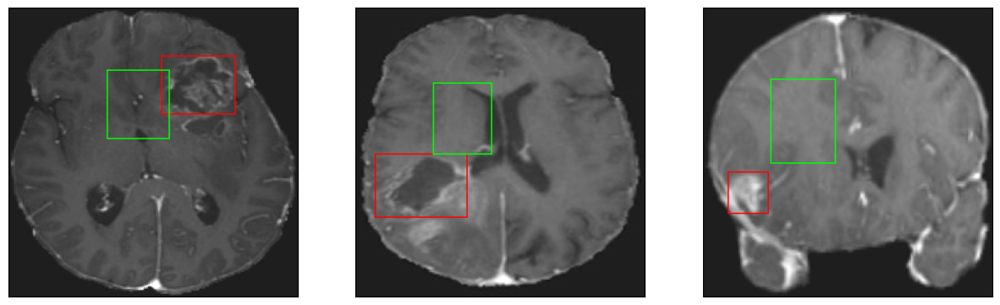

26/26 [==============================] - 3s 108ms/step - loss: 5.0279 - IoU: 0.6099 - val_loss: 22.6769 - val_IoU: 0.1430
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 4.8601 - IoU: 0.6225
Epoch 93: val_IoU did not improve from 0.51135
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


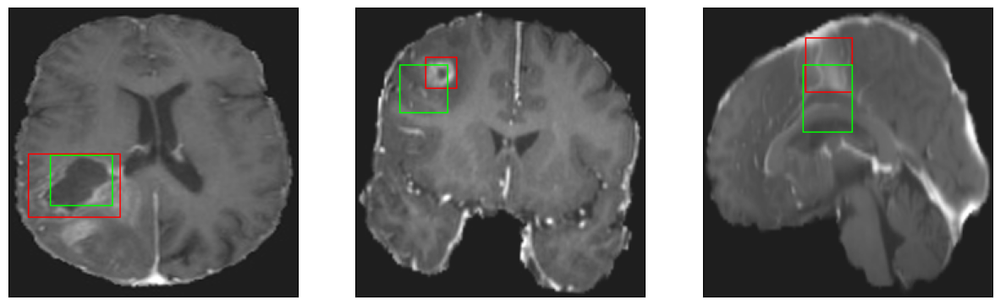

26/26 [==============================] - 3s 106ms/step - loss: 4.8601 - IoU: 0.6225 - val_loss: 13.0449 - val_IoU: 0.3453
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 4.9010 - IoU: 0.6164
Epoch 94: val_IoU did not improve from 0.51135
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


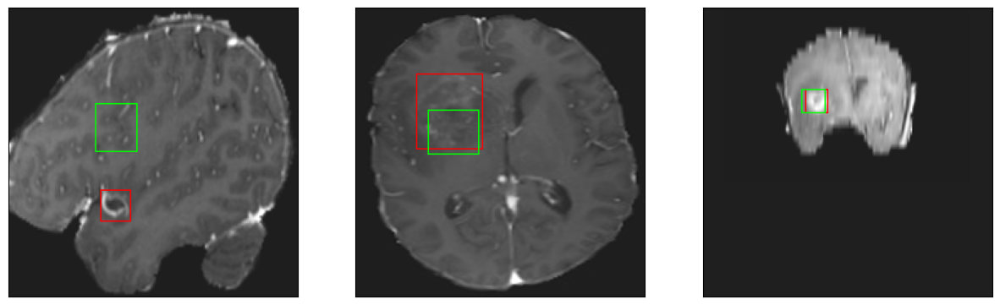

26/26 [==============================] - 3s 113ms/step - loss: 4.9010 - IoU: 0.6164 - val_loss: 12.1379 - val_IoU: 0.3562
Epoch 95/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8821 - IoU: 0.6234
Epoch 95: val_IoU did not improve from 0.51135
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


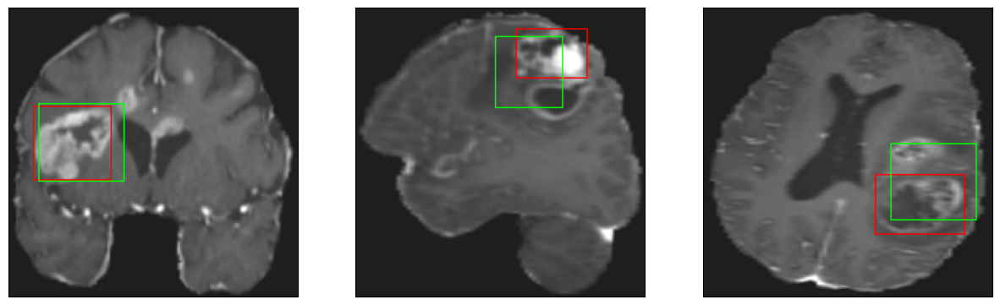

26/26 [==============================] - 3s 107ms/step - loss: 4.8556 - IoU: 0.6248 - val_loss: 9.2807 - val_IoU: 0.4982
Epoch 96/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8051 - IoU: 0.6246
Epoch 96: val_IoU did not improve from 0.51135
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


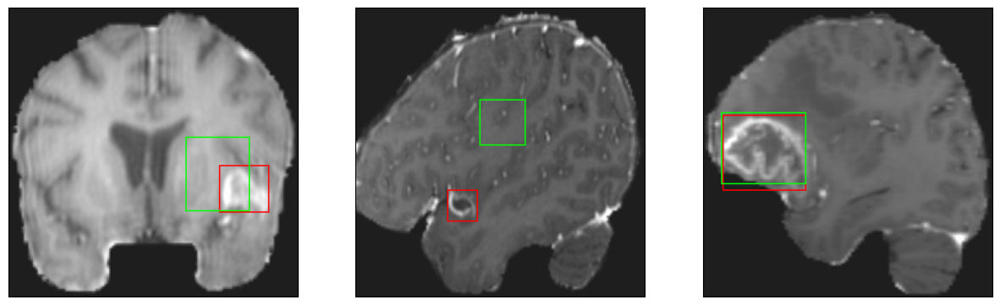

26/26 [==============================] - 3s 105ms/step - loss: 4.8190 - IoU: 0.6249 - val_loss: 8.9447 - val_IoU: 0.4972
Epoch 97/200
25/26 [===========================>..] - ETA: 0s - loss: 5.0895 - IoU: 0.6070
Epoch 97: val_IoU did not improve from 0.51135
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


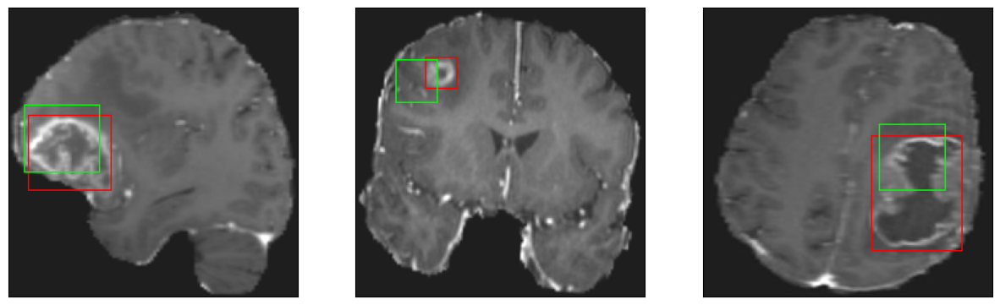

26/26 [==============================] - 3s 103ms/step - loss: 5.0996 - IoU: 0.6079 - val_loss: 8.4915 - val_IoU: 0.5094
Epoch 98/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8177 - IoU: 0.6240
Epoch 98: val_IoU did not improve from 0.51135
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 11ms/step
4


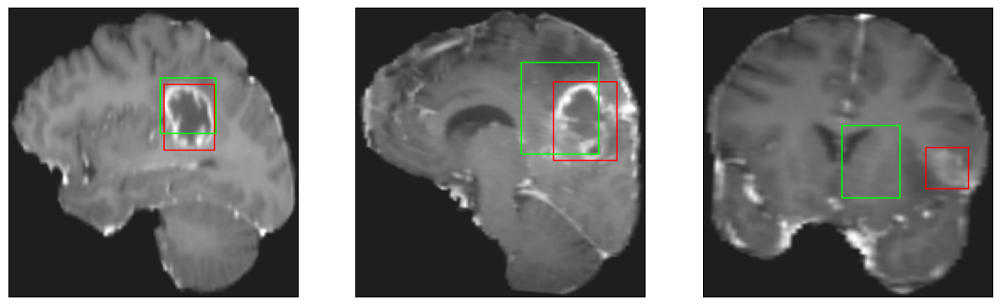

26/26 [==============================] - 3s 111ms/step - loss: 4.8185 - IoU: 0.6238 - val_loss: 9.7059 - val_IoU: 0.4568
Epoch 99/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8991 - IoU: 0.6201
Epoch 99: val_IoU did not improve from 0.51135
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


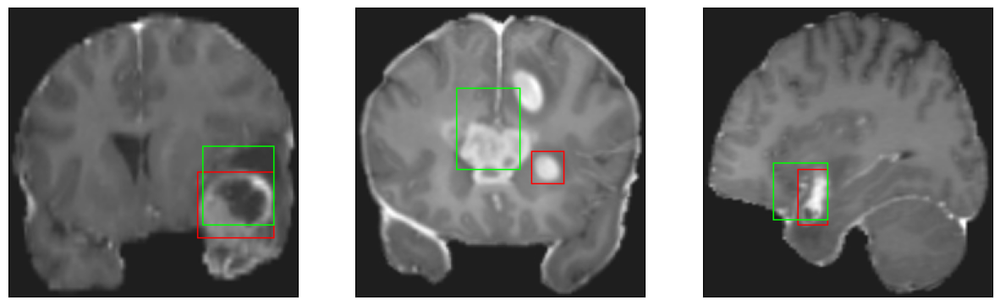

26/26 [==============================] - 3s 108ms/step - loss: 4.8689 - IoU: 0.6232 - val_loss: 9.7705 - val_IoU: 0.4763
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 5.0310 - IoU: 0.6126
Epoch 100: val_IoU improved from 0.51135 to 0.51176, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


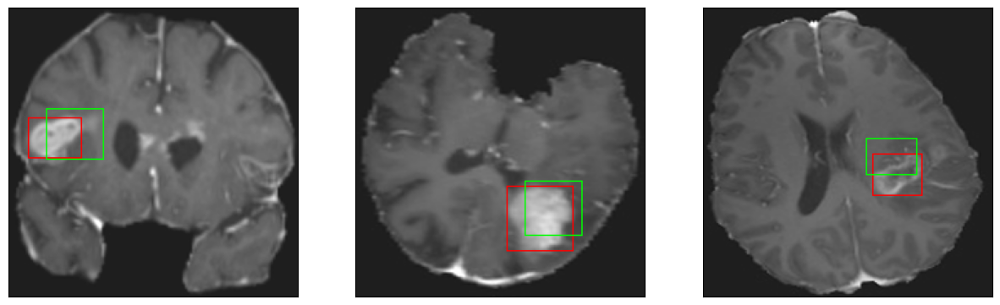

26/26 [==============================] - 4s 148ms/step - loss: 5.0310 - IoU: 0.6126 - val_loss: 8.6576 - val_IoU: 0.5118
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 5.1050 - IoU: 0.6086
Epoch 101: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


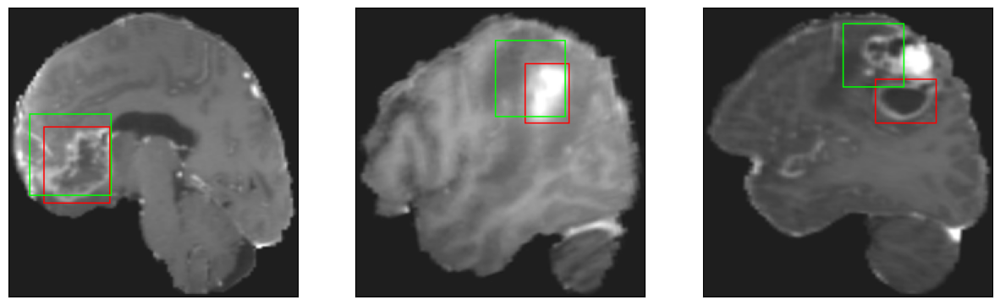

26/26 [==============================] - 3s 117ms/step - loss: 5.1050 - IoU: 0.6086 - val_loss: 9.8341 - val_IoU: 0.4505
Epoch 102/200
25/26 [===========================>..] - ETA: 0s - loss: 4.8867 - IoU: 0.6245
Epoch 102: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4


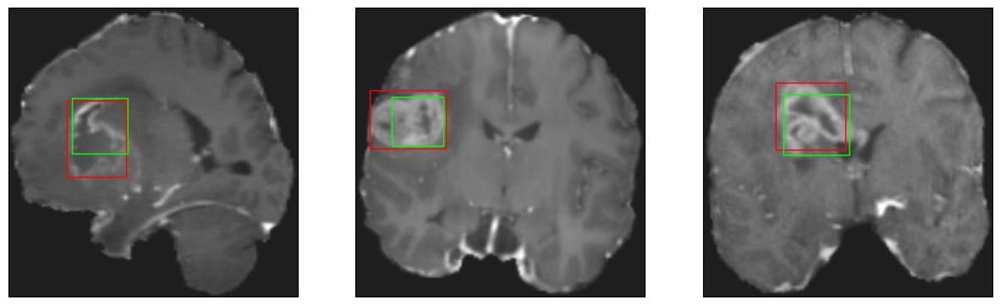

26/26 [==============================] - 3s 98ms/step - loss: 4.8934 - IoU: 0.6243 - val_loss: 12.5289 - val_IoU: 0.3528
Epoch 103/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9461 - IoU: 0.6170
Epoch 103: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


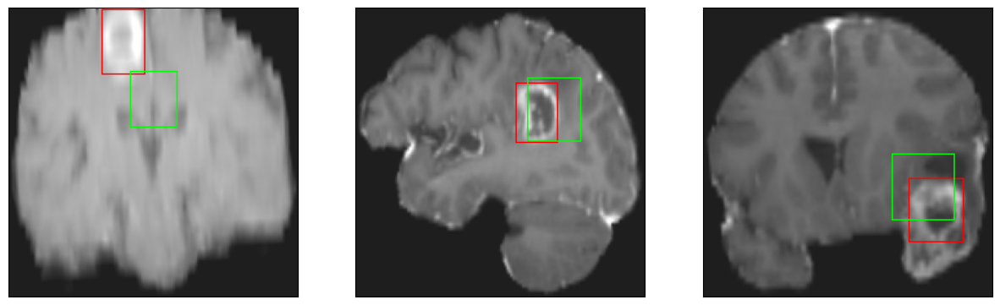

26/26 [==============================] - 3s 99ms/step - loss: 4.9376 - IoU: 0.6166 - val_loss: 8.8465 - val_IoU: 0.5011
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 4.7649 - IoU: 0.6251
Epoch 104: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


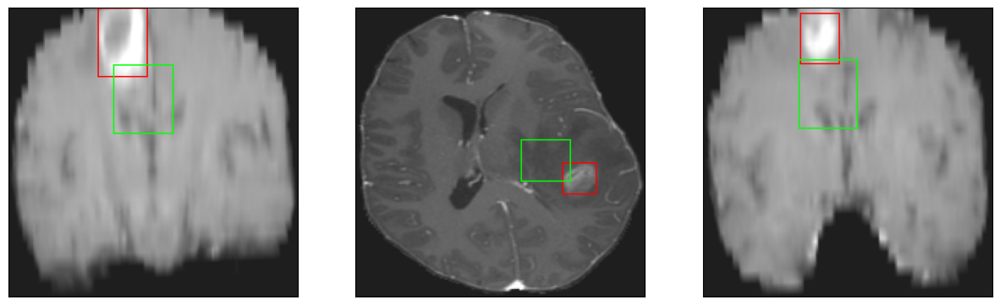

26/26 [==============================] - 3s 122ms/step - loss: 4.7649 - IoU: 0.6251 - val_loss: 11.7764 - val_IoU: 0.3864
Epoch 105/200
25/26 [===========================>..] - ETA: 0s - loss: 4.9198 - IoU: 0.6194
Epoch 105: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


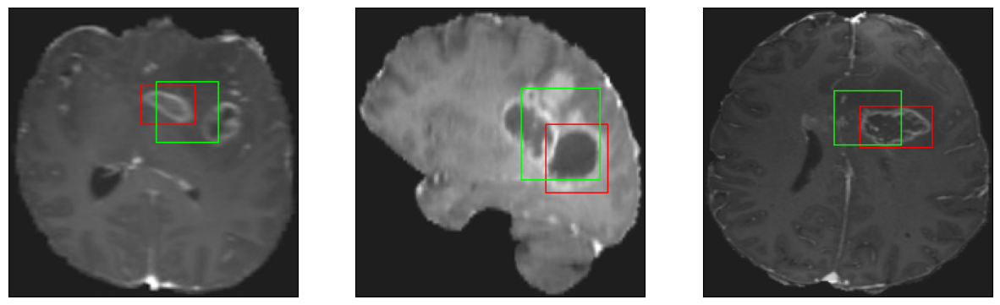

26/26 [==============================] - 3s 106ms/step - loss: 4.9042 - IoU: 0.6205 - val_loss: 8.7295 - val_IoU: 0.4938
Epoch 106/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6771 - IoU: 0.6306
Epoch 106: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


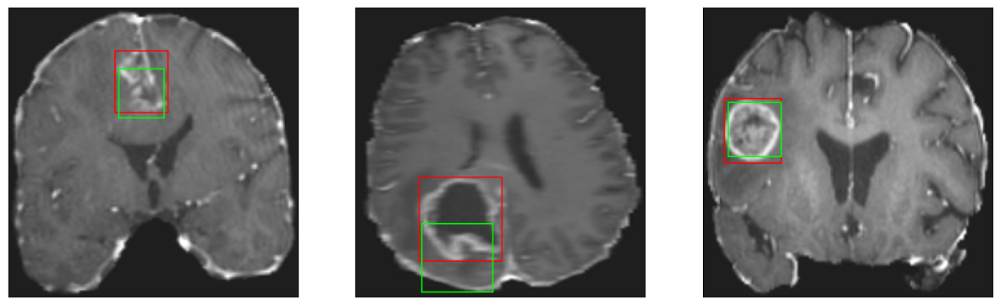

26/26 [==============================] - 3s 100ms/step - loss: 4.6861 - IoU: 0.6304 - val_loss: 9.0420 - val_IoU: 0.4999
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 4.8896 - IoU: 0.6168
Epoch 107: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


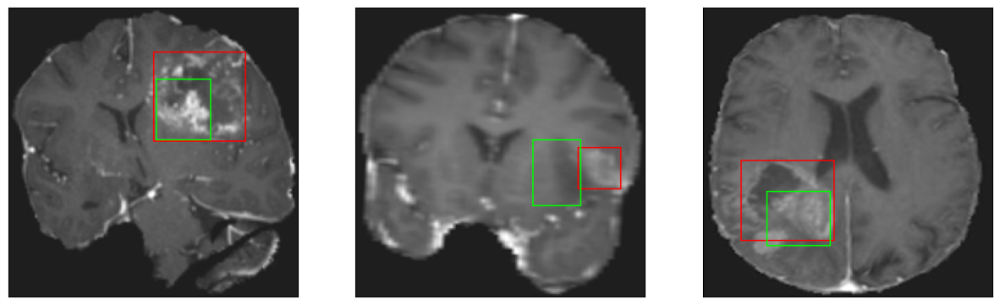

26/26 [==============================] - 3s 133ms/step - loss: 4.8896 - IoU: 0.6168 - val_loss: 8.7920 - val_IoU: 0.4899
Epoch 108/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6856 - IoU: 0.6373
Epoch 108: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


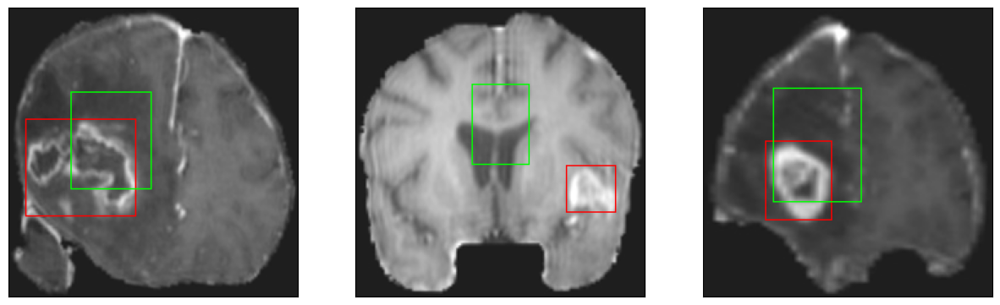

26/26 [==============================] - 3s 108ms/step - loss: 4.6983 - IoU: 0.6349 - val_loss: 19.3887 - val_IoU: 0.2042
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 4.8647 - IoU: 0.6242
Epoch 109: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


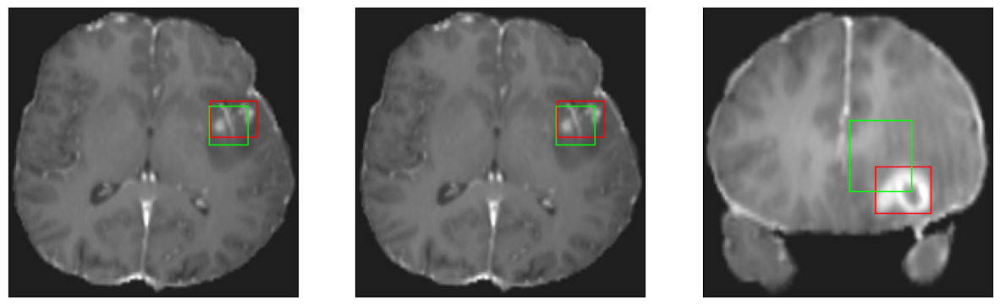

26/26 [==============================] - 3s 104ms/step - loss: 4.8647 - IoU: 0.6242 - val_loss: 9.0736 - val_IoU: 0.4789
Epoch 110/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7447 - IoU: 0.6285
Epoch 110: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


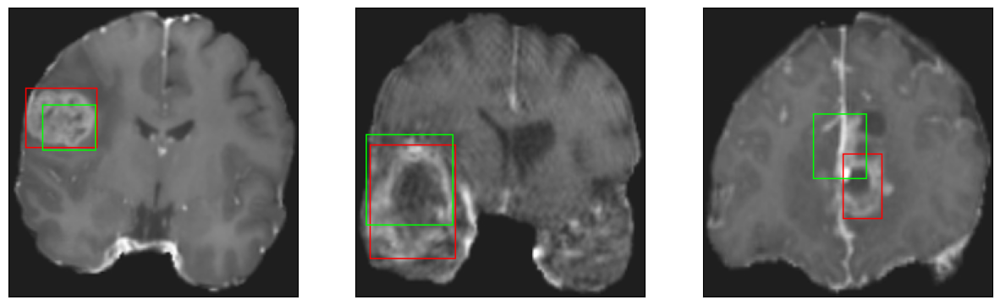

26/26 [==============================] - 3s 114ms/step - loss: 4.7397 - IoU: 0.6299 - val_loss: 9.0933 - val_IoU: 0.4807
Epoch 111/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6991 - IoU: 0.6296
Epoch 111: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


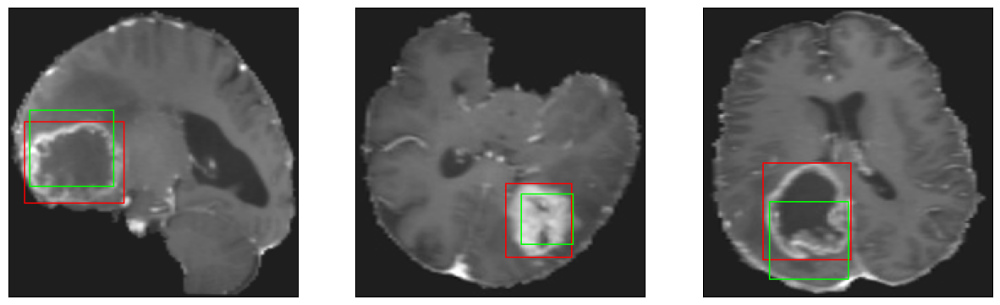

26/26 [==============================] - 3s 104ms/step - loss: 4.6492 - IoU: 0.6322 - val_loss: 9.0771 - val_IoU: 0.4923
Epoch 112/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7051 - IoU: 0.6356
Epoch 112: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4


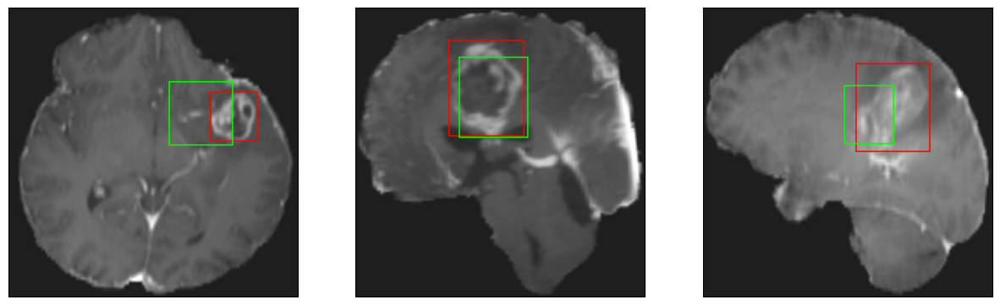

26/26 [==============================] - 3s 102ms/step - loss: 4.7179 - IoU: 0.6339 - val_loss: 9.0445 - val_IoU: 0.5047
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 4.7834 - IoU: 0.6327
Epoch 113: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


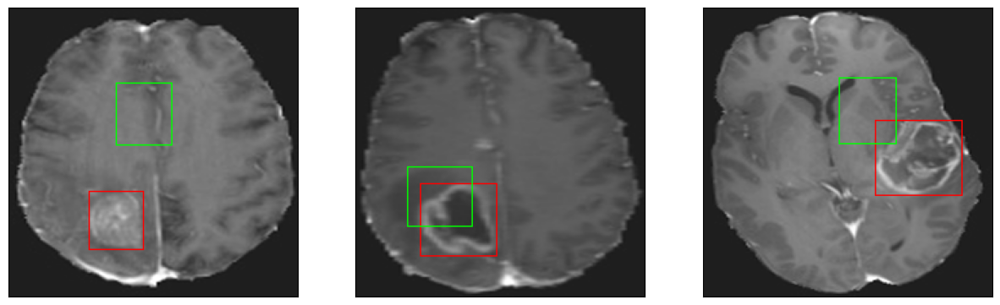

26/26 [==============================] - 3s 123ms/step - loss: 4.7834 - IoU: 0.6327 - val_loss: 16.0112 - val_IoU: 0.2673
Epoch 114/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6066 - IoU: 0.6412
Epoch 114: val_IoU did not improve from 0.51176
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


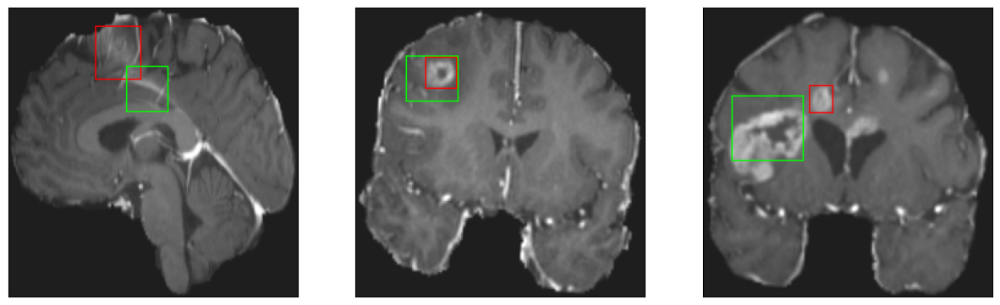

26/26 [==============================] - 3s 121ms/step - loss: 4.6550 - IoU: 0.6394 - val_loss: 11.0686 - val_IoU: 0.4085
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 4.6265 - IoU: 0.6374
Epoch 115: val_IoU improved from 0.51176 to 0.51916, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


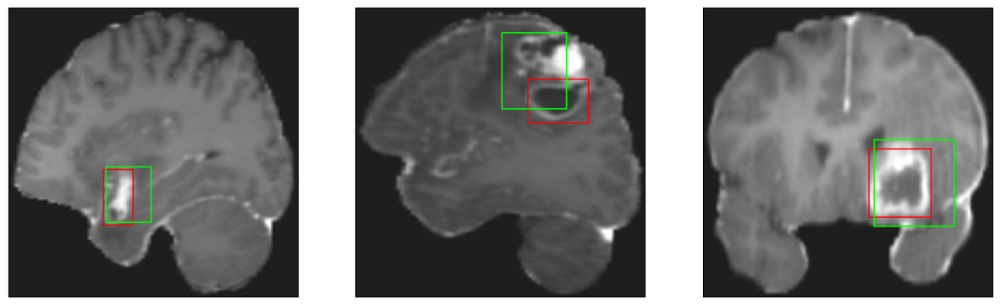

26/26 [==============================] - 3s 133ms/step - loss: 4.6265 - IoU: 0.6374 - val_loss: 8.7801 - val_IoU: 0.5192
Epoch 116/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6707 - IoU: 0.6330
Epoch 116: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 11ms/step
4


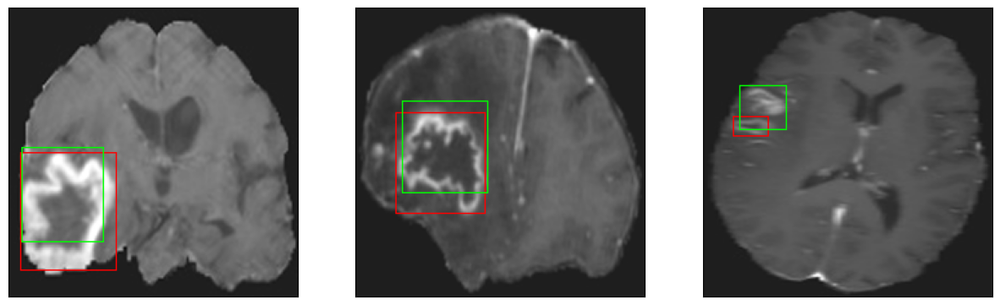

26/26 [==============================] - 3s 105ms/step - loss: 4.7363 - IoU: 0.6281 - val_loss: 9.2767 - val_IoU: 0.4639
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 4.6349 - IoU: 0.6317
Epoch 117: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


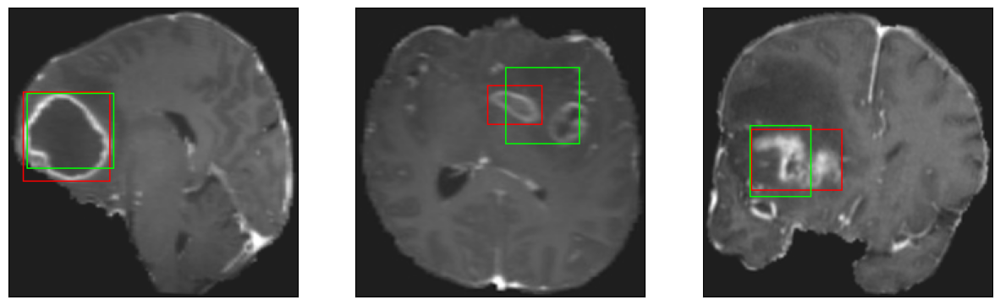

26/26 [==============================] - 3s 126ms/step - loss: 4.6349 - IoU: 0.6317 - val_loss: 9.7016 - val_IoU: 0.4683
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 4.5759 - IoU: 0.6354
Epoch 118: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


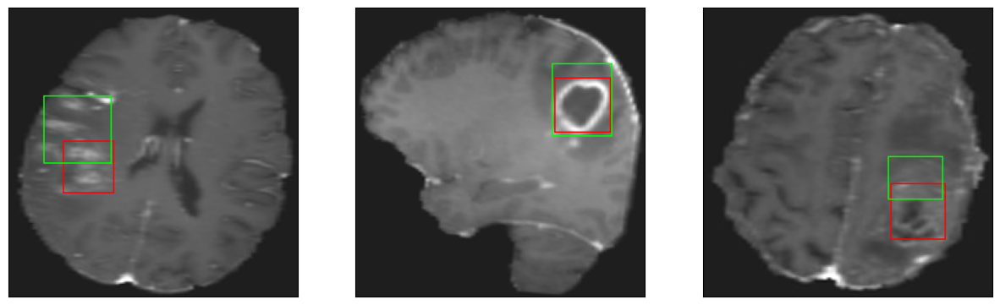

26/26 [==============================] - 3s 125ms/step - loss: 4.5759 - IoU: 0.6354 - val_loss: 8.4026 - val_IoU: 0.5108
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 4.5742 - IoU: 0.6380
Epoch 119: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


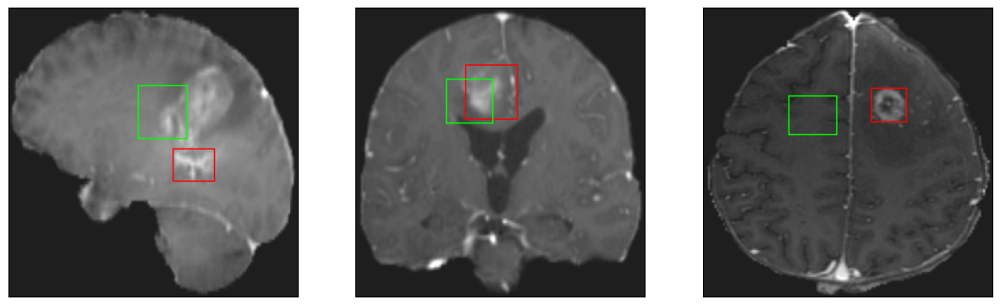

26/26 [==============================] - 3s 100ms/step - loss: 4.5742 - IoU: 0.6380 - val_loss: 15.4447 - val_IoU: 0.2548
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 4.6989 - IoU: 0.6280
Epoch 120: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


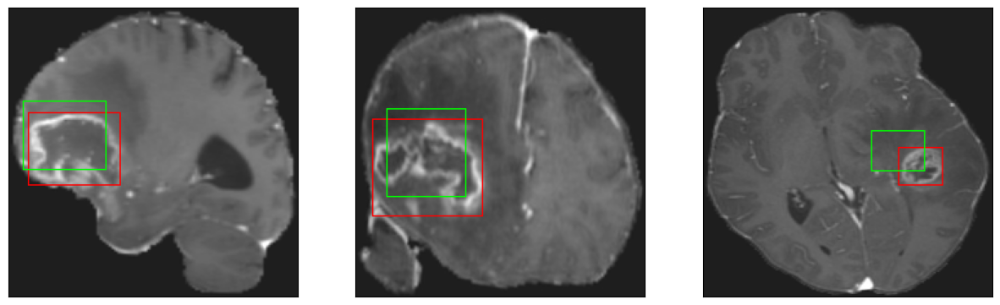

26/26 [==============================] - 3s 96ms/step - loss: 4.6989 - IoU: 0.6280 - val_loss: 10.2044 - val_IoU: 0.4328
Epoch 121/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5028 - IoU: 0.6417
Epoch 121: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


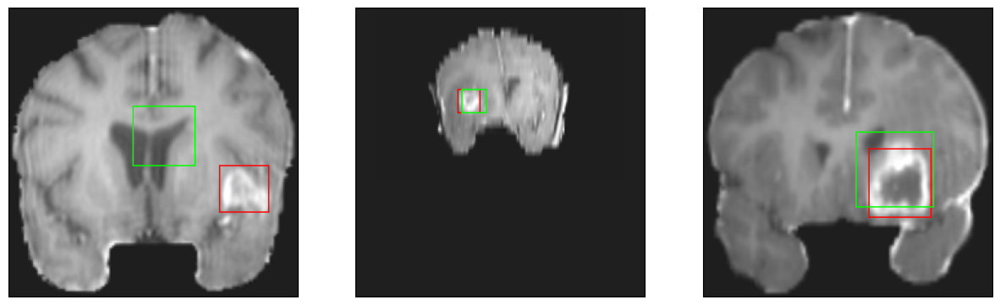

26/26 [==============================] - 3s 123ms/step - loss: 4.5106 - IoU: 0.6425 - val_loss: 10.6197 - val_IoU: 0.4276
Epoch 122/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5664 - IoU: 0.6417
Epoch 122: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


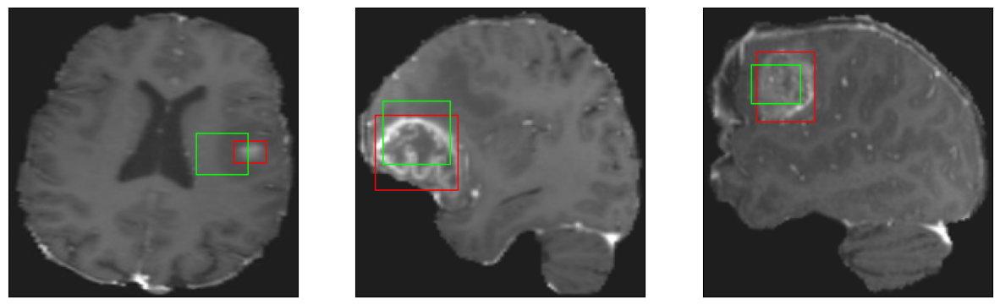

26/26 [==============================] - 3s 103ms/step - loss: 4.5972 - IoU: 0.6390 - val_loss: 9.1232 - val_IoU: 0.4745
Epoch 123/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7756 - IoU: 0.6260
Epoch 123: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


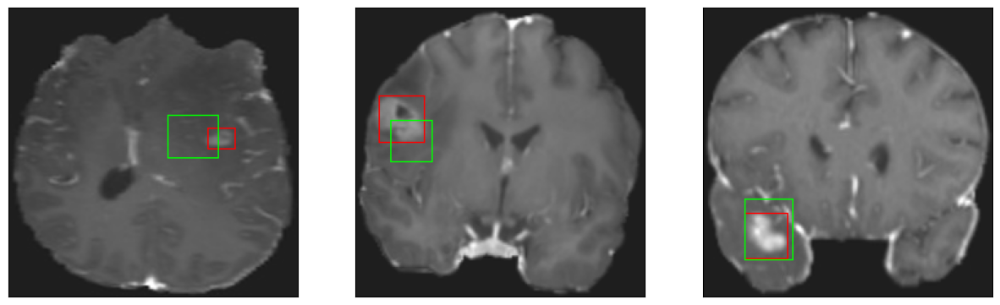

26/26 [==============================] - 3s 106ms/step - loss: 4.7327 - IoU: 0.6276 - val_loss: 8.2981 - val_IoU: 0.5173
Epoch 124/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4618 - IoU: 0.6469
Epoch 124: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4


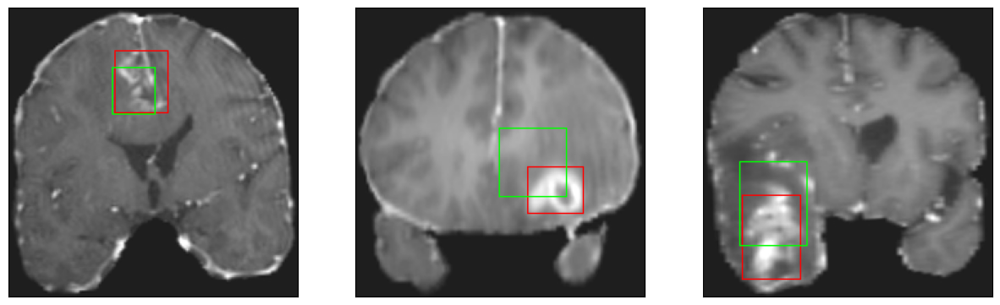

26/26 [==============================] - 3s 102ms/step - loss: 4.4498 - IoU: 0.6455 - val_loss: 8.8077 - val_IoU: 0.5034
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 4.5480 - IoU: 0.6439
Epoch 125: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


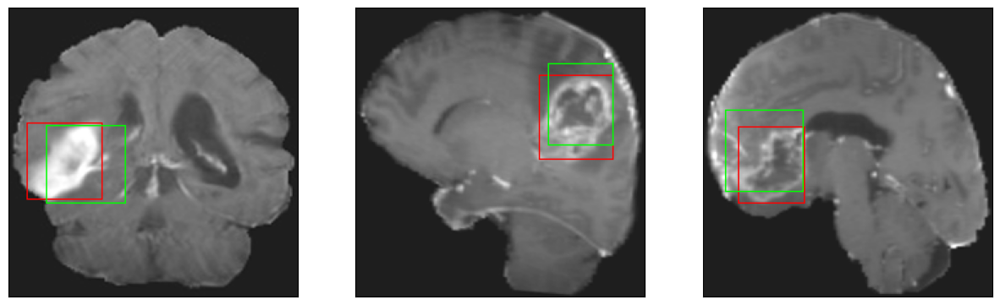

26/26 [==============================] - 2s 96ms/step - loss: 4.5480 - IoU: 0.6439 - val_loss: 8.8095 - val_IoU: 0.5101
Epoch 126/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5906 - IoU: 0.6442
Epoch 126: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


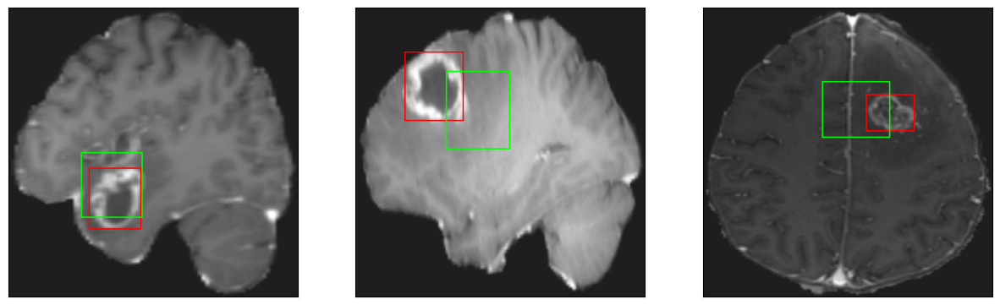

26/26 [==============================] - 3s 112ms/step - loss: 4.5380 - IoU: 0.6449 - val_loss: 9.8376 - val_IoU: 0.4659
Epoch 127/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5237 - IoU: 0.6401
Epoch 127: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


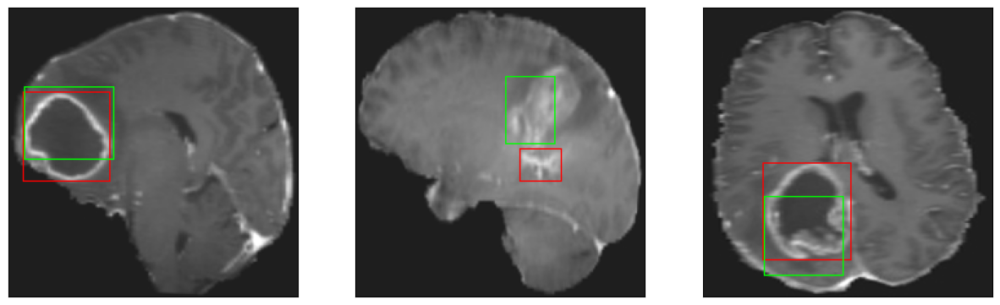

26/26 [==============================] - 3s 124ms/step - loss: 4.5635 - IoU: 0.6393 - val_loss: 8.8055 - val_IoU: 0.4925
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 4.5593 - IoU: 0.6423
Epoch 128: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


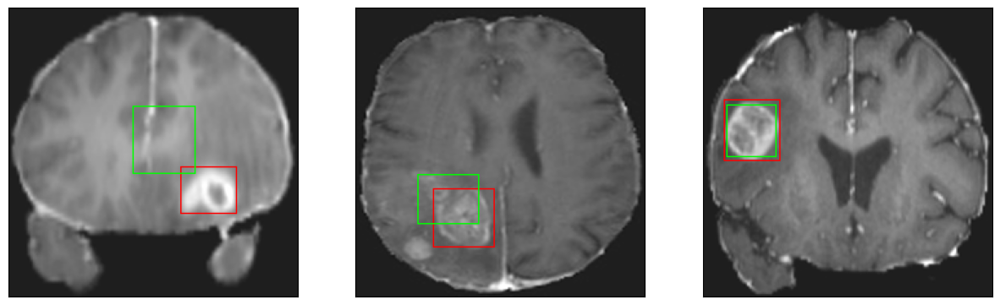

26/26 [==============================] - 3s 102ms/step - loss: 4.5593 - IoU: 0.6423 - val_loss: 12.1096 - val_IoU: 0.3643
Epoch 129/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5016 - IoU: 0.6513
Epoch 129: val_IoU did not improve from 0.51916
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


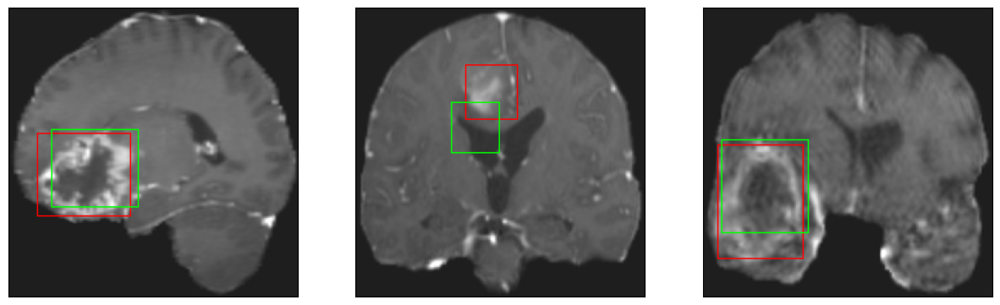

26/26 [==============================] - 3s 101ms/step - loss: 4.5123 - IoU: 0.6491 - val_loss: 8.4948 - val_IoU: 0.5155
Epoch 130/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5540 - IoU: 0.6397
Epoch 130: val_IoU improved from 0.51916 to 0.53306, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


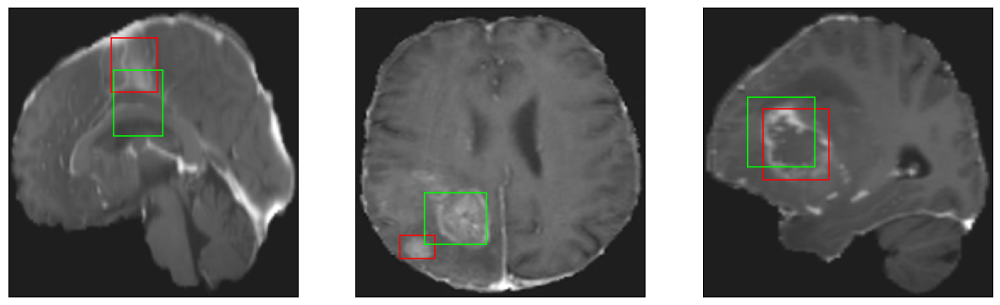

26/26 [==============================] - 18s 710ms/step - loss: 4.5480 - IoU: 0.6400 - val_loss: 8.3988 - val_IoU: 0.5331
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 4.6451 - IoU: 0.6295
Epoch 131: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


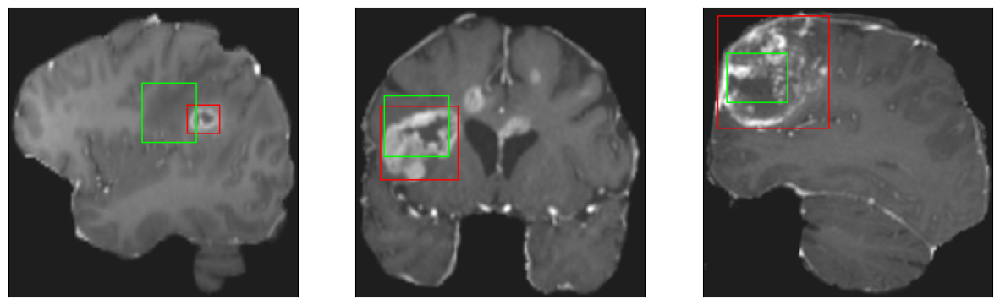

26/26 [==============================] - 3s 104ms/step - loss: 4.6451 - IoU: 0.6295 - val_loss: 13.8899 - val_IoU: 0.2908
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 4.6350 - IoU: 0.6387
Epoch 132: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


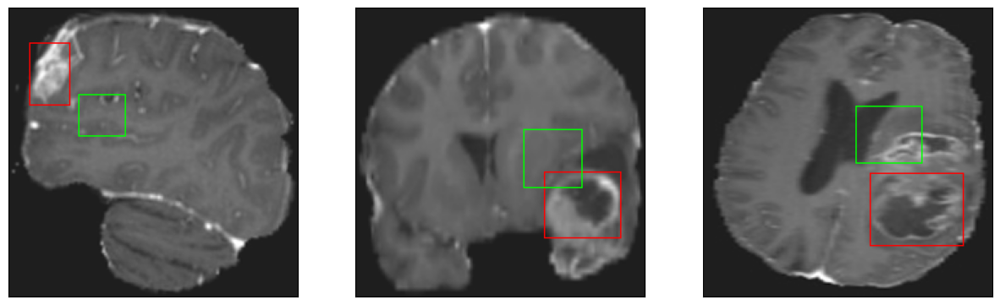

26/26 [==============================] - 2s 93ms/step - loss: 4.6350 - IoU: 0.6387 - val_loss: 11.8607 - val_IoU: 0.3651
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 4.4586 - IoU: 0.6468
Epoch 133: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


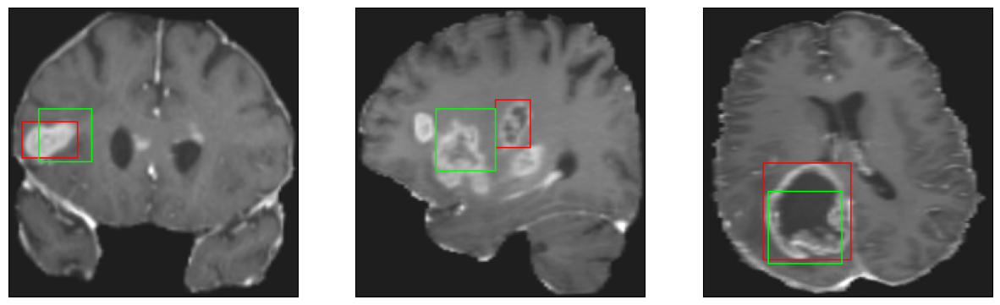

26/26 [==============================] - 2s 96ms/step - loss: 4.4586 - IoU: 0.6468 - val_loss: 9.9359 - val_IoU: 0.4667
Epoch 134/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3371 - IoU: 0.6495
Epoch 134: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


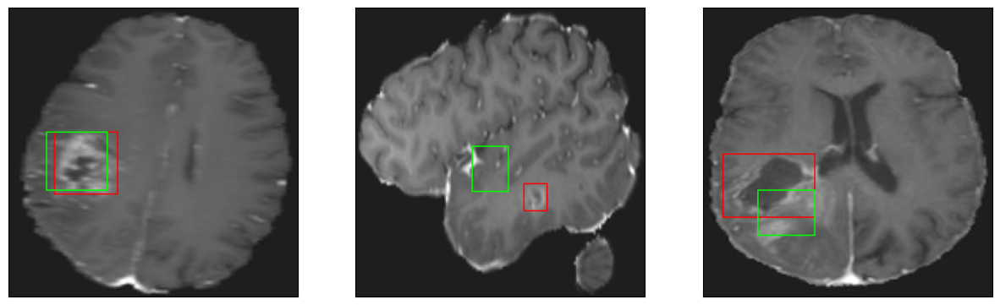

26/26 [==============================] - 3s 114ms/step - loss: 4.4014 - IoU: 0.6460 - val_loss: 8.2492 - val_IoU: 0.5273
Epoch 135/200
25/26 [===========================>..] - ETA: 0s - loss: 4.7048 - IoU: 0.6202
Epoch 135: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


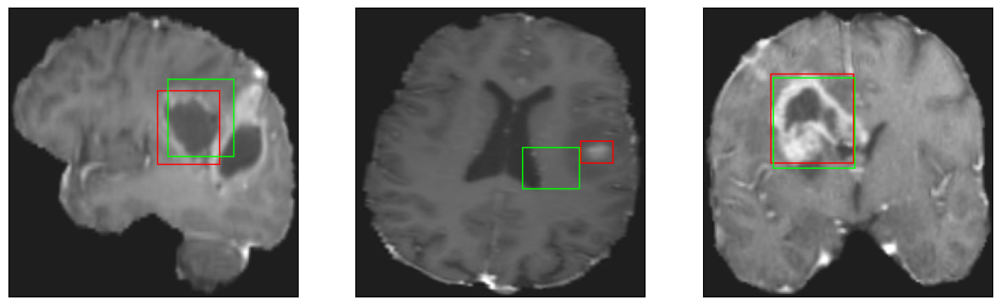

26/26 [==============================] - 3s 99ms/step - loss: 4.6878 - IoU: 0.6207 - val_loss: 9.8148 - val_IoU: 0.4773
Epoch 136/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6313 - IoU: 0.6420
Epoch 136: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


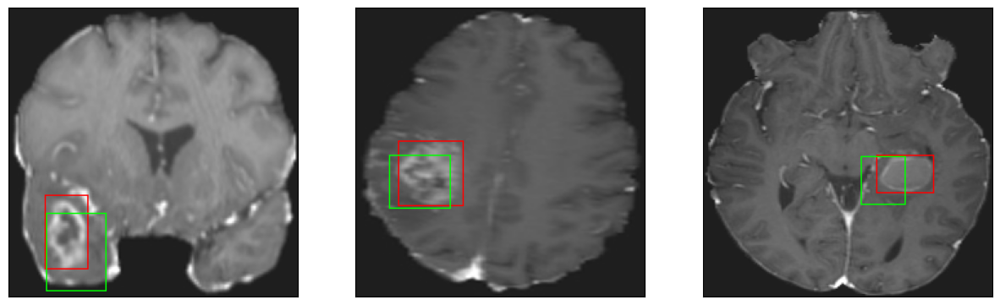

26/26 [==============================] - 2s 96ms/step - loss: 4.5986 - IoU: 0.6427 - val_loss: 8.7793 - val_IoU: 0.4927
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 4.6468 - IoU: 0.6370
Epoch 137: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


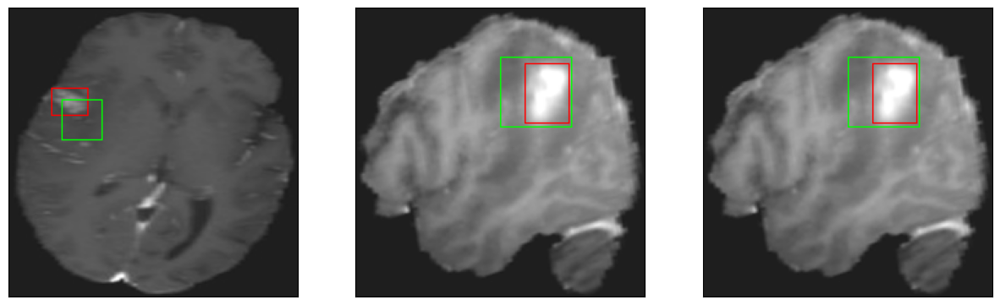

26/26 [==============================] - 3s 105ms/step - loss: 4.6468 - IoU: 0.6370 - val_loss: 8.9740 - val_IoU: 0.4954
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 4.4781 - IoU: 0.6440
Epoch 138: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


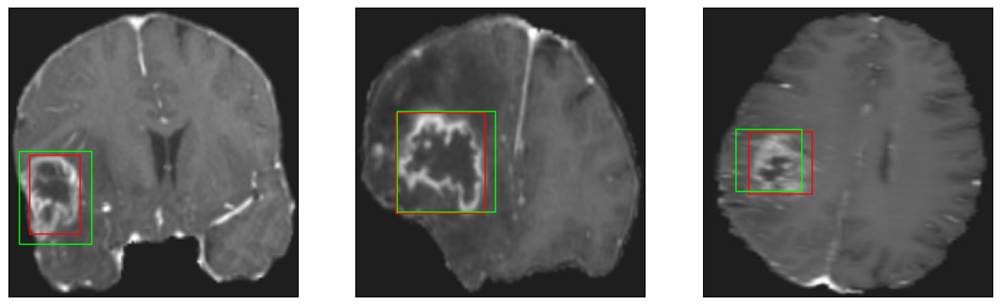

26/26 [==============================] - 3s 98ms/step - loss: 4.4781 - IoU: 0.6440 - val_loss: 8.6133 - val_IoU: 0.5240
Epoch 139/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5706 - IoU: 0.6410
Epoch 139: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


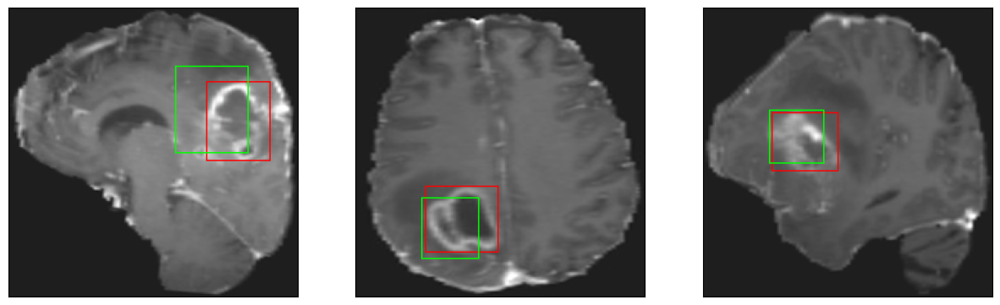

26/26 [==============================] - 3s 112ms/step - loss: 4.5493 - IoU: 0.6412 - val_loss: 11.2693 - val_IoU: 0.3963
Epoch 140/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4974 - IoU: 0.6405
Epoch 140: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


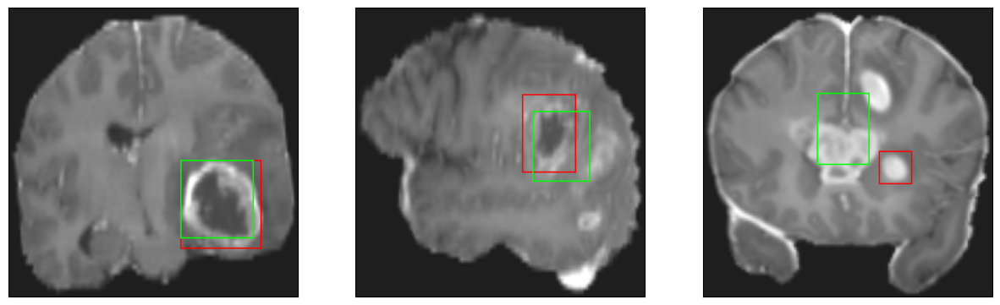

26/26 [==============================] - 3s 114ms/step - loss: 4.5088 - IoU: 0.6409 - val_loss: 8.5685 - val_IoU: 0.5059
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 4.3174 - IoU: 0.6590
Epoch 141: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


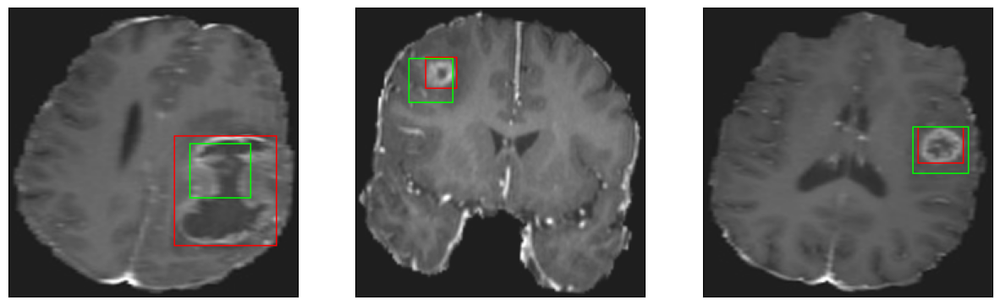

26/26 [==============================] - 3s 103ms/step - loss: 4.3174 - IoU: 0.6590 - val_loss: 8.2662 - val_IoU: 0.5205
Epoch 142/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2614 - IoU: 0.6549
Epoch 142: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


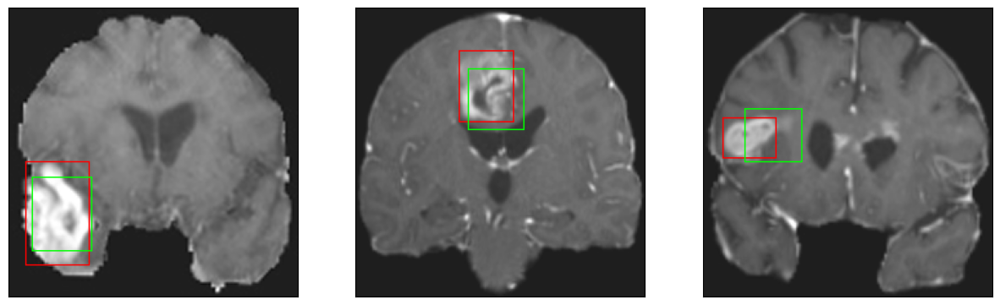

26/26 [==============================] - 3s 123ms/step - loss: 4.2733 - IoU: 0.6556 - val_loss: 9.5922 - val_IoU: 0.4742
Epoch 143/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3683 - IoU: 0.6504
Epoch 143: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


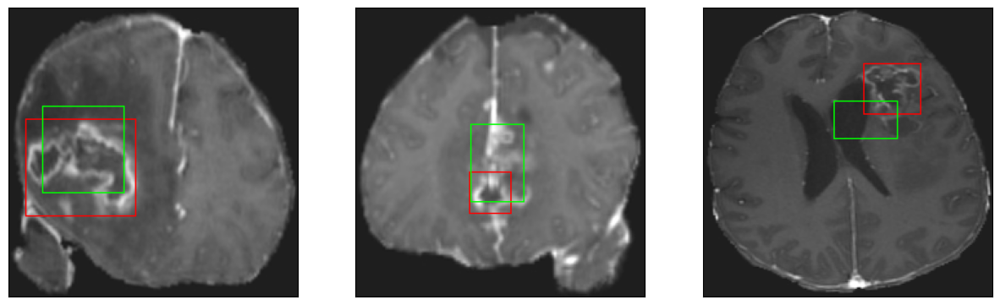

26/26 [==============================] - 3s 117ms/step - loss: 4.3864 - IoU: 0.6498 - val_loss: 8.9836 - val_IoU: 0.4942
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 4.6686 - IoU: 0.6314
Epoch 144: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


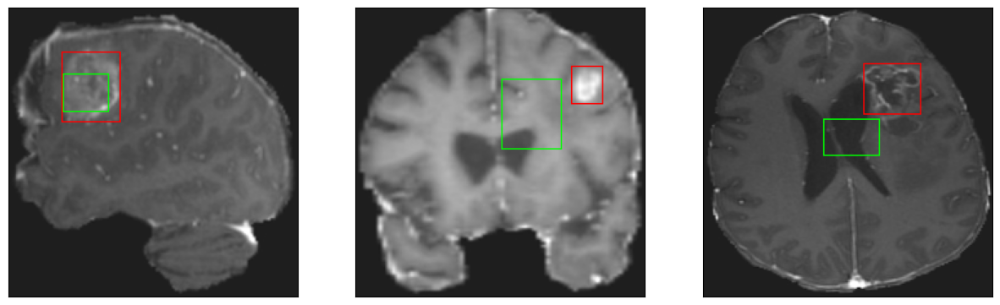

26/26 [==============================] - 2s 95ms/step - loss: 4.6686 - IoU: 0.6314 - val_loss: 9.4178 - val_IoU: 0.4783
Epoch 145/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6414 - IoU: 0.6332
Epoch 145: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


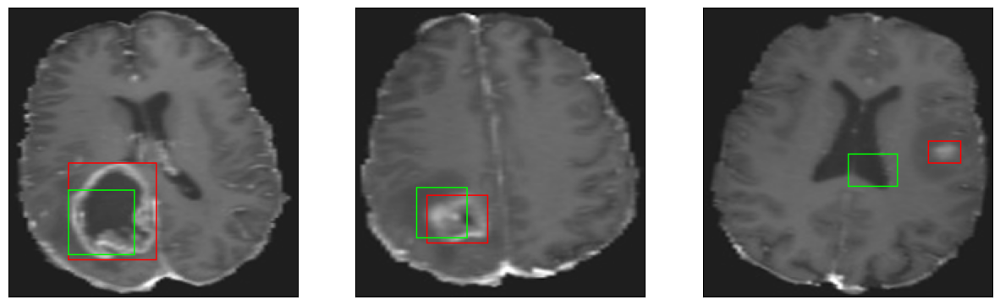

26/26 [==============================] - 3s 101ms/step - loss: 4.7208 - IoU: 0.6287 - val_loss: 10.5728 - val_IoU: 0.4368
Epoch 146/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5873 - IoU: 0.6403
Epoch 146: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


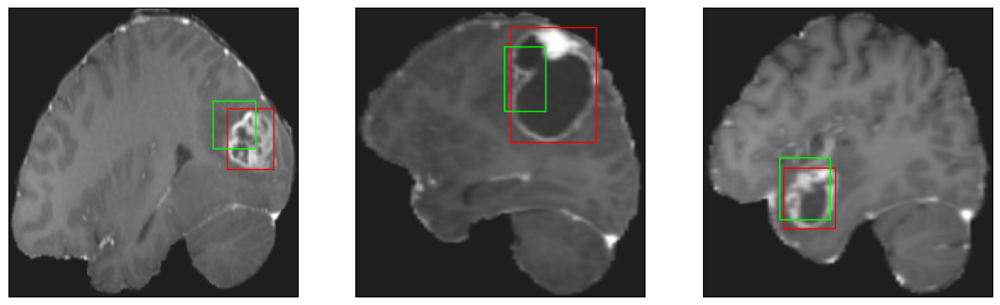

26/26 [==============================] - 3s 112ms/step - loss: 4.5719 - IoU: 0.6395 - val_loss: 8.7503 - val_IoU: 0.5068
Epoch 147/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3636 - IoU: 0.6454
Epoch 147: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


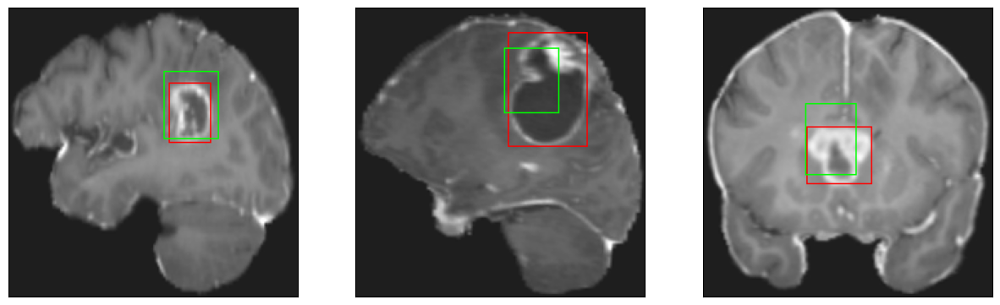

26/26 [==============================] - 2s 93ms/step - loss: 4.3767 - IoU: 0.6454 - val_loss: 8.7668 - val_IoU: 0.5155
Epoch 148/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4042 - IoU: 0.6464
Epoch 148: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


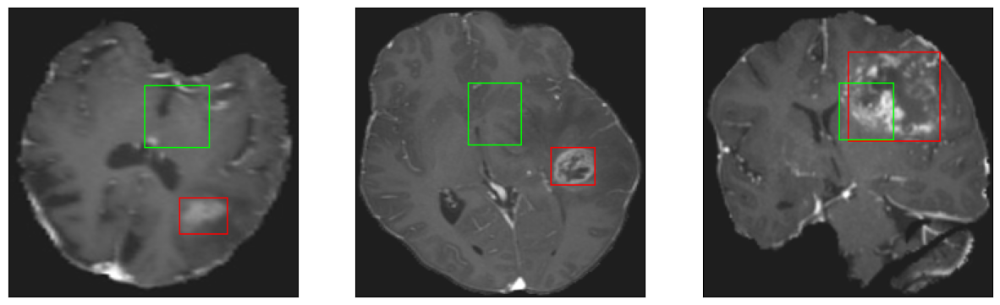

26/26 [==============================] - 3s 104ms/step - loss: 4.4297 - IoU: 0.6460 - val_loss: 20.6331 - val_IoU: 0.1543
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 4.3077 - IoU: 0.6556
Epoch 149: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4


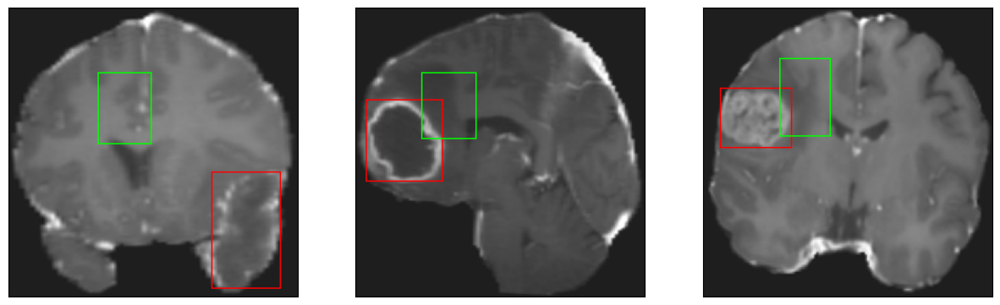

26/26 [==============================] - 3s 100ms/step - loss: 4.3077 - IoU: 0.6556 - val_loss: 23.3586 - val_IoU: 0.1282
Epoch 150/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4031 - IoU: 0.6470
Epoch 150: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 8ms/step
4


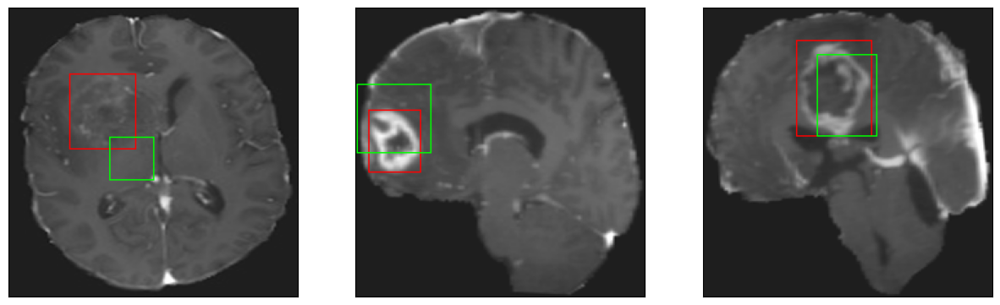

26/26 [==============================] - 3s 131ms/step - loss: 4.4220 - IoU: 0.6459 - val_loss: 8.5663 - val_IoU: 0.5137
Epoch 151/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4611 - IoU: 0.6412
Epoch 151: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


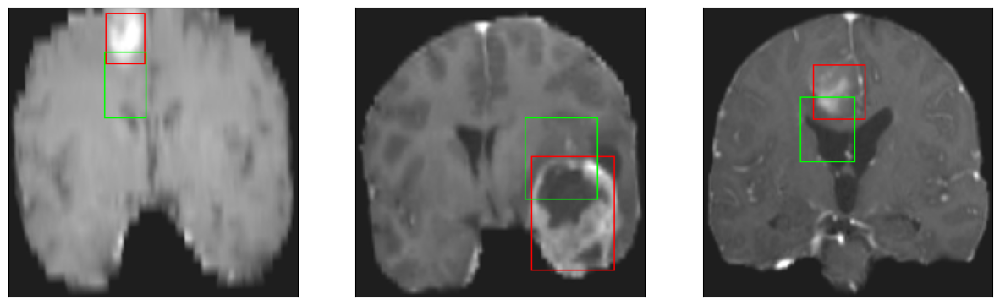

26/26 [==============================] - 3s 105ms/step - loss: 4.4527 - IoU: 0.6425 - val_loss: 10.8962 - val_IoU: 0.4239
Epoch 152/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3154 - IoU: 0.6469
Epoch 152: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


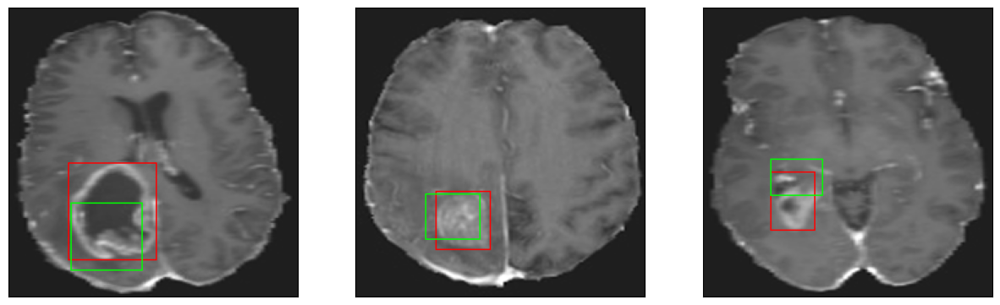

26/26 [==============================] - 3s 99ms/step - loss: 4.4173 - IoU: 0.6436 - val_loss: 9.1413 - val_IoU: 0.4917
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 4.3134 - IoU: 0.6532
Epoch 153: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 12ms/step
4


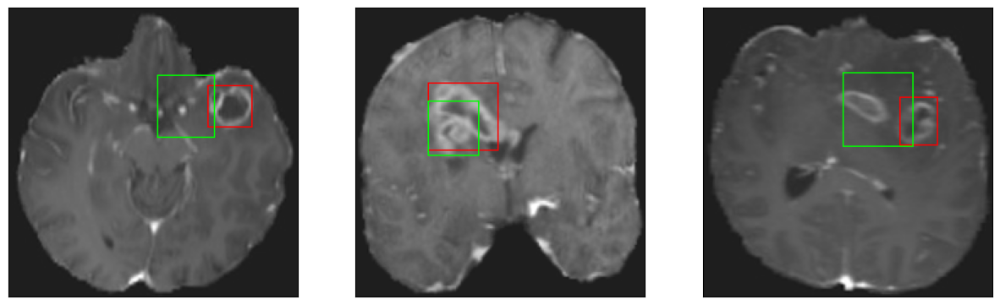

26/26 [==============================] - 3s 111ms/step - loss: 4.3134 - IoU: 0.6532 - val_loss: 8.3211 - val_IoU: 0.5285
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 4.2366 - IoU: 0.6567
Epoch 154: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


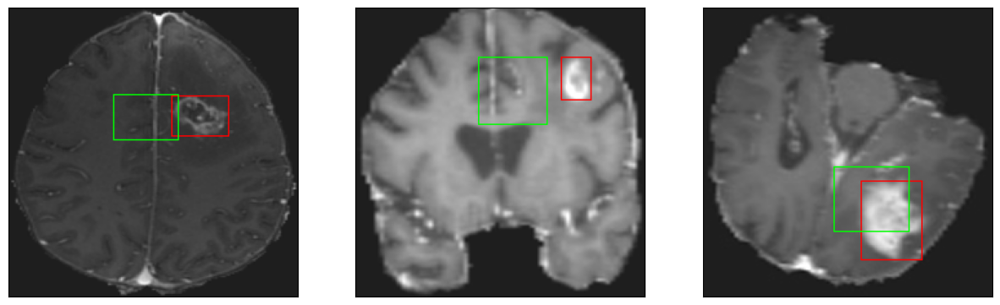

26/26 [==============================] - 3s 127ms/step - loss: 4.2366 - IoU: 0.6567 - val_loss: 11.4251 - val_IoU: 0.4045
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 4.5281 - IoU: 0.6494
Epoch 155: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


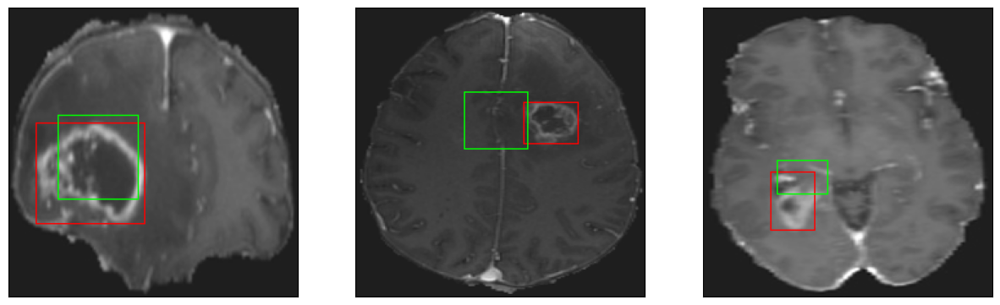

26/26 [==============================] - 3s 121ms/step - loss: 4.5281 - IoU: 0.6494 - val_loss: 9.3172 - val_IoU: 0.4728
Epoch 156/200
25/26 [===========================>..] - ETA: 0s - loss: 4.6452 - IoU: 0.6283
Epoch 156: val_IoU did not improve from 0.53306
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


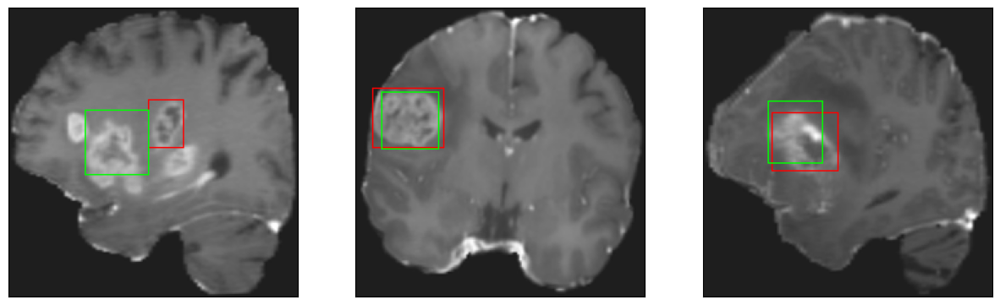

26/26 [==============================] - 3s 100ms/step - loss: 4.6339 - IoU: 0.6298 - val_loss: 9.2060 - val_IoU: 0.4901
Epoch 157/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4652 - IoU: 0.6417
Epoch 157: val_IoU improved from 0.53306 to 0.53711, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


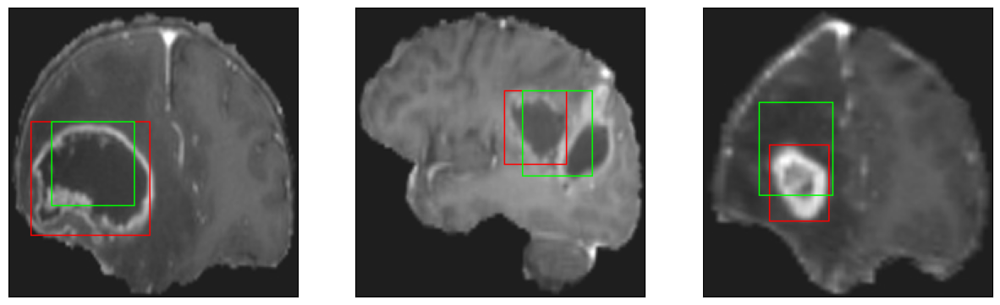

26/26 [==============================] - 4s 148ms/step - loss: 4.4256 - IoU: 0.6450 - val_loss: 8.3518 - val_IoU: 0.5371
Epoch 158/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5801 - IoU: 0.6317
Epoch 158: val_IoU did not improve from 0.53711
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


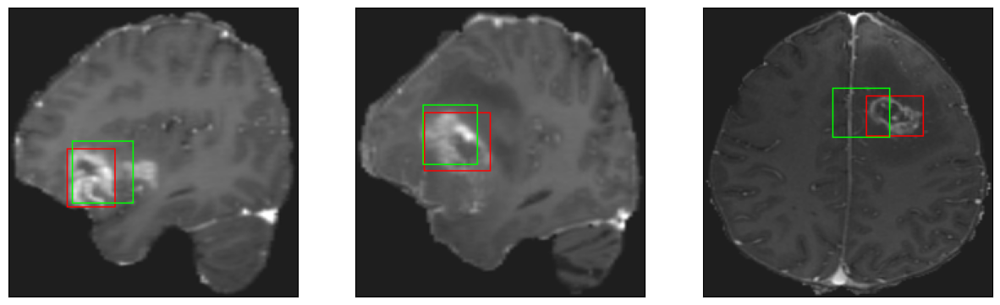

26/26 [==============================] - 3s 109ms/step - loss: 4.5798 - IoU: 0.6329 - val_loss: 9.9053 - val_IoU: 0.4595
Epoch 159/200
25/26 [===========================>..] - ETA: 0s - loss: 4.5382 - IoU: 0.6391
Epoch 159: val_IoU did not improve from 0.53711
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


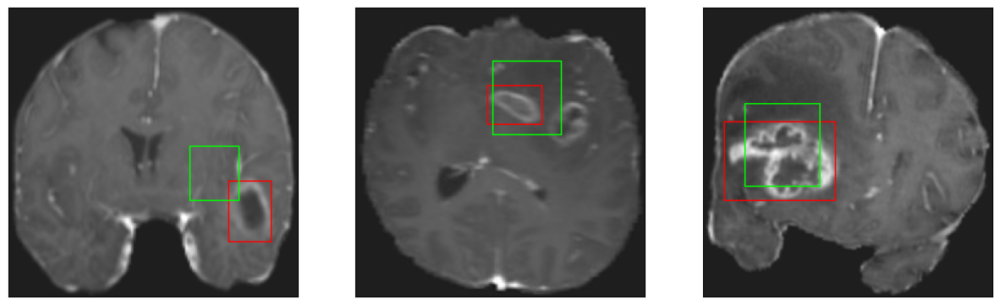

26/26 [==============================] - 2s 96ms/step - loss: 4.5113 - IoU: 0.6402 - val_loss: 9.1613 - val_IoU: 0.4912
Epoch 160/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2511 - IoU: 0.6552
Epoch 160: val_IoU did not improve from 0.53711
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4


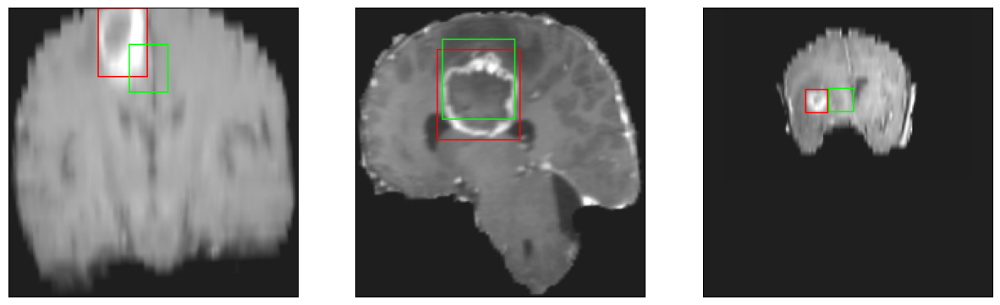

26/26 [==============================] - 3s 108ms/step - loss: 4.2478 - IoU: 0.6569 - val_loss: 8.8219 - val_IoU: 0.5192
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 4.1559 - IoU: 0.6654
Epoch 161: val_IoU did not improve from 0.53711
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


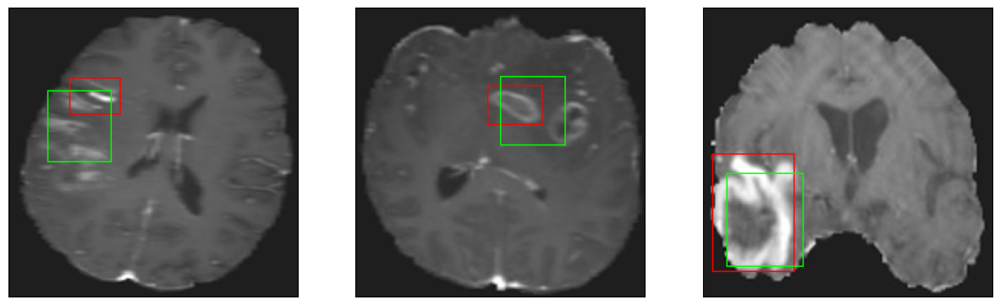

26/26 [==============================] - 3s 122ms/step - loss: 4.1559 - IoU: 0.6654 - val_loss: 8.4392 - val_IoU: 0.5360
Epoch 162/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2299 - IoU: 0.6578
Epoch 162: val_IoU improved from 0.53711 to 0.53864, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


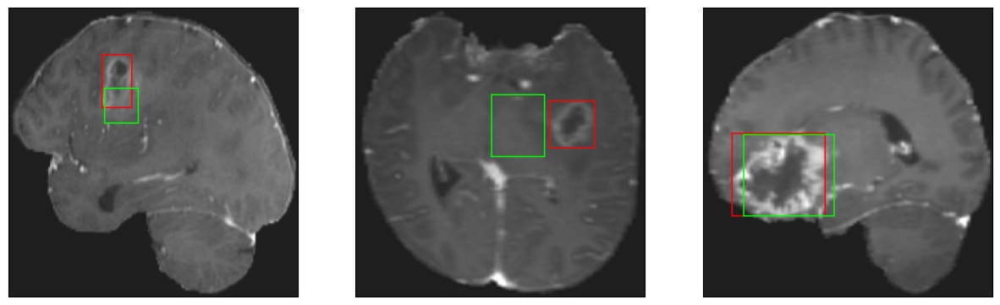

26/26 [==============================] - 3s 130ms/step - loss: 4.2345 - IoU: 0.6581 - val_loss: 8.4018 - val_IoU: 0.5386
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 4.3340 - IoU: 0.6536
Epoch 163: val_IoU did not improve from 0.53864
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


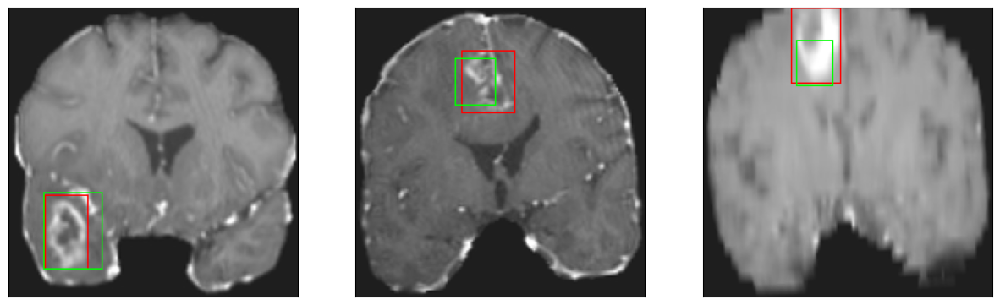

26/26 [==============================] - 3s 107ms/step - loss: 4.3340 - IoU: 0.6536 - val_loss: 9.3821 - val_IoU: 0.4700
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 4.2290 - IoU: 0.6574
Epoch 164: val_IoU did not improve from 0.53864
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4


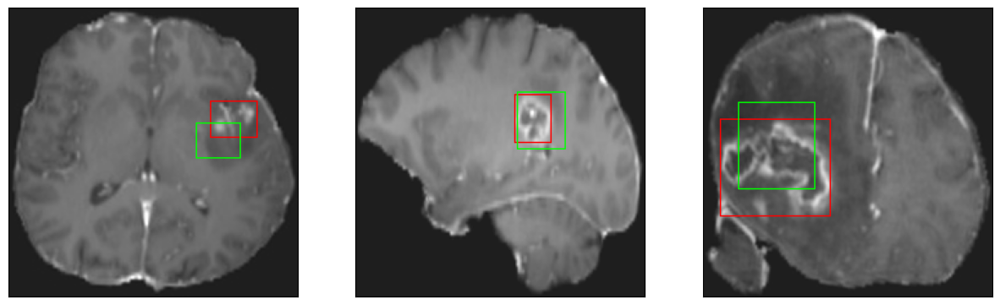

26/26 [==============================] - 3s 106ms/step - loss: 4.2290 - IoU: 0.6574 - val_loss: 9.2702 - val_IoU: 0.5079
Epoch 165/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2337 - IoU: 0.6601
Epoch 165: val_IoU improved from 0.53864 to 0.54150, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


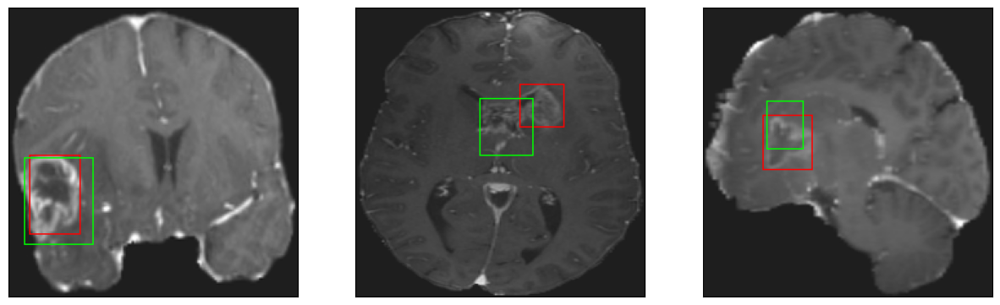

26/26 [==============================] - 3s 132ms/step - loss: 4.2142 - IoU: 0.6607 - val_loss: 8.2258 - val_IoU: 0.5415
Epoch 166/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2373 - IoU: 0.6571
Epoch 166: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


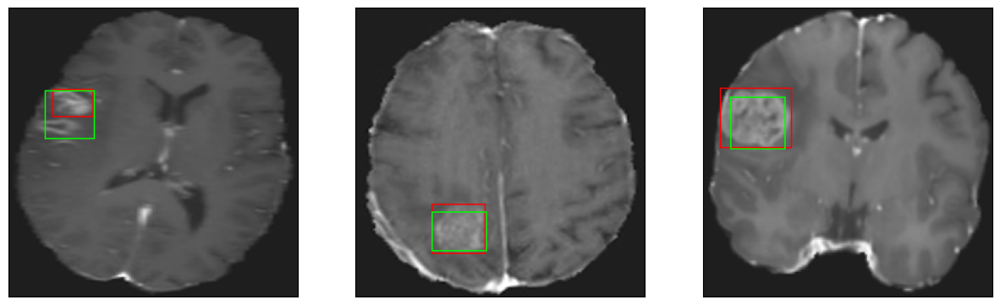

26/26 [==============================] - 3s 108ms/step - loss: 4.2492 - IoU: 0.6568 - val_loss: 8.5983 - val_IoU: 0.4931
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 4.2807 - IoU: 0.6602
Epoch 167: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4


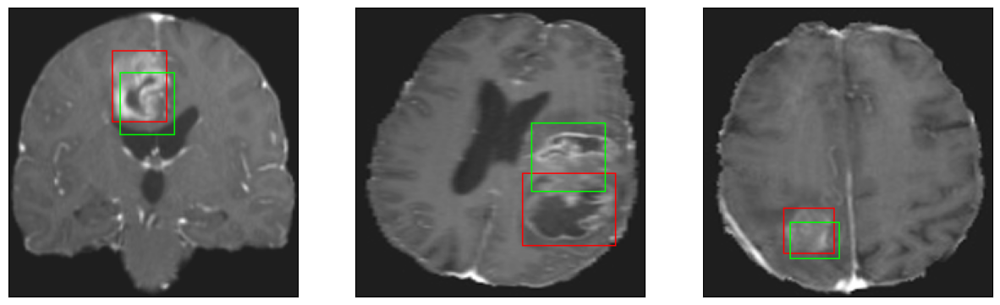

26/26 [==============================] - 2s 90ms/step - loss: 4.2807 - IoU: 0.6602 - val_loss: 8.4022 - val_IoU: 0.5208
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 4.2500 - IoU: 0.6596
Epoch 168: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


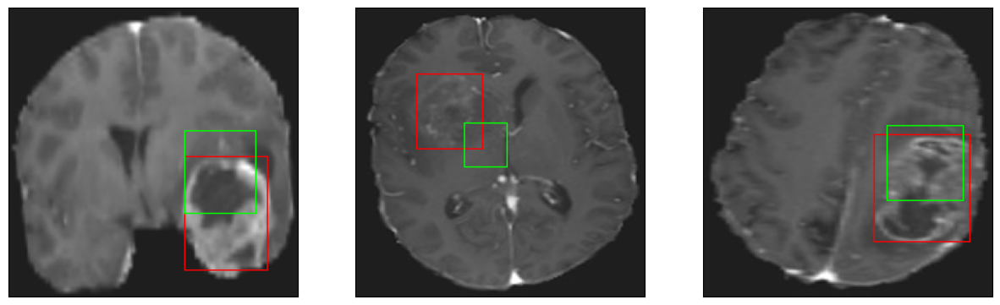

26/26 [==============================] - 3s 97ms/step - loss: 4.2500 - IoU: 0.6596 - val_loss: 10.4850 - val_IoU: 0.4411
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 4.5424 - IoU: 0.6293
Epoch 169: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 10ms/step
4


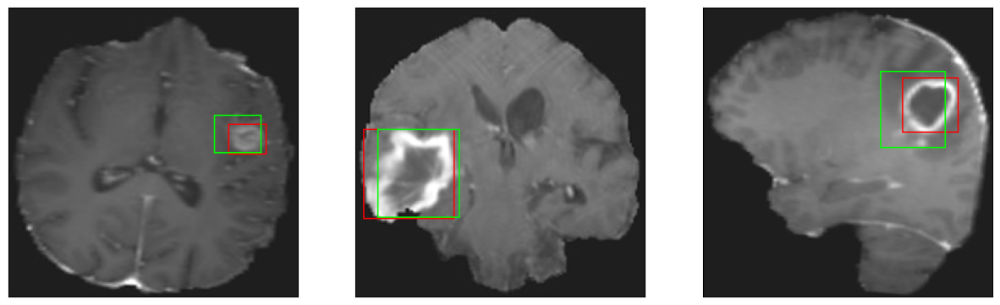

26/26 [==============================] - 3s 127ms/step - loss: 4.5424 - IoU: 0.6293 - val_loss: 10.0321 - val_IoU: 0.4691
Epoch 170/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4095 - IoU: 0.6440
Epoch 170: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


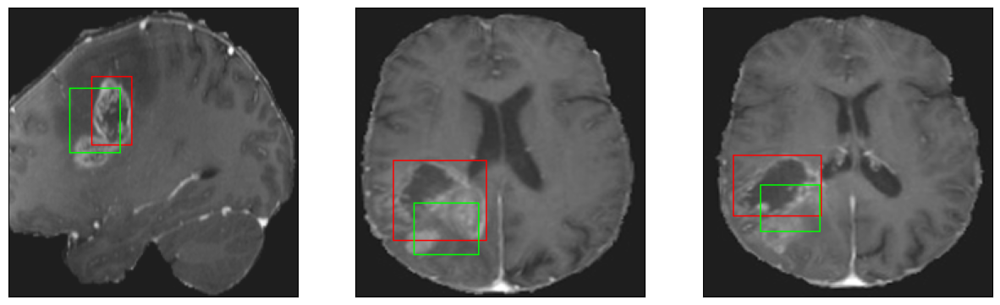

26/26 [==============================] - 3s 106ms/step - loss: 4.4163 - IoU: 0.6435 - val_loss: 8.7478 - val_IoU: 0.5106
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 4.2957 - IoU: 0.6495
Epoch 171: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


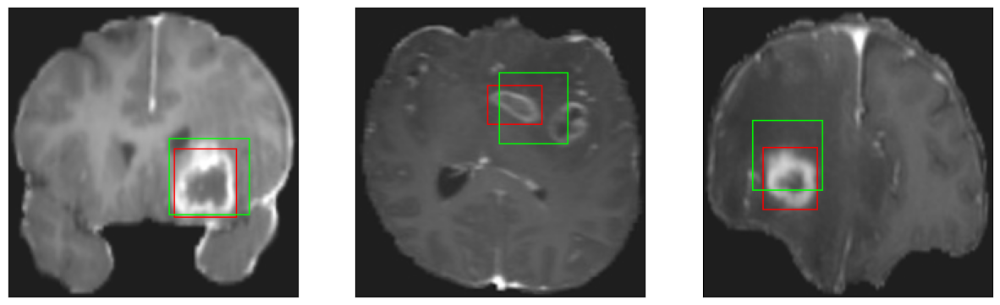

26/26 [==============================] - 3s 101ms/step - loss: 4.2957 - IoU: 0.6495 - val_loss: 8.4537 - val_IoU: 0.5223
Epoch 172/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2329 - IoU: 0.6627
Epoch 172: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


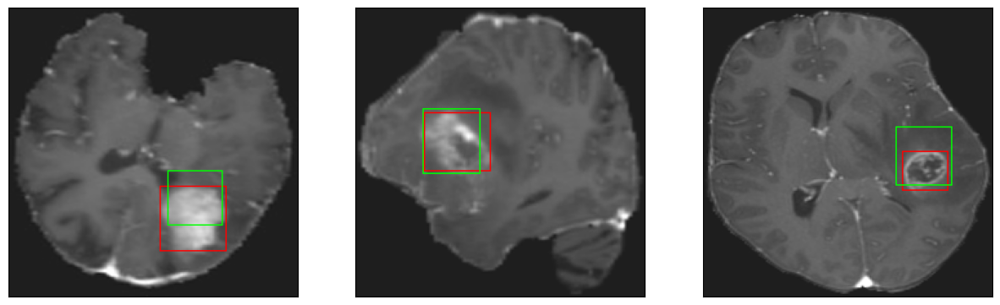

26/26 [==============================] - 3s 106ms/step - loss: 4.2047 - IoU: 0.6650 - val_loss: 9.0584 - val_IoU: 0.5107
Epoch 173/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4518 - IoU: 0.6423
Epoch 173: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


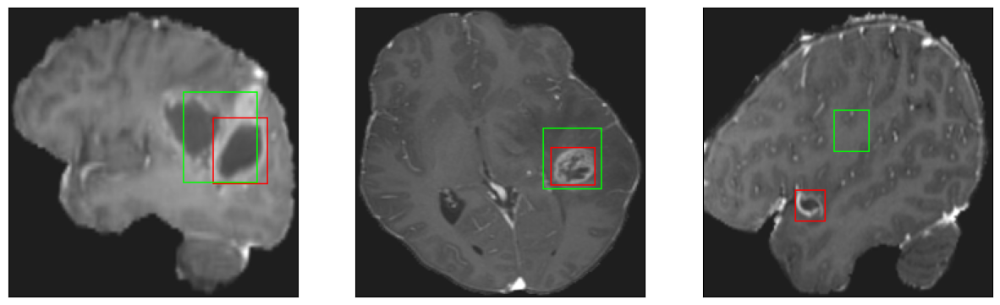

26/26 [==============================] - 3s 120ms/step - loss: 4.4437 - IoU: 0.6437 - val_loss: 8.7312 - val_IoU: 0.5204
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 4.2825 - IoU: 0.6603
Epoch 174: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


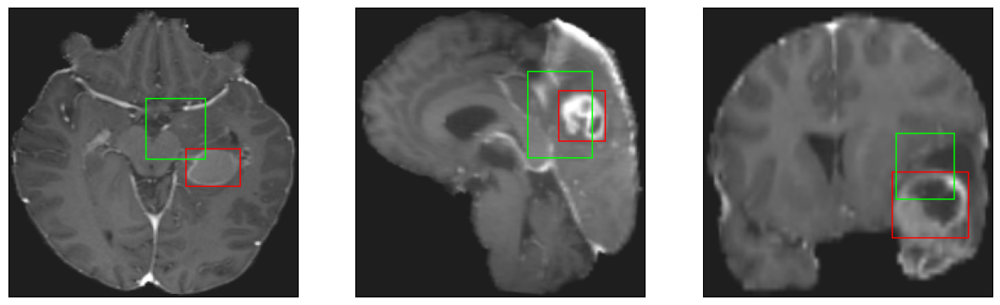

26/26 [==============================] - 2s 94ms/step - loss: 4.2825 - IoU: 0.6603 - val_loss: 8.4262 - val_IoU: 0.5269
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 4.3823 - IoU: 0.6554
Epoch 175: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 9ms/step
4


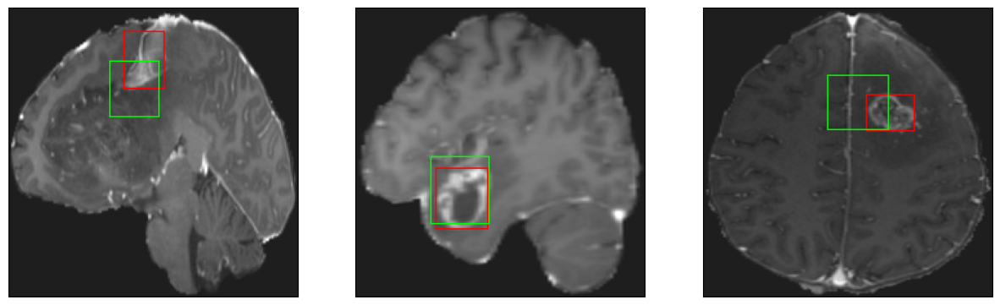

26/26 [==============================] - 2s 91ms/step - loss: 4.3823 - IoU: 0.6554 - val_loss: 9.8464 - val_IoU: 0.4755
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 4.0568 - IoU: 0.6731
Epoch 176: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


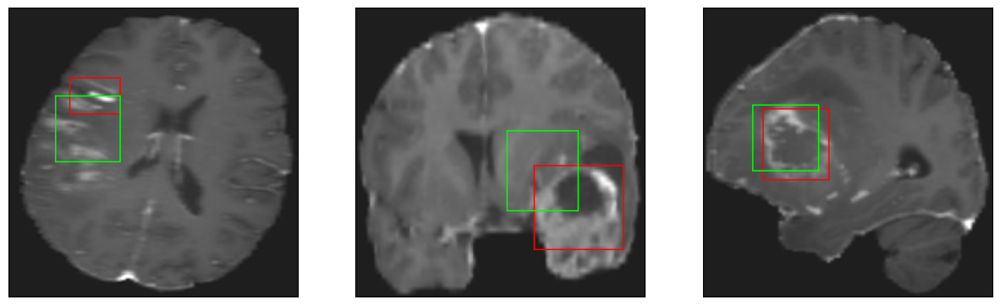

26/26 [==============================] - 3s 119ms/step - loss: 4.0568 - IoU: 0.6731 - val_loss: 14.6989 - val_IoU: 0.3110
Epoch 177/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3363 - IoU: 0.6523
Epoch 177: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


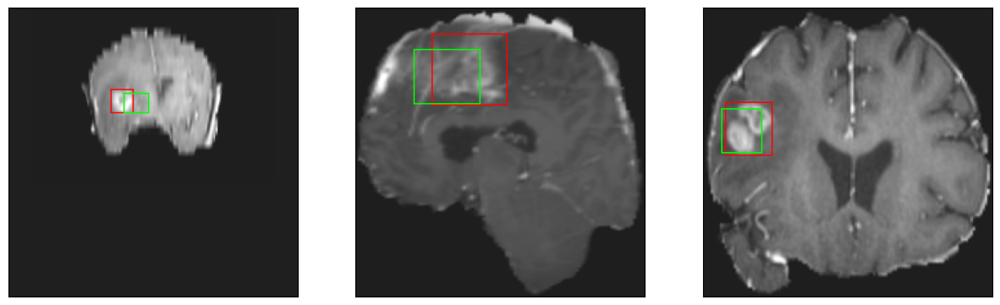

26/26 [==============================] - 3s 119ms/step - loss: 4.3864 - IoU: 0.6504 - val_loss: 8.2813 - val_IoU: 0.5265
Epoch 178/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3339 - IoU: 0.6481
Epoch 178: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4


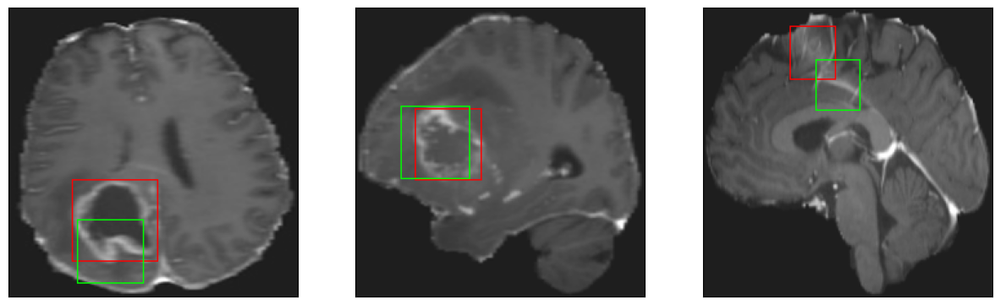

26/26 [==============================] - 3s 100ms/step - loss: 4.3406 - IoU: 0.6491 - val_loss: 8.2064 - val_IoU: 0.5383
Epoch 179/200
25/26 [===========================>..] - ETA: 0s - loss: 4.3143 - IoU: 0.6575
Epoch 179: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 10ms/step
4


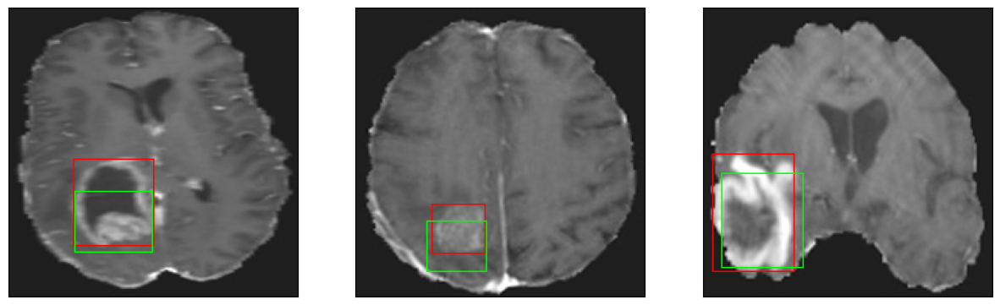

26/26 [==============================] - 3s 105ms/step - loss: 4.2767 - IoU: 0.6586 - val_loss: 8.9687 - val_IoU: 0.5225
Epoch 180/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1330 - IoU: 0.6656
Epoch 180: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


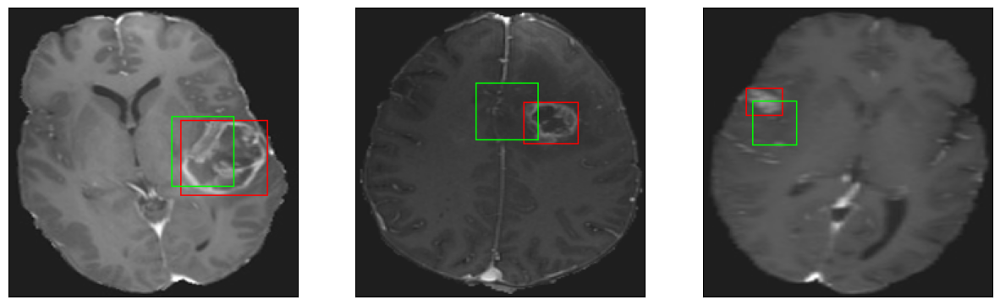

26/26 [==============================] - 3s 113ms/step - loss: 4.1060 - IoU: 0.6676 - val_loss: 10.5643 - val_IoU: 0.4485
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 4.2346 - IoU: 0.6612
Epoch 181: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


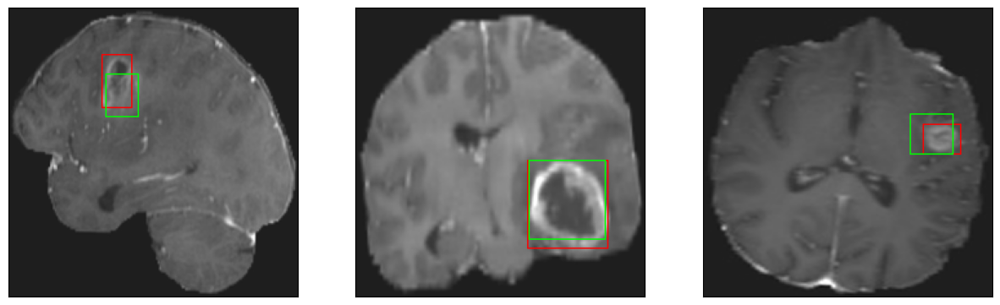

26/26 [==============================] - 3s 101ms/step - loss: 4.2346 - IoU: 0.6612 - val_loss: 8.7969 - val_IoU: 0.5095
Epoch 182/200
25/26 [===========================>..] - ETA: 0s - loss: 4.4686 - IoU: 0.6470
Epoch 182: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4


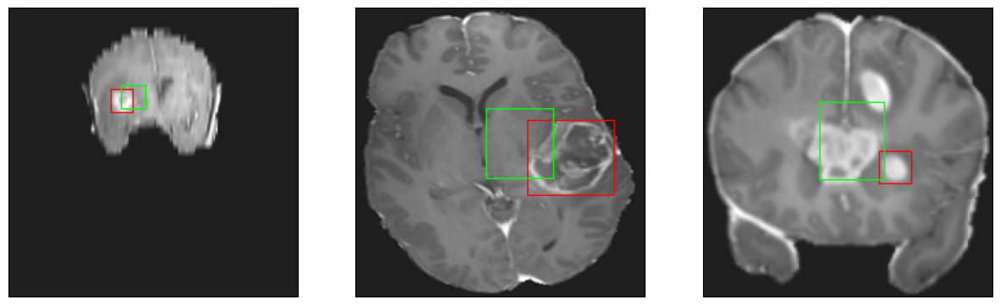

26/26 [==============================] - 3s 99ms/step - loss: 4.4736 - IoU: 0.6462 - val_loss: 13.9552 - val_IoU: 0.3459
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 4.2888 - IoU: 0.6549
Epoch 183: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4


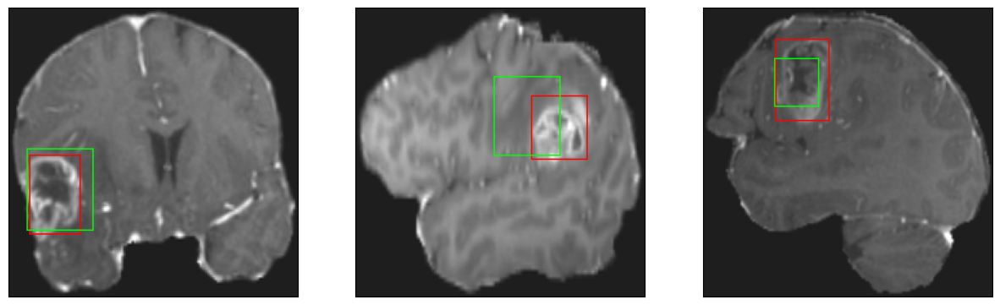

26/26 [==============================] - 3s 121ms/step - loss: 4.2888 - IoU: 0.6549 - val_loss: 9.3158 - val_IoU: 0.4987
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 4.3439 - IoU: 0.6554
Epoch 184: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


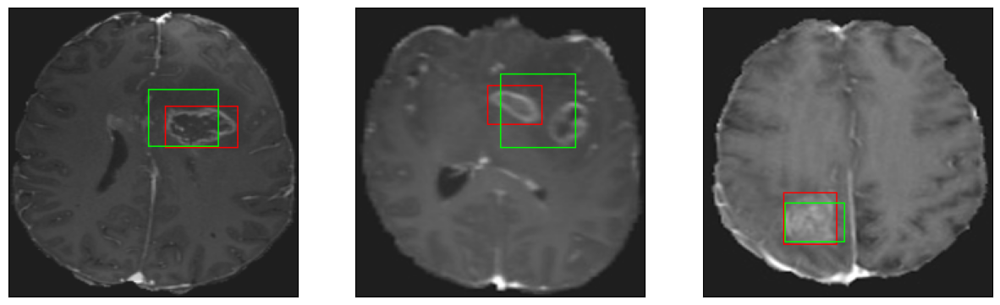

26/26 [==============================] - 3s 103ms/step - loss: 4.3439 - IoU: 0.6554 - val_loss: 8.6524 - val_IoU: 0.5257
Epoch 185/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1730 - IoU: 0.6638
Epoch 185: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


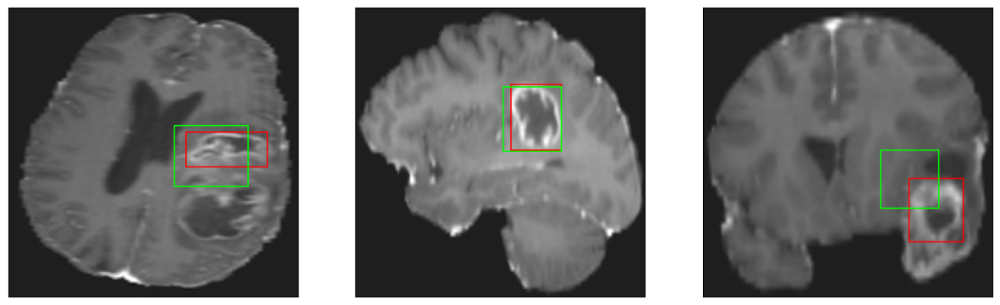

26/26 [==============================] - 3s 105ms/step - loss: 4.1894 - IoU: 0.6624 - val_loss: 8.5910 - val_IoU: 0.5066
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 4.1084 - IoU: 0.6680
Epoch 186: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 6ms/step
4


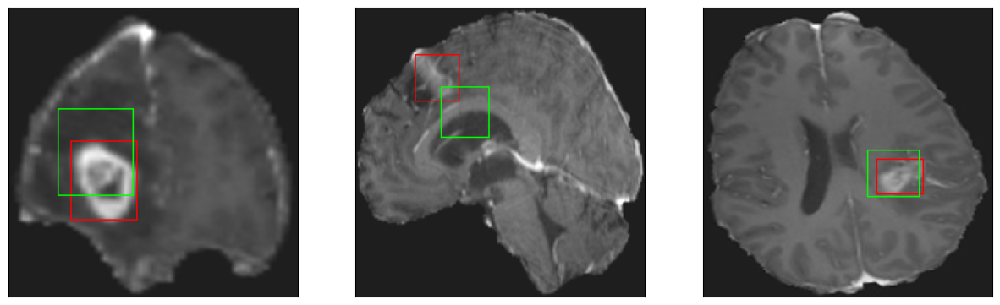

26/26 [==============================] - 3s 102ms/step - loss: 4.1084 - IoU: 0.6680 - val_loss: 8.6737 - val_IoU: 0.5203
Epoch 187/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1425 - IoU: 0.6651
Epoch 187: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


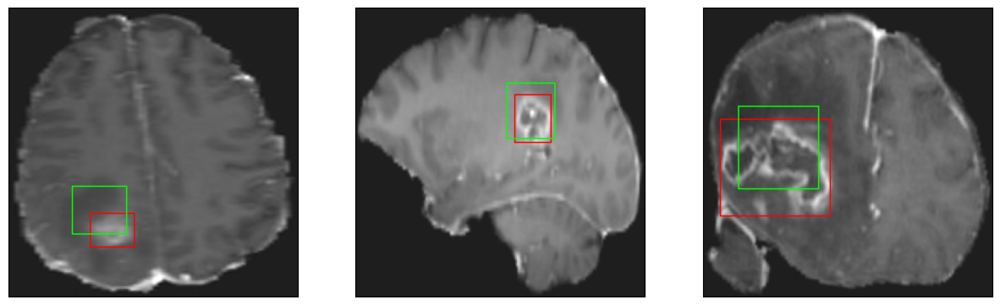

26/26 [==============================] - 3s 108ms/step - loss: 4.1694 - IoU: 0.6628 - val_loss: 10.0882 - val_IoU: 0.4535
Epoch 188/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0752 - IoU: 0.6717
Epoch 188: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 7ms/step
4


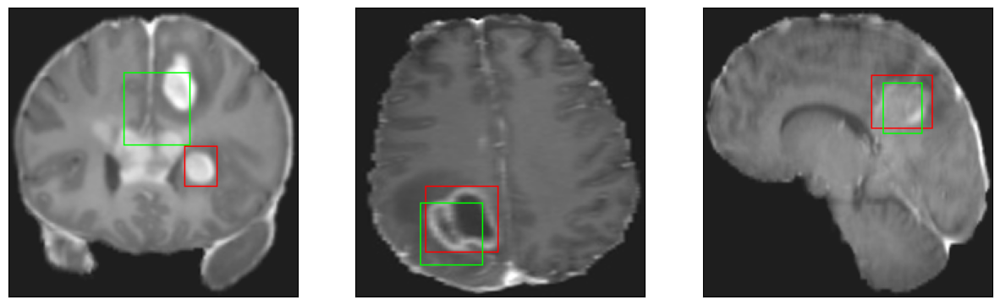

26/26 [==============================] - 2s 95ms/step - loss: 4.0565 - IoU: 0.6737 - val_loss: 8.6845 - val_IoU: 0.5158
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 4.0811 - IoU: 0.6711
Epoch 189: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


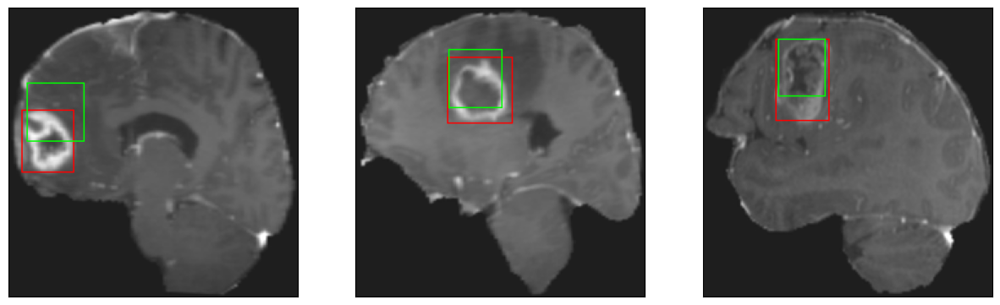

26/26 [==============================] - 2s 94ms/step - loss: 4.0811 - IoU: 0.6711 - val_loss: 14.4015 - val_IoU: 0.2837
Epoch 190/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2400 - IoU: 0.6565
Epoch 190: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


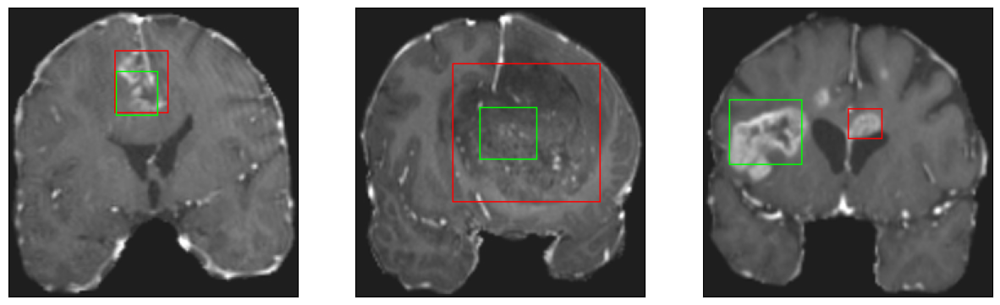

26/26 [==============================] - 3s 101ms/step - loss: 4.2362 - IoU: 0.6553 - val_loss: 8.9249 - val_IoU: 0.4918
Epoch 191/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1735 - IoU: 0.6644
Epoch 191: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4


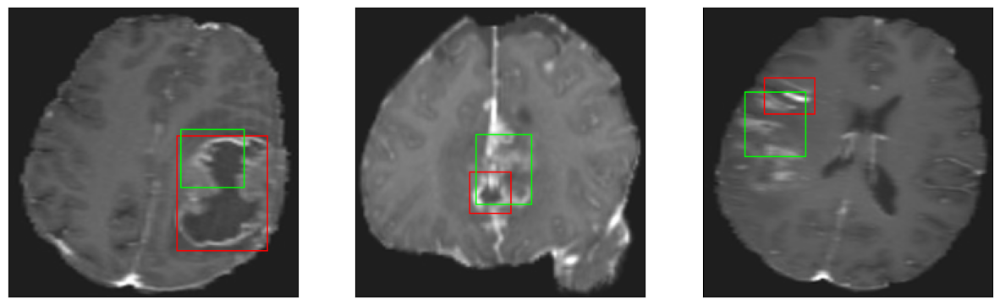

26/26 [==============================] - 3s 125ms/step - loss: 4.1759 - IoU: 0.6632 - val_loss: 9.8952 - val_IoU: 0.4671
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 4.0889 - IoU: 0.6703
Epoch 192: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4


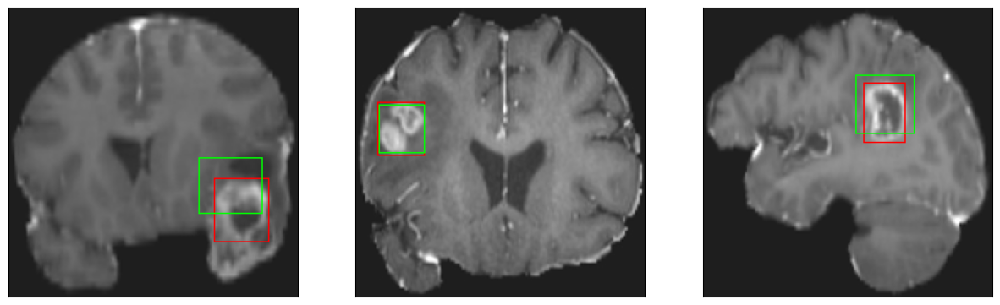

26/26 [==============================] - 3s 109ms/step - loss: 4.0889 - IoU: 0.6703 - val_loss: 9.1685 - val_IoU: 0.5031
Epoch 193/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0074 - IoU: 0.6744
Epoch 193: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4


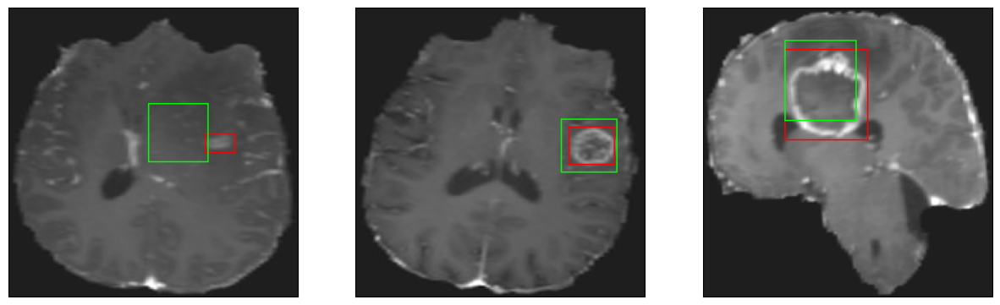

26/26 [==============================] - 3s 101ms/step - loss: 4.0471 - IoU: 0.6740 - val_loss: 8.5557 - val_IoU: 0.5412
Epoch 194/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0433 - IoU: 0.6693
Epoch 194: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


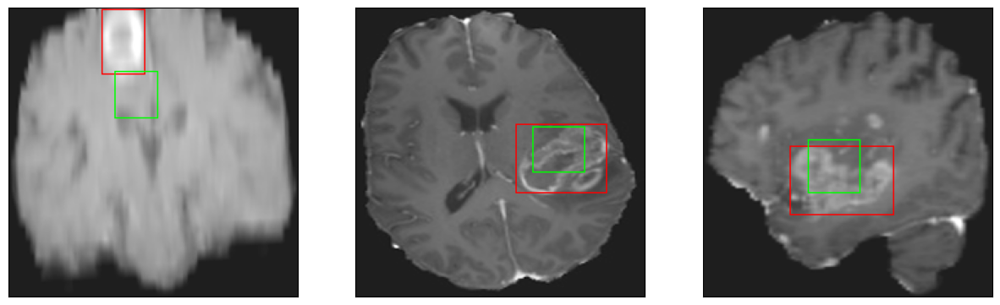

26/26 [==============================] - 3s 120ms/step - loss: 4.0899 - IoU: 0.6669 - val_loss: 9.0065 - val_IoU: 0.4811
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 4.3921 - IoU: 0.6490
Epoch 195: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 8ms/step
4


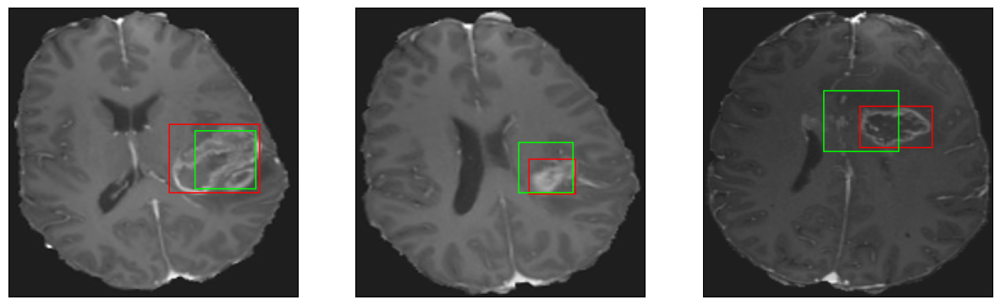

26/26 [==============================] - 3s 106ms/step - loss: 4.3921 - IoU: 0.6490 - val_loss: 8.8379 - val_IoU: 0.5292
Epoch 196/200
25/26 [===========================>..] - ETA: 0s - loss: 4.2242 - IoU: 0.6649
Epoch 196: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4


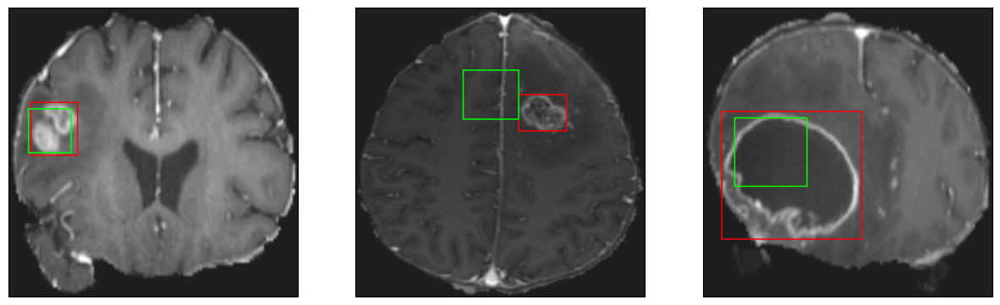

26/26 [==============================] - 3s 98ms/step - loss: 4.2273 - IoU: 0.6641 - val_loss: 11.1578 - val_IoU: 0.3890
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 4.3737 - IoU: 0.6462
Epoch 197: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


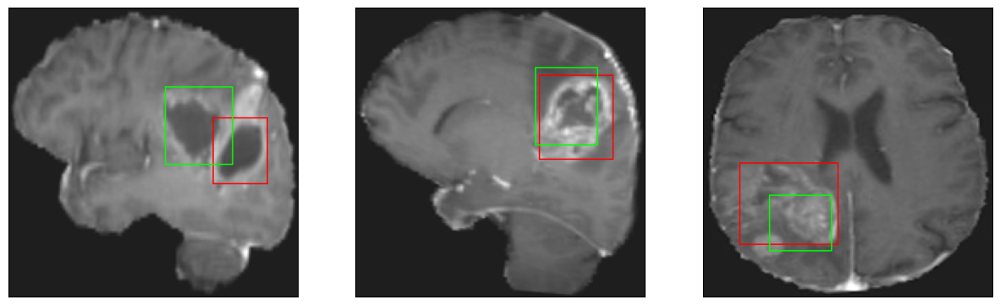

26/26 [==============================] - 2s 93ms/step - loss: 4.3737 - IoU: 0.6462 - val_loss: 8.7190 - val_IoU: 0.5171
Epoch 198/200
25/26 [===========================>..] - ETA: 0s - loss: 4.1035 - IoU: 0.6583
Epoch 198: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 6ms/step
4
8/8 [==============================] - 0s 8ms/step
4


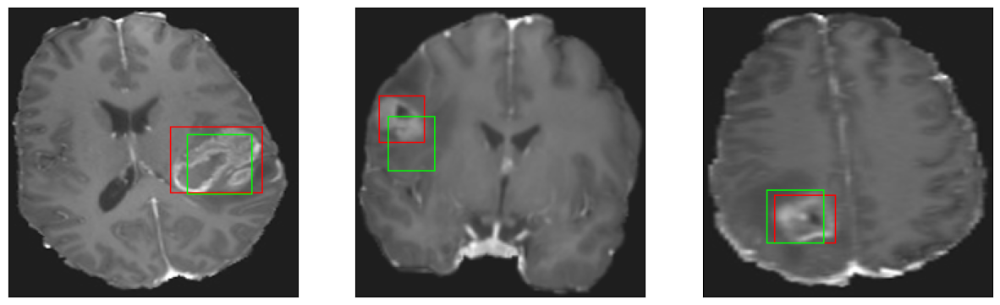

26/26 [==============================] - 3s 99ms/step - loss: 4.1134 - IoU: 0.6570 - val_loss: 8.6496 - val_IoU: 0.5271
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 4.1448 - IoU: 0.6601
Epoch 199: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 9ms/step
4
8/8 [==============================] - 0s 9ms/step
4


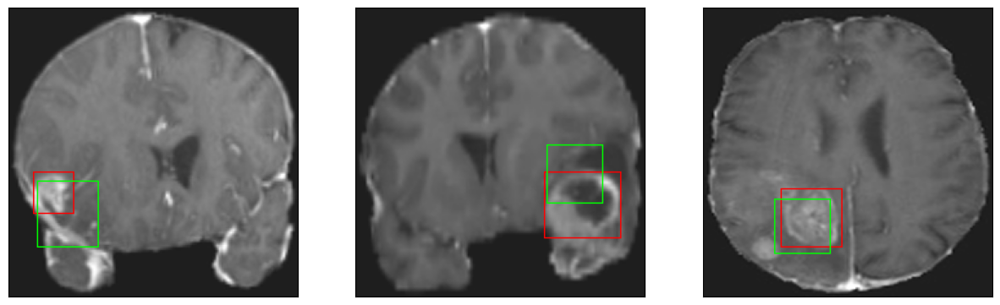

26/26 [==============================] - 4s 144ms/step - loss: 4.1448 - IoU: 0.6601 - val_loss: 8.2876 - val_IoU: 0.5260
Epoch 200/200
25/26 [===========================>..] - ETA: 0s - loss: 4.0128 - IoU: 0.6688
Epoch 200: val_IoU did not improve from 0.54150
8/8 [==============================] - 0s 7ms/step
4
8/8 [==============================] - 0s 8ms/step
4
8/8 [==============================] - 0s 10ms/step
4


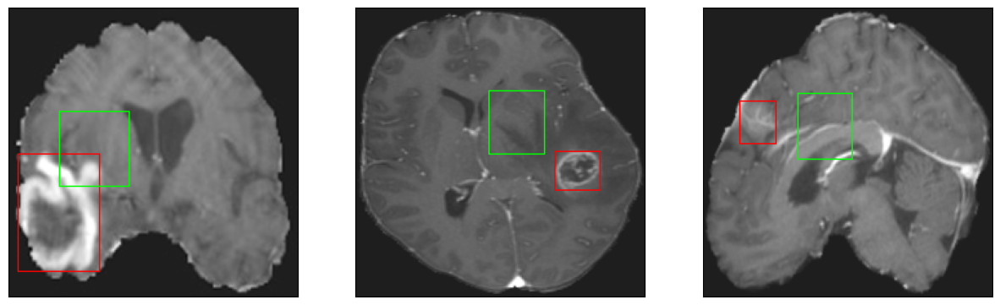

26/26 [==============================] - 2s 95ms/step - loss: 4.0867 - IoU: 0.6657 - val_loss: 19.7192 - val_IoU: 0.1616


In [24]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

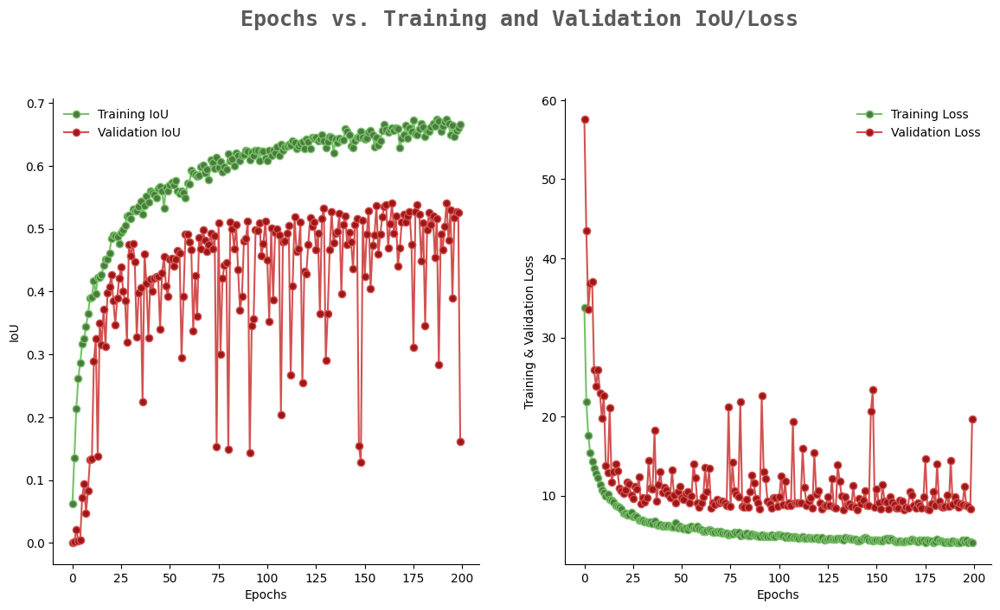

In [25]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation IoU/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [26]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [27]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [28]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 28ms/step - loss: 11.6485 - IoU: 0.4023


[11.648473739624023, 0.4022701382637024]